# EDA - Bowling Dataset

In [134]:
 import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import datetime as dt

import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree
from sklearn.neighbors import NearestNeighbors
from random import sample
from numpy.random import uniform
from math import isnan

# Data Inspection

In [135]:
odi_data = pd.read_csv(r"Bowling_ODI.csv",encoding='latin1')
odi_data_dup = odi_data.copy()
odi_data_dup.head()

,Unnamed: 0,Player,Span,Mat,Inns,Balls,Runs,Wkts,BBI,Ave,Econ,SR,4,5,Unnamed: 13
0,0,M Muralitharan (Asia/ICC/SL),1993-2011,350,341,18811,12326,534,7/30,23.08,3.93,35.2,15,10,NaN
1,1,Wasim Akram (PAK),1984-2003,356,351,18186,11812,502,5/15,23.52,3.89,36.2,17,6,NaN
2,2,Waqar Younis (PAK),1989-2003,262,258,12698,9919,416,7/36,23.84,4.68,30.5,14,13,NaN
3,3,WPUJC Vaas (Asia/SL),1994-2008,322,320,15775,11014,400,8/19,27.53,4.18,39.4,9,4,NaN
4,4,Shahid Afridi (Asia/ICC/PAK),1996-2015,398,372,17670,13632,395,7/12,34.51,4.62,44.7,4,9,NaN


In [136]:
t20_data = pd.read_csv(r"Bowling_t20.csv",encoding='latin1')
t20_data_dup = t20_data.copy()
t20_data_dup.head()

,Unnamed: 0,Player,Span,Mat,Inns,Overs,Mdns,Runs,Wkts,BBI,Ave,Econ,SR,4,5,Unnamed: 14
0,0,SL Malinga (SL),2006-2019,79,79,284.5,1,2061,106,5/6,19.44,7.23,16.1,1,2,NaN
1,1,Shahid Afridi (ICC/PAK),2006-2018,99,97,361.2,4,2396,98,4/11,24.44,6.63,22.1,3,0,NaN
2,2,Shakib Al Hasan (BDESH),2006-2019,76,75,277.5,2,1894,92,5/20,20.58,6.81,18.1,3,1,NaN
3,3,Saeed Ajmal (PAK),2009-2015,64,63,238.2,2,1516,85,4/19,17.83,6.36,16.8,4,0,NaN
4,4,Umar Gul (PAK),2007-2016,60,60,200.3,2,1443,85,5/6,16.97,7.19,14.1,4,2,NaN


In [137]:
test_data = pd.read_csv(r"Bowling_test.csv",encoding='latin1')
test_data_dup = test_data.copy()
test_data_dup.head()

,Unnamed: 0,Player,Span,Mat,Inns,Balls,Runs,Wkts,BBI,BBM,Ave,Econ,SR,5,10,Unnamed: 14
0,0,M Muralitharan (ICC/SL),1992-2010,133,230,44039,18180,800,9/51,16/220,22.72,2.47,55.0,67,22,NaN
1,1,SK Warne (AUS),1992-2007,145,273,40705,17995,708,8/71,12/128,25.41,2.65,57.4,37,10,NaN
2,2,A Kumble (INDIA),1990-2008,132,236,40850,18355,619,10/74,14/149,29.65,2.69,65.9,35,8,NaN
3,3,JM Anderson (ENG),2003-2019,150,280,32557,15607,577,7/42,11/71,27.04,2.87,56.4,27,3,NaN
4,4,GD McGrath (AUS),1993-2007,124,243,29248,12186,563,8/24,10/27,21.64,2.49,51.9,29,3,NaN


### Duplicate Check

In [138]:
print(f'ODI Data Shape: {odi_data_dup.shape}')
print(f'T20 Data Shape: {t20_data_dup.shape}')
print(f'Test Data Shape: {test_data_dup.shape}')

ODI Data Shape: (2582, 15)
T20 Data Shape: (2006, 16)
Test Data Shape: (3050, 16)


In [139]:
odi_data_dup.drop_duplicates(subset=None, inplace=True)
t20_data_dup.drop_duplicates(subset=None, inplace=True)
test_data_dup.drop_duplicates(subset=None, inplace=True)

In [140]:
print(f'ODI Data Shape After Removing Duplicates: {odi_data_dup.shape}')
print(f'T20 Data Shape After Removing Duplicates: {t20_data_dup.shape}')
print(f'Test Data Shape After Removing Duplicates: {test_data_dup.shape}')

ODI Data Shape After Removing Duplicates: (2582, 15)
T20 Data Shape After Removing Duplicates: (2006, 16)
Test Data Shape After Removing Duplicates: (50, 16)


## Dropping Unnecessary Columns

In [141]:
odi_data_dup = odi_data_dup.drop(['Unnamed: 13'], axis=1)
odi_data_dup= odi_data_dup.drop(['Unnamed: 0'], axis=1)

t20_data_dup = t20_data_dup.drop(['Unnamed: 14'], axis=1)
t20_data_dup= t20_data_dup.drop(['Unnamed: 0'], axis=1)

test_data_dup = test_data_dup.drop(['Unnamed: 14'], axis=1)
test_data_dup= test_data_dup.drop(['Unnamed: 0'], axis=1)

In [142]:
odi_data_dup.head()

,Player,Span,Mat,Inns,Balls,Runs,Wkts,BBI,Ave,Econ,SR,4,5
0,M Muralitharan (Asia/ICC/SL),1993-2011,350,341,18811,12326,534,7/30,23.08,3.93,35.2,15,10
1,Wasim Akram (PAK),1984-2003,356,351,18186,11812,502,5/15,23.52,3.89,36.2,17,6
2,Waqar Younis (PAK),1989-2003,262,258,12698,9919,416,7/36,23.84,4.68,30.5,14,13
3,WPUJC Vaas (Asia/SL),1994-2008,322,320,15775,11014,400,8/19,27.53,4.18,39.4,9,4
4,Shahid Afridi (Asia/ICC/PAK),1996-2015,398,372,17670,13632,395,7/12,34.51,4.62,44.7,4,9


In [143]:
t20_data_dup.head()

,Player,Span,Mat,Inns,Overs,Mdns,Runs,Wkts,BBI,Ave,Econ,SR,4,5
0,SL Malinga (SL),2006-2019,79,79,284.5,1,2061,106,5/6,19.44,7.23,16.1,1,2
1,Shahid Afridi (ICC/PAK),2006-2018,99,97,361.2,4,2396,98,4/11,24.44,6.63,22.1,3,0
2,Shakib Al Hasan (BDESH),2006-2019,76,75,277.5,2,1894,92,5/20,20.58,6.81,18.1,3,1
3,Saeed Ajmal (PAK),2009-2015,64,63,238.2,2,1516,85,4/19,17.83,6.36,16.8,4,0
4,Umar Gul (PAK),2007-2016,60,60,200.3,2,1443,85,5/6,16.97,7.19,14.1,4,2


In [144]:
test_data_dup.head()

,Player,Span,Mat,Inns,Balls,Runs,Wkts,BBI,BBM,Ave,Econ,SR,5,10
0,M Muralitharan (ICC/SL),1992-2010,133,230,44039,18180,800,9/51,16/220,22.72,2.47,55.0,67,22
1,SK Warne (AUS),1992-2007,145,273,40705,17995,708,8/71,12/128,25.41,2.65,57.4,37,10
2,A Kumble (INDIA),1990-2008,132,236,40850,18355,619,10/74,14/149,29.65,2.69,65.9,35,8
3,JM Anderson (ENG),2003-2019,150,280,32557,15607,577,7/42,11/71,27.04,2.87,56.4,27,3
4,GD McGrath (AUS),1993-2007,124,243,29248,12186,563,8/24,10/27,21.64,2.49,51.9,29,3


In [145]:
print(f'ODI Data Shape After Removing Columns: {odi_data_dup.shape}')
print(f'T20 Data Shape After Removing Columns: {t20_data_dup.shape}')
print(f'Test Data Shape After Removing Columns: {test_data_dup.shape}')

ODI Data Shape After Removing Columns: (2582, 13)
T20 Data Shape After Removing Columns: (2006, 14)
Test Data Shape After Removing Columns: (50, 14)


In [146]:
# Add Match Type column
odi_data_dup['Match Type'] = 'ODI'
t20_data_dup['Match Type'] = 'T20'
test_data_dup['Match Type'] = 'Test'

### Combined ODI, T20 and Test Matches Dataframes

In [147]:
# Concatenate datasets
combined_data = pd.concat([odi_data_dup, t20_data_dup, test_data_dup], ignore_index=True)

# # Fill missing values for BBM in ODI and T20 with NaN
# combined_data['BBM'].fillna(value=pd.NaT, inplace=True)  # Replace pd.NaT with np.nan if using numpy
# combined_data['10'].fillna(value=pd.NaT, inplace=True)

In [148]:
combined_data.shape

(4638, 18)

In [149]:
combined_data.head()

,Player,Span,Mat,Inns,Balls,Runs,Wkts,BBI,Ave,Econ,SR,4,5,Match Type,Overs,Mdns,BBM,10
0,M Muralitharan (Asia/ICC/SL),1993-2011,350,341,18811,12326,534,7/30,23.08,3.93,35.2,15,10,ODI,NaN,NaN,NaN,NaN
1,Wasim Akram (PAK),1984-2003,356,351,18186,11812,502,5/15,23.52,3.89,36.2,17,6,ODI,NaN,NaN,NaN,NaN
2,Waqar Younis (PAK),1989-2003,262,258,12698,9919,416,7/36,23.84,4.68,30.5,14,13,ODI,NaN,NaN,NaN,NaN
3,WPUJC Vaas (Asia/SL),1994-2008,322,320,15775,11014,400,8/19,27.53,4.18,39.4,9,4,ODI,NaN,NaN,NaN,NaN
4,Shahid Afridi (Asia/ICC/PAK),1996-2015,398,372,17670,13632,395,7/12,34.51,4.62,44.7,4,9,ODI,NaN,NaN,NaN,NaN


In [150]:
# Specify the file path where you want to save the combined data
output_file_path = 'combined_bowling_data.csv'

# Save the DataFrame to a CSV file
combined_data.to_csv(output_file_path, index=False)

# Display a message indicating that the data has been saved
print(f"Combined data has been saved to {output_file_path}")

Combined data has been saved to combined_bowling_data.csv


## Missing Values

In [151]:
# Function to print missing values information for a given dataset
def print_missing_info(dataset, match_type):
    print(f"\n{match_type} Dataset:")
    print(dataset.isnull().sum())
    features_with_na = [feature for feature in dataset.columns if dataset[feature].isnull().sum() > 0]
    for feature in features_with_na:
        print(f"{feature}: {np.round(dataset[feature].isnull().mean() * 100, 2)}% missing values")

# Print missing values information for each match type
print_missing_info(odi_data_dup, "ODI")
print_missing_info(t20_data_dup, "T20")
print_missing_info(test_data_dup, "Test")


ODI Dataset:
Player        0
Span          0
Mat           0
Inns          0
Balls         0
Runs          0
Wkts          0
BBI           0
Ave           0
Econ          0
SR            0
4             0
5             0
Match Type    0
dtype: int64

T20 Dataset:
Player        0
Span          0
Mat           0
Inns          0
Overs         0
Mdns          0
Runs          0
Wkts          0
BBI           0
Ave           0
Econ          0
SR            0
4             0
5             0
Match Type    0
dtype: int64

Test Dataset:
Player        0
Span          0
Mat           0
Inns          0
Balls         0
Runs          0
Wkts          0
BBI           0
BBM           0
Ave           0
Econ          0
SR            0
5             0
10            0
Match Type    0
dtype: int64


In [152]:
## Checking -

# List of datasets
datasets = [odi_data_dup, t20_data_dup, test_data_dup]

# Define the value to check
value_to_remove = '-'

# Loop through each dataset
for i, dataset in enumerate(datasets, start=1):
    # Check columns containing the specified value
    columns_with_value = [col for col in dataset.columns if (dataset[col] == value_to_remove).any()]

    # Remove columns with the specified value
    dataset[columns_with_value] = dataset[columns_with_value].replace(value_to_remove, '0')

    # Display information for the current dataset
    print(f"\nDataset {i} - Columns with the value '{value_to_remove}':", columns_with_value)
    print(dataset)


Dataset 1 - Columns with the value '-': ['Inns', 'Balls', 'Runs', 'Wkts', 'BBI', 'Ave', 'Econ', 'SR', '4', '5']
                            Player       Span  Mat Inns  Balls   Runs Wkts  \
0     M Muralitharan (Asia/ICC/SL)  1993-2011  350  341  18811  12326  534   
1                Wasim Akram (PAK)  1984-2003  356  351  18186  11812  502   
2               Waqar Younis (PAK)  1989-2003  262  258  12698   9919  416   
3             WPUJC Vaas (Asia/SL)  1994-2008  322  320  15775  11014  400   
4     Shahid Afridi (Asia/ICC/PAK)  1996-2015  398  372  17670  13632  395   
...                            ...        ...  ...  ...    ...    ...  ...   
2577              TJ Zoehrer (AUS)  1986-1994   22    0      0      0    0   
2578                  K Zondo (SA)  2018-2018    5    0      0      0    0   
2579              B Zuiderent (NL)  1996-2011   57    0      0      0    0   
2580              Zulqarnain (PAK)  1985-1989   16    0      0      0    0   
2581       Zulqarnain Haider 

In [153]:
##Convert time span of any player into total experience 
# Loop through each dataset
for i, dataset in enumerate(datasets, start=1):
    # Split the 'Span' column into 'Strt' and 'End'
    dataset[['Strt', 'End']] = dataset['Span'].str.split("-", expand=True)

    # Convert 'Strt' and 'End' to integers
    dataset[['Strt', 'End']] = dataset[['Strt', 'End']].astype(int)

    # Calculate the 'Exp' column
    dataset['Exp'] = dataset['End'] - dataset['Strt']

    # Drop 'Strt', 'End', and 'Span' columns
    dataset = dataset.drop(['Strt', 'End', 'Span'], axis=1)
    
    #datasets[i] = dataset

    # Display the modified DataFrame for the current dataset
    print(f"\nDataset {i} - Modified DataFrame:")
    print(dataset.head())
    
# Drop 'Strt', 'End', and 'Span' columns
odi_data_dup = odi_data_dup.drop(['Strt', 'End', 'Span'], axis=1)
t20_data_dup = t20_data_dup.drop(['Strt', 'End', 'Span'], axis=1)
test_data_dup = test_data_dup.drop(['Strt', 'End', 'Span'], axis=1)



Dataset 1 - Modified DataFrame:
                         Player  Mat Inns  Balls   Runs Wkts   BBI    Ave  \
0  M Muralitharan (Asia/ICC/SL)  350  341  18811  12326  534  7/30  23.08   
1             Wasim Akram (PAK)  356  351  18186  11812  502  5/15  23.52   
2            Waqar Younis (PAK)  262  258  12698   9919  416  7/36  23.84   
3          WPUJC Vaas (Asia/SL)  322  320  15775  11014  400  8/19  27.53   
4  Shahid Afridi (Asia/ICC/PAK)  398  372  17670  13632  395  7/12  34.51   

   Econ    SR   4   5 Match Type  Exp  
0  3.93  35.2  15  10        ODI   18  
1  3.89  36.2  17   6        ODI   19  
2  4.68  30.5  14  13        ODI   14  
3  4.18  39.4   9   4        ODI   14  
4  4.62  44.7   4   9        ODI   19  

Dataset 2 - Modified DataFrame:
                    Player  Mat Inns  Overs Mdns  Runs Wkts   BBI    Ave  \
0          SL Malinga (SL)   79   79  284.5    1  2061  106   5/6  19.44   
1  Shahid Afridi (ICC/PAK)   99   97  361.2    4  2396   98  4/11  24.44   
2  

In [154]:
# Split 'BBI' into 'Wickets_BBI' and 'Runs_BBI'
odi_data_dup[['Wickets_BBI', 'Runs_BBI']] = odi_data_dup['BBI'].str.split('/', expand=True)
# Convert the columns to integers
odi_data_dup[['Wickets_BBI', 'Runs_BBI']] = odi_data_dup[['Wickets_BBI', 'Runs_BBI']].apply(pd.to_numeric, errors='coerce', downcast='integer')
# Drop the original 'BBI' and 'BBM' columns
odi_data_dup = odi_data_dup.drop(['BBI'], axis=1)


# Split 'BBI' into 'Wickets_BBI' and 'Runs_BBI'
t20_data_dup[['Wickets_BBI', 'Runs_BBI']] = t20_data_dup['BBI'].str.split('/', expand=True)
# Convert the columns to integers
t20_data_dup[['Wickets_BBI', 'Runs_BBI']] = t20_data_dup[['Wickets_BBI', 'Runs_BBI']].apply(pd.to_numeric, errors='coerce', downcast='integer')
# Drop the original 'BBI' and 'BBM' columns
t20_data_dup = t20_data_dup.drop(['BBI'], axis=1)
    
# Split 'BBM' into 'Wickets_BBM' and 'Runs_BBM'
test_data_dup[['Wickets_BBI', 'Runs_BBI']] = test_data_dup['BBI'].str.split('/', expand=True)
test_data_dup[['Wickets_BBM', 'Runs_BBM']] = test_data_dup['BBM'].str.split('/', expand=True)
 # Convert the columns to integers
test_data_dup[['Wickets_BBI', 'Runs_BBI', 'Wickets_BBM', 'Runs_BBM']] = test_data_dup[['Wickets_BBI', 'Runs_BBI', 'Wickets_BBM', 'Runs_BBM']].astype(float).astype(int)
test_data_dup = test_data_dup.drop(['BBI', 'BBM'], axis=1)


In [155]:
# List of datasets
datasets = [odi_data_dup, t20_data_dup, test_data_dup]

# Loop through each dataset
for i, dataset in enumerate(datasets, start=1):
    print(f"\nChecking non-numeric values for Dataset {i}:")

    # Get all columns except 'Player'
    numeric_columns = [col for col in dataset.columns if col != 'Player' and col != 'Match Type']

    # Loop through each non-'Player' column
    for column in numeric_columns:
        non_numeric_mask = pd.to_numeric(dataset[column], errors='coerce').isna()
        non_numeric_values = dataset.loc[non_numeric_mask, column]

        if not non_numeric_values.empty:
            print(f"  Non-numeric values in column '{column}':")
            print(non_numeric_values)
        else:
            print(f"  No non-numeric values found in column '{column}'.")



Checking non-numeric values for Dataset 1:
  No non-numeric values found in column 'Mat'.
  No non-numeric values found in column 'Inns'.
  No non-numeric values found in column 'Balls'.
  No non-numeric values found in column 'Runs'.
  No non-numeric values found in column 'Wkts'.
  No non-numeric values found in column 'Ave'.
  No non-numeric values found in column 'Econ'.
  No non-numeric values found in column 'SR'.
  No non-numeric values found in column '4'.
  No non-numeric values found in column '5'.
  No non-numeric values found in column 'Exp'.
  No non-numeric values found in column 'Wickets_BBI'.
  Non-numeric values in column 'Runs_BBI':
1596   NaN
1597   NaN
1598   NaN
1599   NaN
1600   NaN
        ..
2577   NaN
2578   NaN
2579   NaN
2580   NaN
2581   NaN
Name: Runs_BBI, Length: 986, dtype: float64

Checking non-numeric values for Dataset 2:
  No non-numeric values found in column 'Mat'.
  No non-numeric values found in column 'Inns'.
  No non-numeric values found in col

In [156]:
odi_data_dup['Runs_BBI'].fillna(0, inplace=True)
t20_data_dup['Runs_BBI'].fillna(0, inplace=True)
test_data_dup['Runs_BBI'].fillna(0, inplace=True)

In [157]:
print(f'ODI Data : {odi_data_dup.info()}')
print(f'T20 Data : {t20_data_dup.info()}')
print(f'Test Data : {test_data_dup.info()}')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2582 entries, 0 to 2581
Data columns (total 15 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Player       2582 non-null   object 
 1   Mat          2582 non-null   int64  
 2   Inns         2582 non-null   object 
 3   Balls        2582 non-null   object 
 4   Runs         2582 non-null   object 
 5   Wkts         2582 non-null   object 
 6   Ave          2582 non-null   object 
 7   Econ         2582 non-null   object 
 8   SR           2582 non-null   object 
 9   4            2582 non-null   object 
 10  5            2582 non-null   object 
 11  Match Type   2582 non-null   object 
 12  Exp          2582 non-null   int32  
 13  Wickets_BBI  2582 non-null   int8   
 14  Runs_BBI     2582 non-null   float64
dtypes: float64(1), int32(1), int64(1), int8(1), object(11)
memory usage: 275.0+ KB
ODI Data : None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2006 entries, 0 to 2005
Data 

### Changing datatype of columns form Object to Relevant like Integer and Float

In [158]:
# Assuming odi_data, t20_data, and test_data are your individual datasets

# Loop through each dataset
for i, dataset in enumerate(datasets, start=1):
    print(f"\nConverting numeric columns to numeric dtype for Dataset {i}:")

    # Get all columns except 'Player'
    numeric_columns = [col for col in dataset.columns if col != 'Player' and col != 'Match Type']

    # Loop through each numeric column
    for column in numeric_columns:
        dataset[column] = pd.to_numeric(dataset[column], errors='coerce')

    # Print the updated DataFrame
    print(f"Updated DataFrame for Dataset {i}:\n{dataset.dtypes}")



Converting numeric columns to numeric dtype for Dataset 1:
Updated DataFrame for Dataset 1:
Player          object
Mat              int64
Inns             int64
Balls            int64
Runs             int64
Wkts             int64
Ave            float64
Econ           float64
SR             float64
4                int64
5                int64
Match Type      object
Exp              int32
Wickets_BBI       int8
Runs_BBI       float64
dtype: object

Converting numeric columns to numeric dtype for Dataset 2:
Updated DataFrame for Dataset 2:
Player          object
Mat              int64
Inns             int64
Overs          float64
Mdns             int64
Runs             int64
Wkts             int64
Ave            float64
Econ           float64
SR             float64
4                int64
5                int64
Match Type      object
Exp              int32
Wickets_BBI       int8
Runs_BBI       float64
dtype: object

Converting numeric columns to numeric dtype for Dataset 3:
Updated DataF

In [206]:
odi_data_dup.head()

,Player,Mat,Inns,Balls,Runs,Wkts,Ave,Econ,SR,4,5,Match Type,Exp,Wickets_BBI,Runs_BBI
0,M Muralitharan (Asia/ICC/SL),350,341,18811,12326,534,23.08,3.93,35.2,15,10,ODI,18,7,30.0
1,Wasim Akram (PAK),356,351,18186,11812,502,23.52,3.89,36.2,17,6,ODI,19,5,15.0
2,Waqar Younis (PAK),262,258,12698,9919,416,23.84,4.68,30.5,14,13,ODI,14,7,36.0
3,WPUJC Vaas (Asia/SL),322,320,15775,11014,400,27.53,4.18,39.4,9,4,ODI,14,8,19.0
4,Shahid Afridi (Asia/ICC/PAK),398,372,17670,13632,395,34.51,4.62,44.7,4,9,ODI,19,7,12.0


In [159]:
odi_data_dup.describe()

,Mat,Inns,Balls,Runs,Wkts,Ave,Econ,SR,4,5,Exp,Wickets_BBI,Runs_BBI
count,2582.00000,2582.000000,2582.000000,2582.000000,2582.000000,2582.000000,2582.000000,2582.000000,2582.000000,2582.000000,2582.000000,2582.000000,2582.000000
mean,36.03718,19.431448,865.308675,678.481022,20.933772,25.064105,3.810275,30.136483,0.521301,0.194423,4.099535,1.892719,19.716112
std,58.27430,39.640810,1866.739974,1407.744194,47.728981,27.381531,2.842238,30.988353,1.483518,0.749635,4.424642,1.882986,19.183436
min,1.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,12.00000,4.000000,130.000000,113.000000,3.000000,25.905000,4.530000,32.250000,0.000000,0.000000,3.000000,2.000000,20.000000
75%,41.00000,19.000000,767.250000,629.750000,18.000000,37.910000,5.350000,46.600000,0.000000,0.000000,7.000000,3.000000,34.000000
max,463.00000,372.000000,18811.000000,13632.000000,534.000000,251.000000,26.000000,234.000000,17.000000,13.000000,23.000000,8.000000,83.000000


In [160]:
t20_data_dup.describe()

,Mat,Inns,Overs,Mdns,Runs,Wkts,Ave,Econ,SR,4,5,Exp,Wickets_BBI,Runs_BBI
count,2006.000000,2006.000000,2006.000000,2006.000000,2006.000000,2006.000000,2006.000000,2006.000000,2006.000000,2006.000000,2006.000000,2006.000000,2006.000000,2006.000000
mean,11.231805,6.008475,18.622881,0.234297,138.770688,5.859422,15.709975,5.368330,12.348504,0.102193,0.020937,1.882851,1.347458,11.458624
std,14.923332,10.407528,34.568928,0.676606,253.564066,11.397387,18.347150,4.234391,13.835327,0.379033,0.159676,3.029322,1.437097,12.285711
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,5.000000,2.000000,5.000000,0.000000,43.000000,1.000000,13.300000,6.620000,12.000000,0.000000,0.000000,0.000000,1.000000,10.000000
75%,13.000000,7.000000,20.000000,0.000000,147.000000,6.000000,25.737500,8.207500,20.275000,0.000000,0.000000,3.000000,2.000000,20.000000
max,111.000000,97.000000,361.200000,6.000000,2396.000000,106.000000,158.000000,36.000000,144.000000,4.000000,2.000000,13.000000,6.000000,62.000000


In [161]:
test_data_dup.describe()

,Mat,Inns,Balls,Runs,Wkts,Ave,Econ,SR,5,10,Exp,Wickets_BBI,Runs_BBI,Wickets_BBM,Runs_BBM
count,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.00000,50.000000,50.000000,50.000000
mean,91.400000,165.780000,21491.000000,9820.140000,367.020000,27.084800,2.769000,59.108000,19.280000,3.460000,13.280000,7.44000,60.800000,11.580000,124.320000
std,27.292071,47.920125,7167.100655,3069.492061,121.459406,3.825271,0.343031,9.542896,10.534763,3.682335,3.476099,0.92934,25.083534,1.773846,41.565508
min,58.000000,97.000000,12680.000000,5433.000000,242.000000,20.940000,1.980000,42.300000,5.000000,0.000000,5.000000,5.00000,15.000000,9.000000,27.000000
25%,70.000000,129.000000,16292.500000,7650.000000,275.250000,23.635000,2.552500,53.325000,12.250000,1.000000,11.000000,7.00000,39.750000,10.000000,94.750000
50%,86.500000,152.500000,19260.000000,9035.500000,342.500000,27.835000,2.795000,56.900000,17.000000,3.000000,13.000000,7.00000,60.000000,11.000000,122.000000
75%,103.750000,189.250000,24335.500000,11151.000000,416.250000,29.717500,3.005000,63.900000,23.000000,4.750000,16.000000,8.00000,76.750000,13.000000,149.000000
max,166.000000,280.000000,44039.000000,18355.000000,800.000000,34.790000,3.460000,87.700000,67.000000,22.000000,21.000000,10.00000,127.000000,16.000000,220.000000


# Data Cleaning

Null Count: Columns

In [162]:
print('ODI: ',odi_data_dup.isnull().sum().value_counts(ascending=False))
print('T20',t20_data_dup.isnull().sum().value_counts(ascending=False))
print('Test',test_data_dup.isnull().sum().value_counts(ascending=False))

ODI:  0    15
Name: count, dtype: int64
T20 0    16
Name: count, dtype: int64
Test 0    17
Name: count, dtype: int64


Null Percentage: Rows

Null Count: Rows

In [163]:
print('ODI: ',odi_data_dup.isnull().sum(axis=1).value_counts(ascending=False))
print('T20',t20_data_dup.isnull().sum(axis=1).value_counts(ascending=False))
print('Test',test_data_dup.isnull().sum(axis=1).value_counts(ascending=False))

ODI:  0    2582
Name: count, dtype: int64
T20 0    2006
Name: count, dtype: int64
Test 0    50
Name: count, dtype: int64


There are no missing / Null values either in columns or rows

# Exploratory Data Analytics

## Univariate Analysis - ODI Data

In [164]:
ODI_col= ['Mat', 'Inns', 'Balls', 'Runs', 'Wkts', 'Ave', 'Econ', 'SR', '4', '5', 'Exp', 'Wickets_BBI', 'Runs_BBI']
T20_col= ['Mat', 'Inns', 'Overs', 'Mdns', 'Runs', 'Wkts', 'Ave', 'Econ', 'SR', '4', '5', 'Exp', 'Wickets_BBI', 'Runs_BBI']
Test_col= ['Mat', 'Inns', 'Balls', 'Runs', 'Wkts', 'Ave', 'Econ', 'SR', '5', '10', 'Exp', 'Wickets_BBI', 'Runs_BBI', 'Wickets_BBM', 'Runs_BBM']

### Univariate Analysis with top 10 values for Readability

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


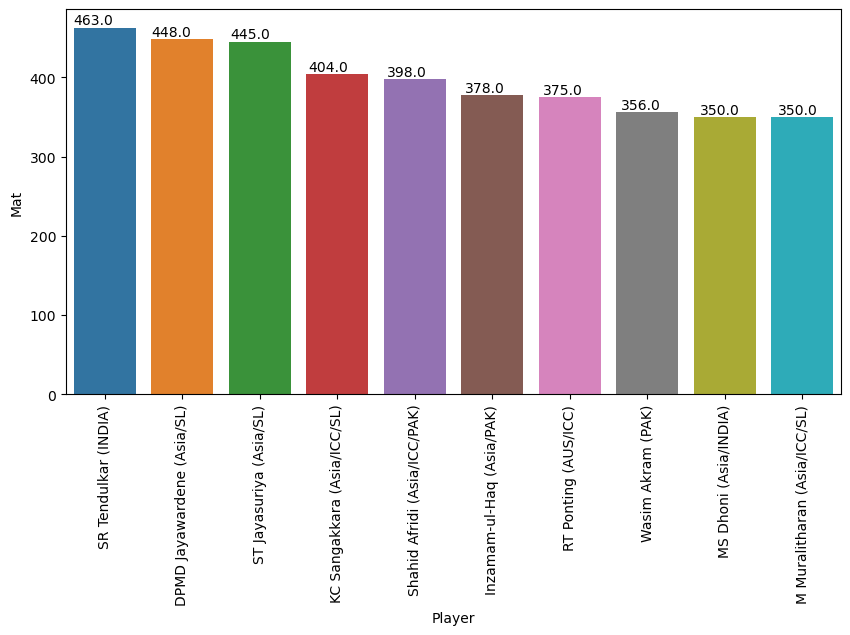

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


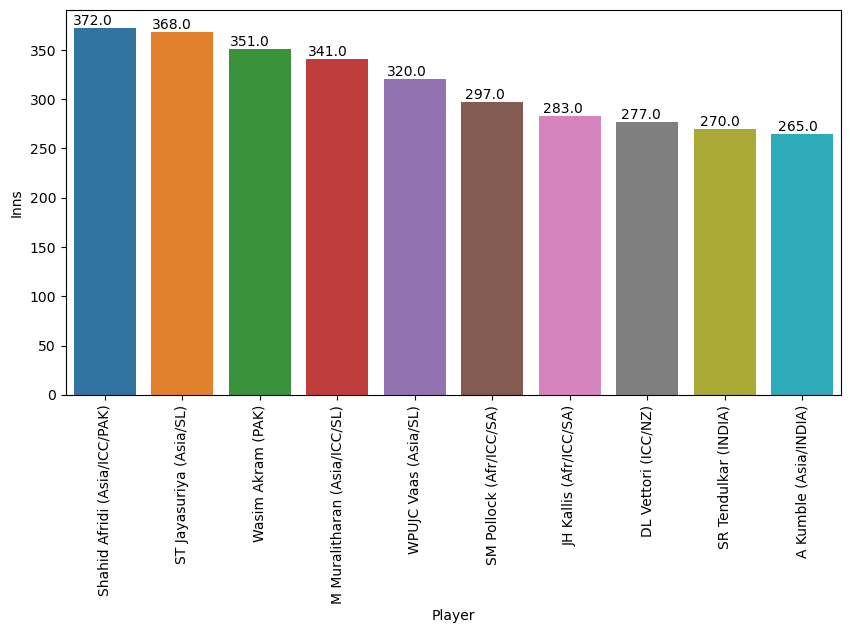

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


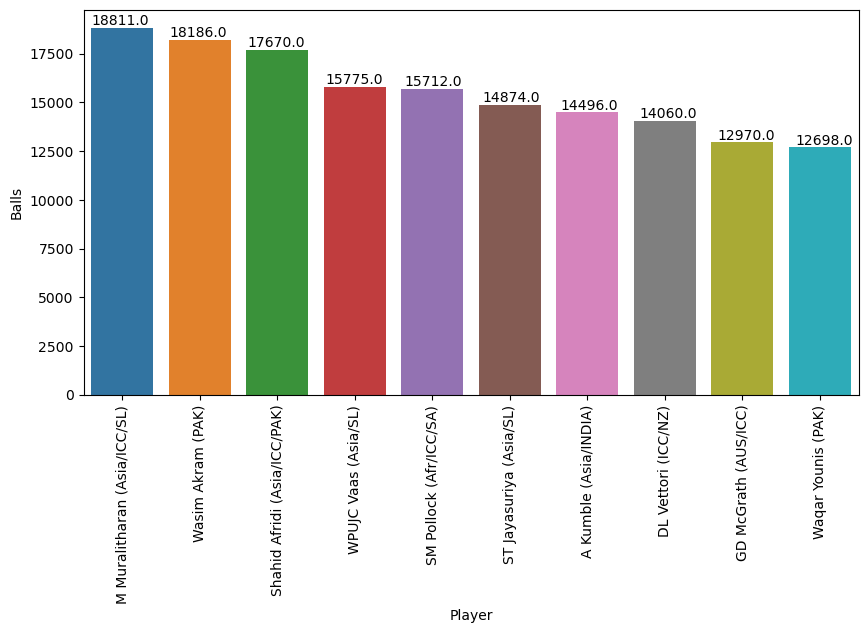

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


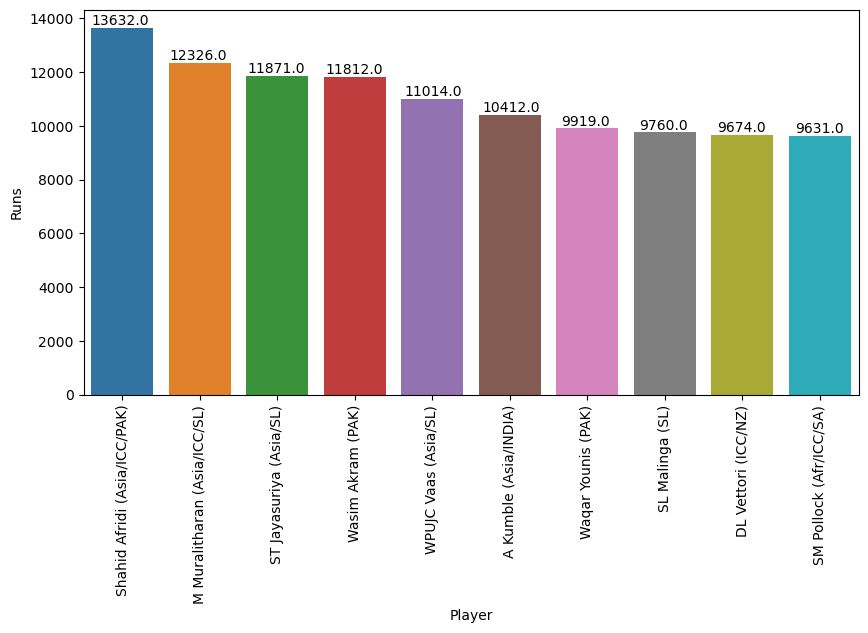

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


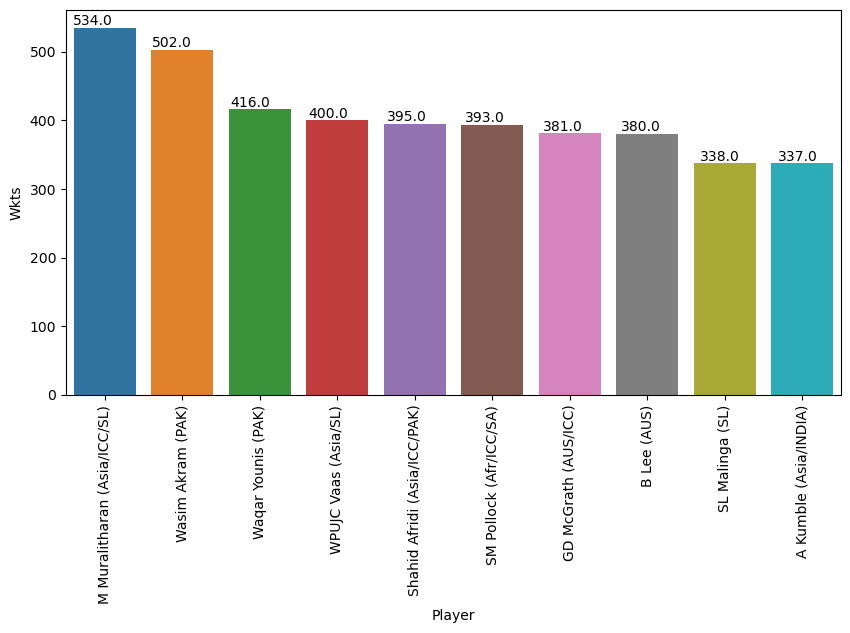

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


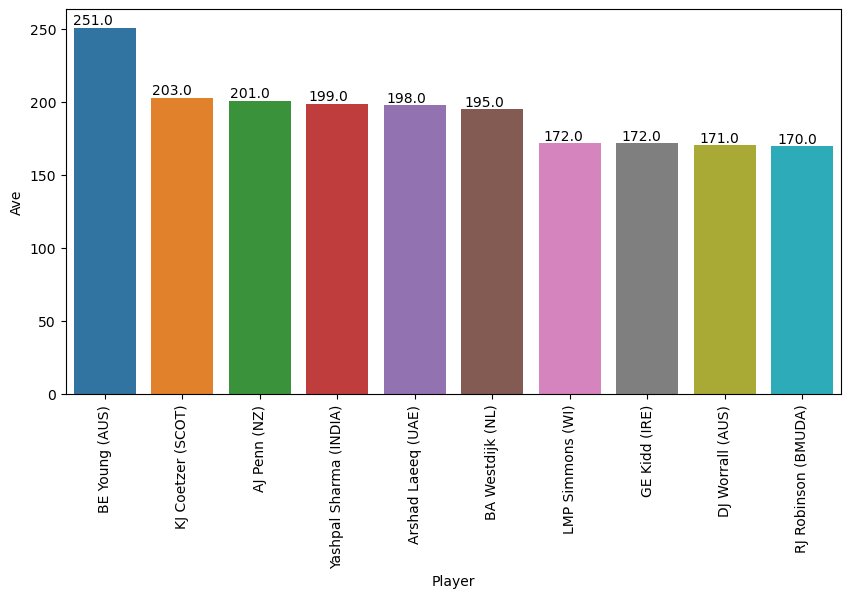

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


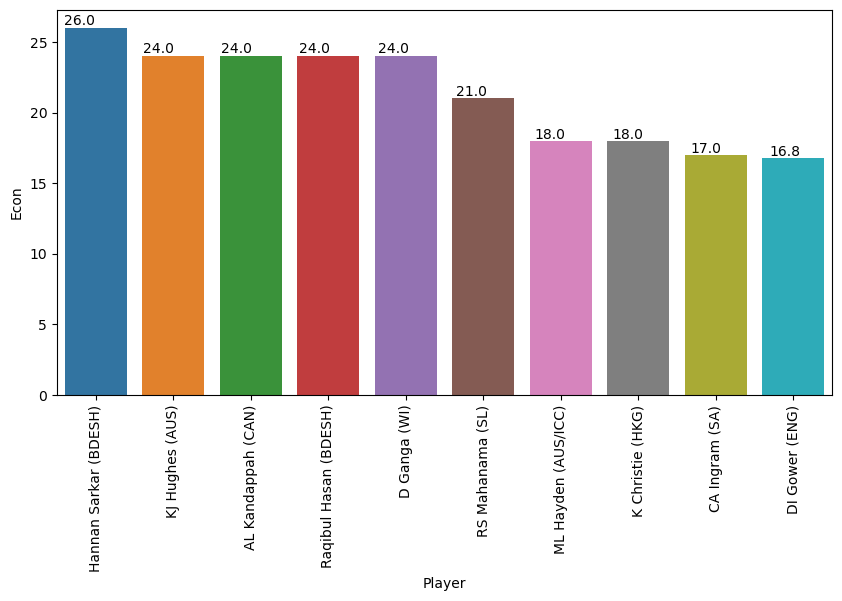

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


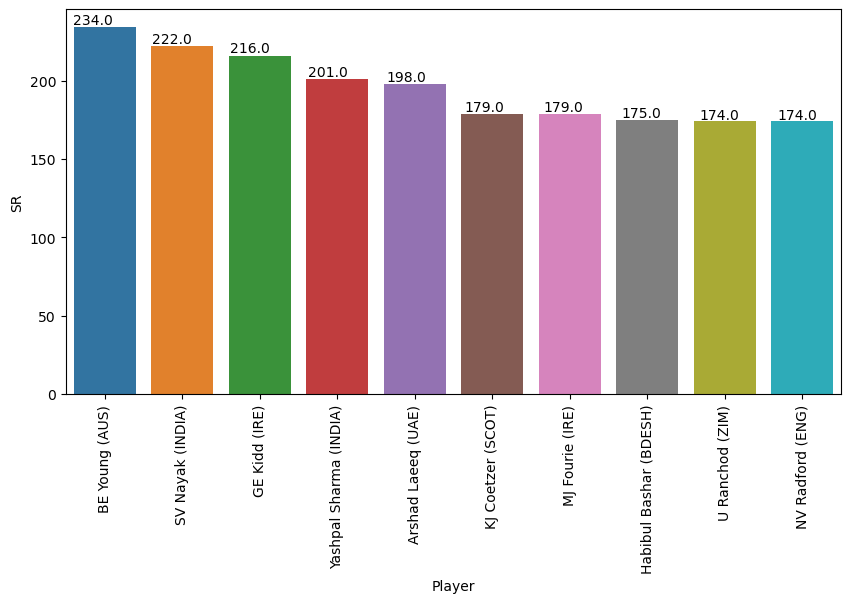

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


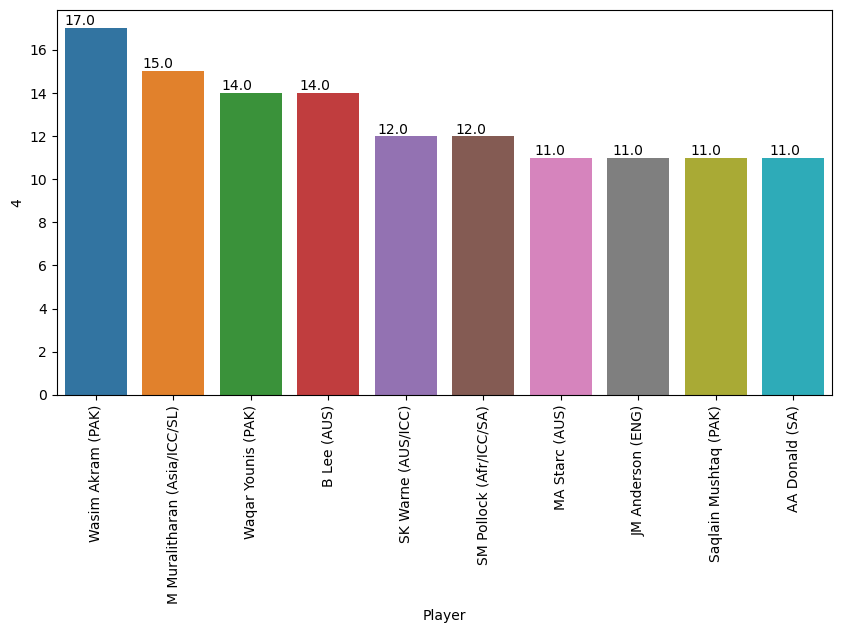

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


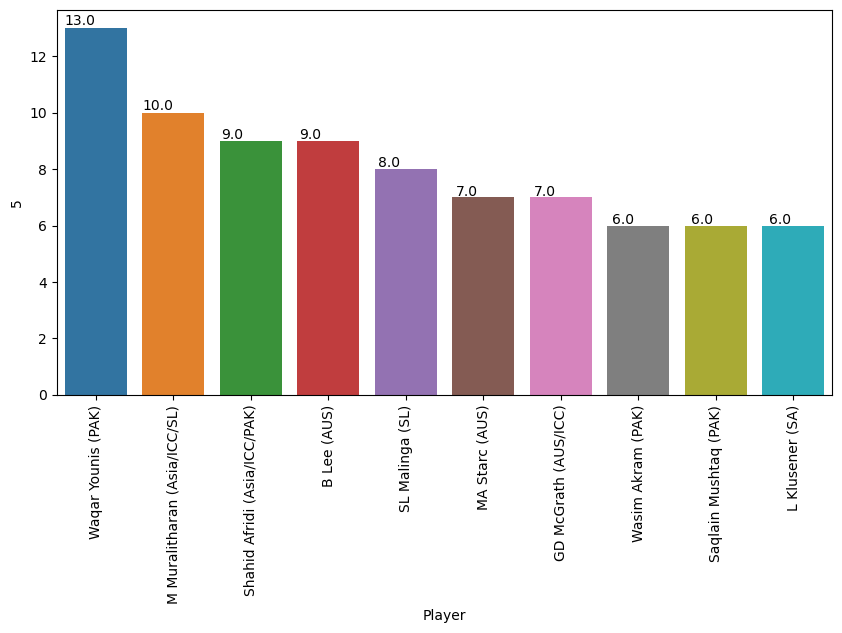

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


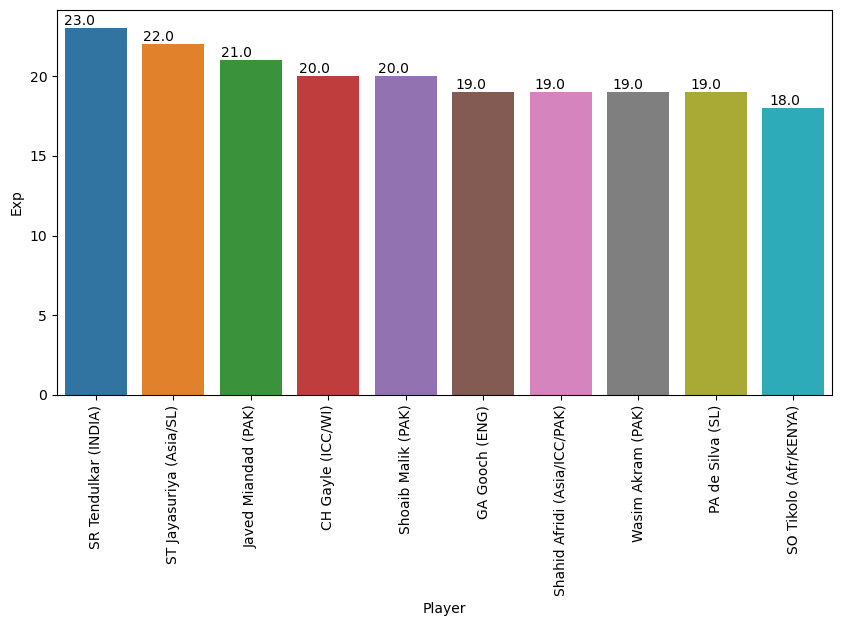

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


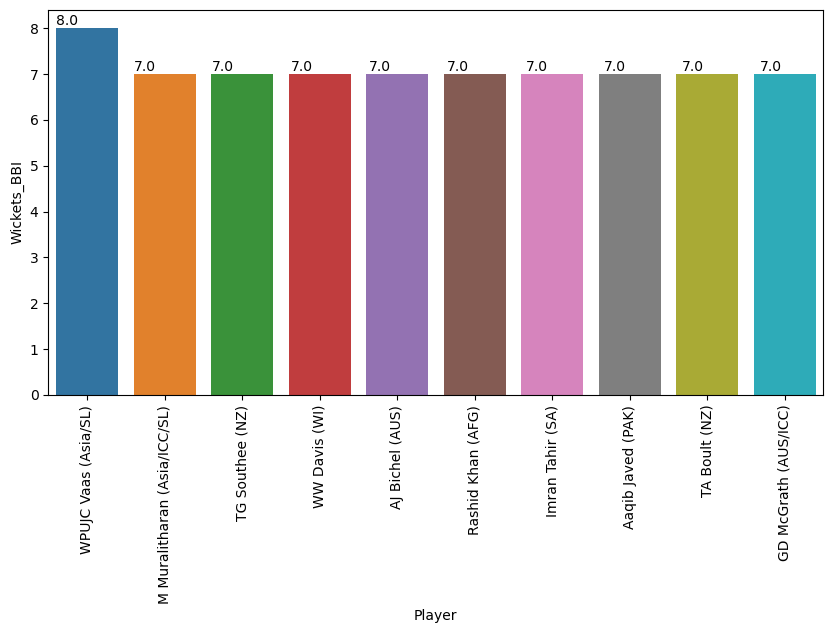

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


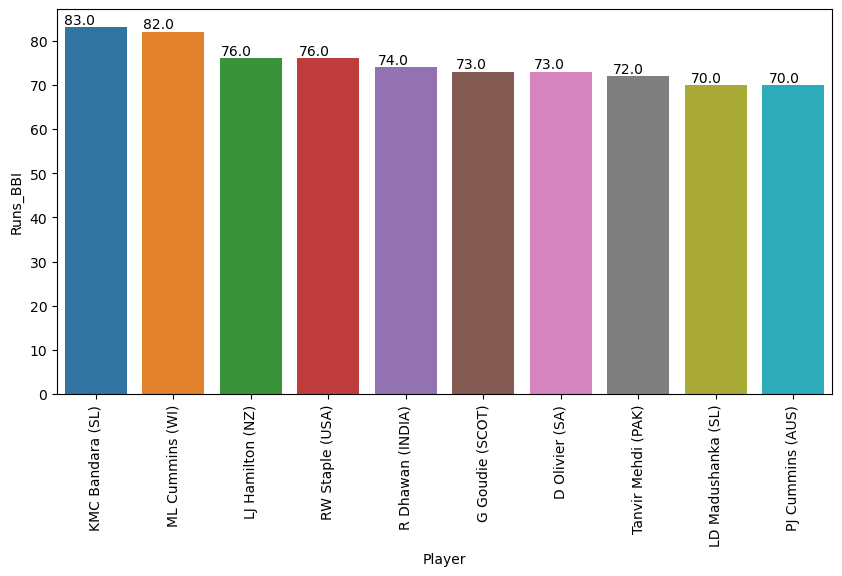

In [165]:
for column in ODI_col:
    plt.figure(figsize = (10,5))
    mat_top10 = odi_data_dup[['Player',column]].sort_values(column, ascending = False).head(10)
    ax = sns.barplot(x='Player', y=column, data= mat_top10)
    for p in ax.patches:
        ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
    ax.set(xlabel = 'Player', ylabel= column)
    plt.xticks(rotation=90)
    plt.show()

### Univariate Analysis for T20 Data

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


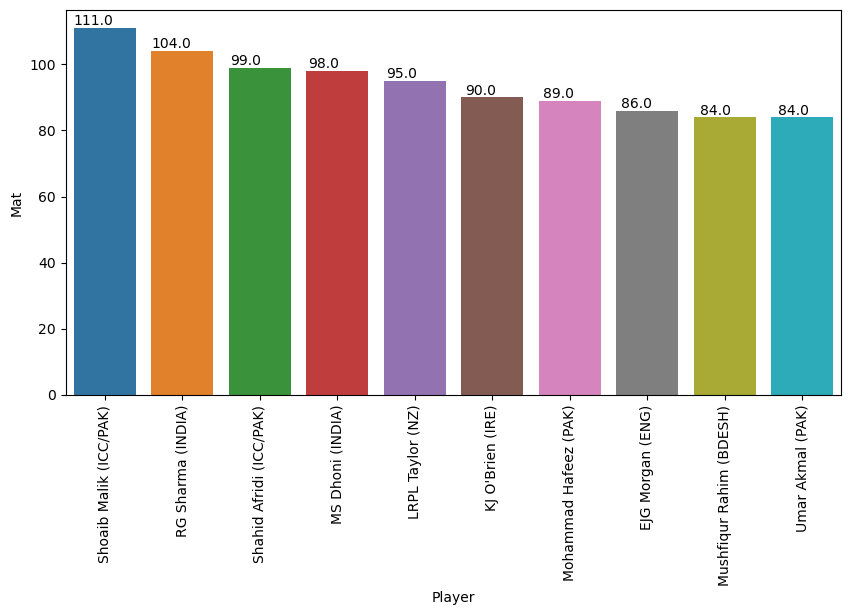

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


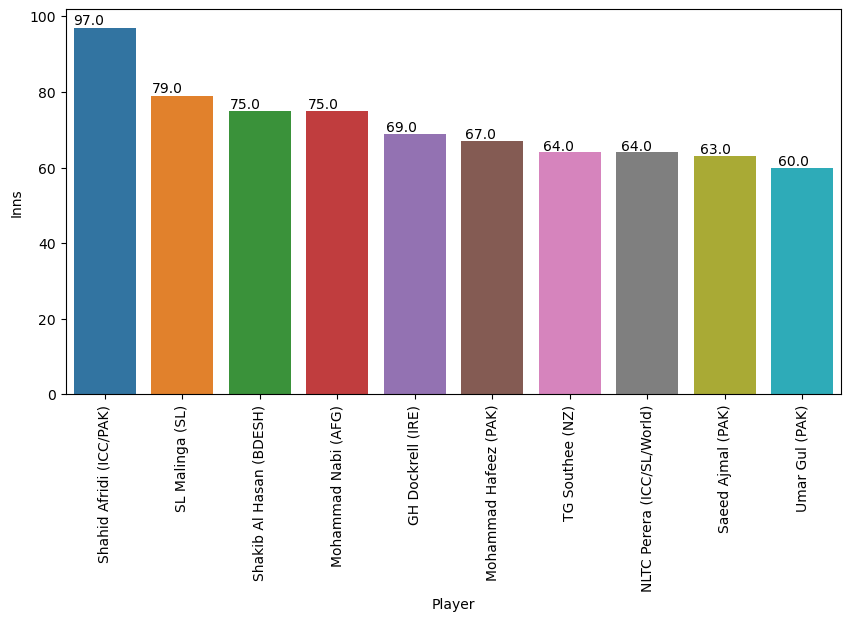

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


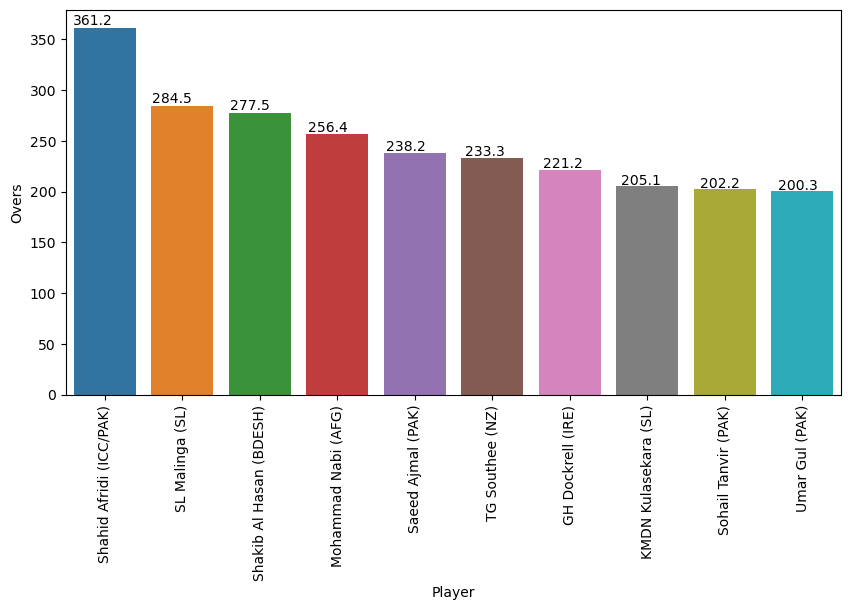

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


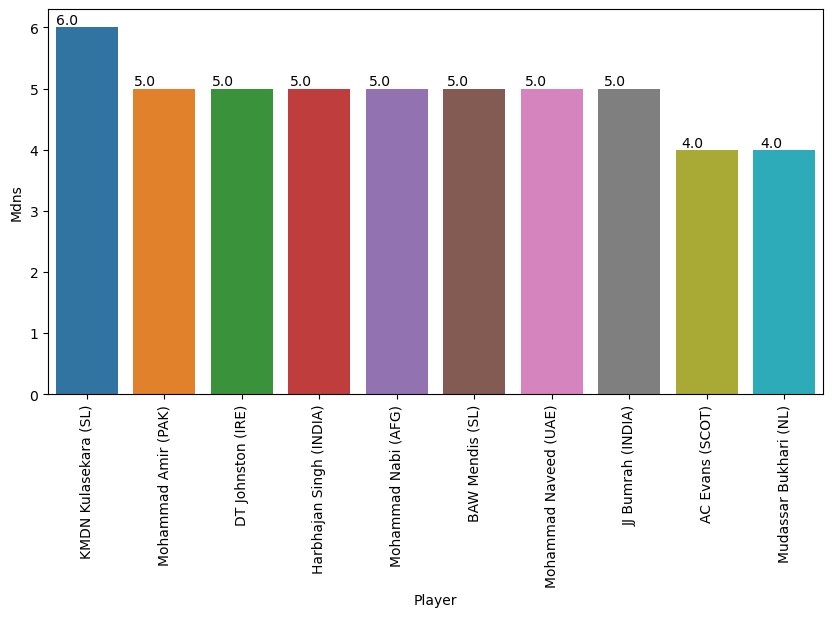

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


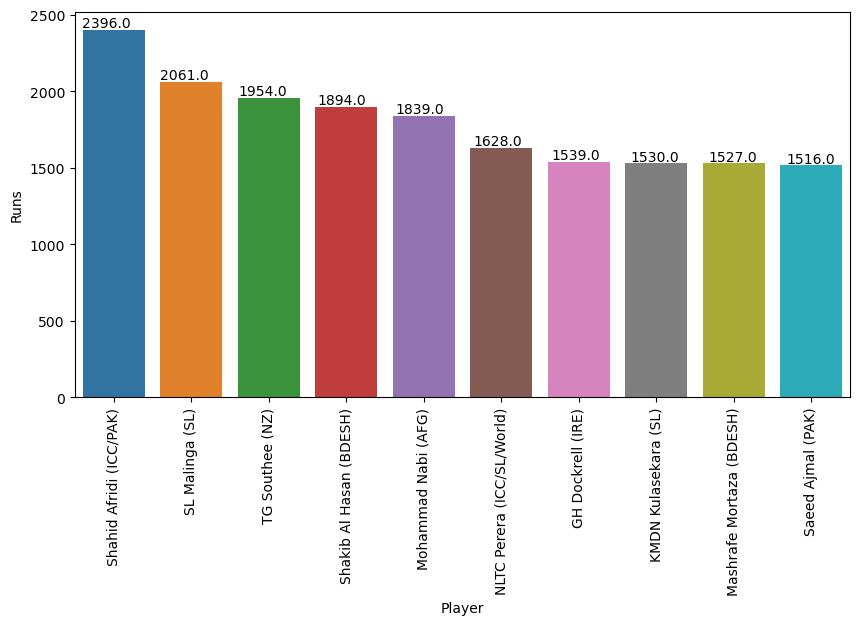

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


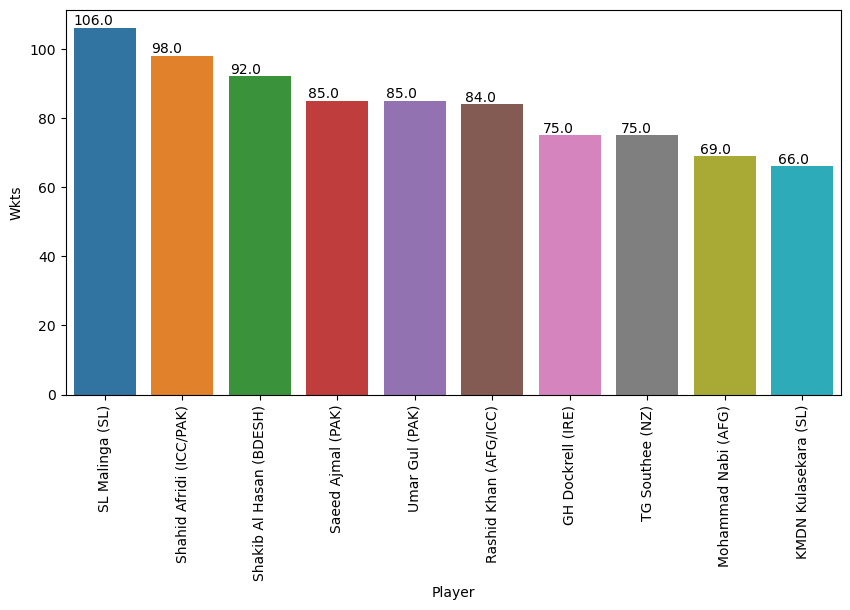

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


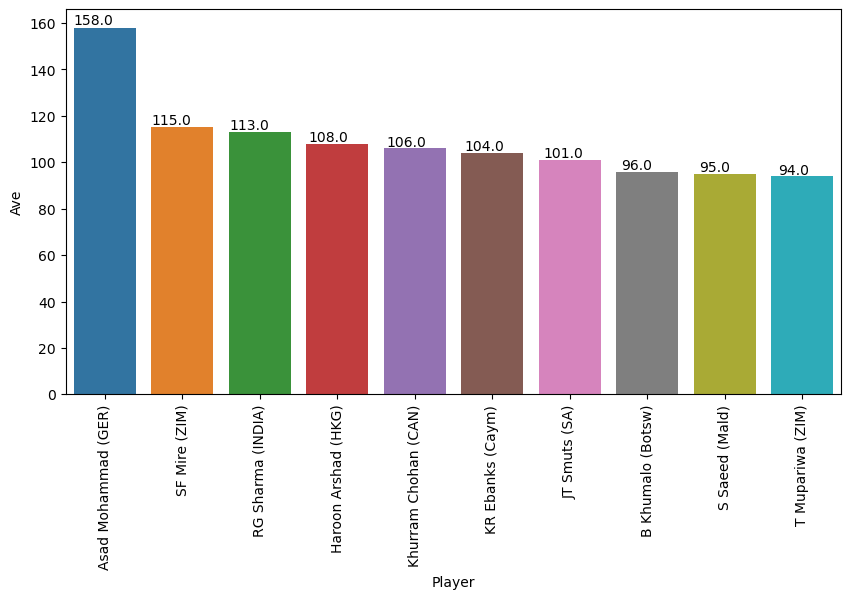

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


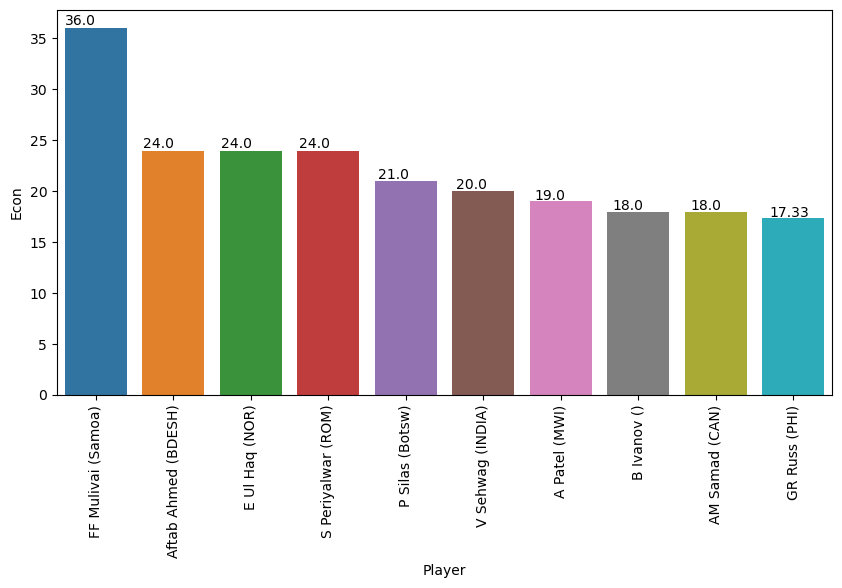

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


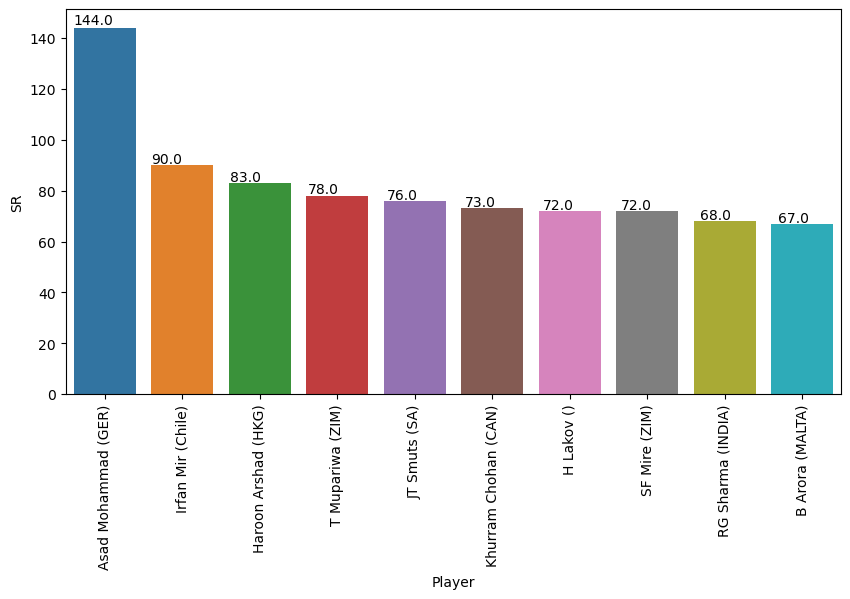

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


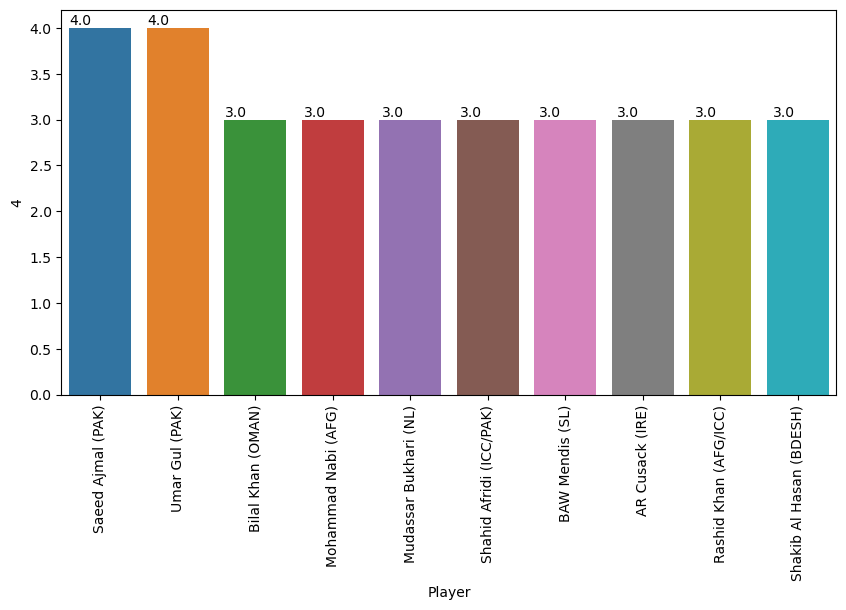

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


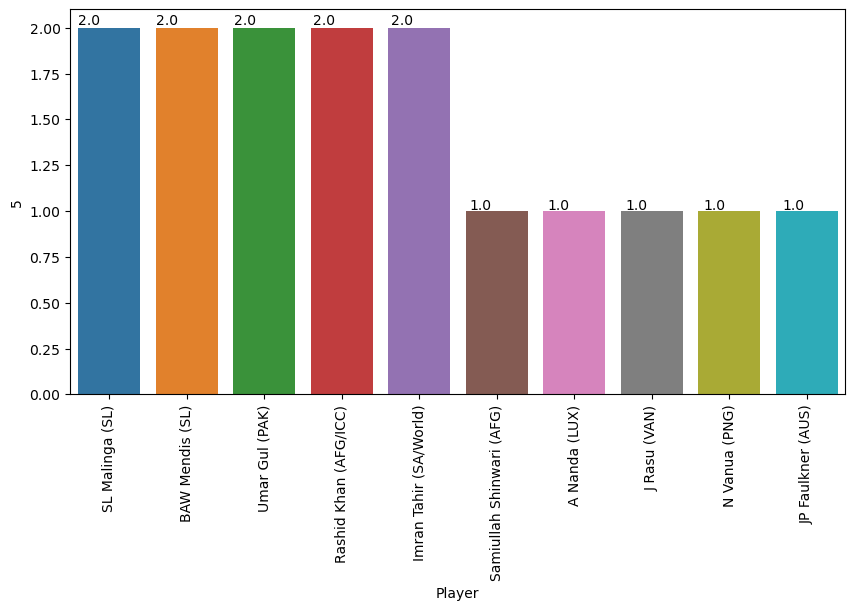

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


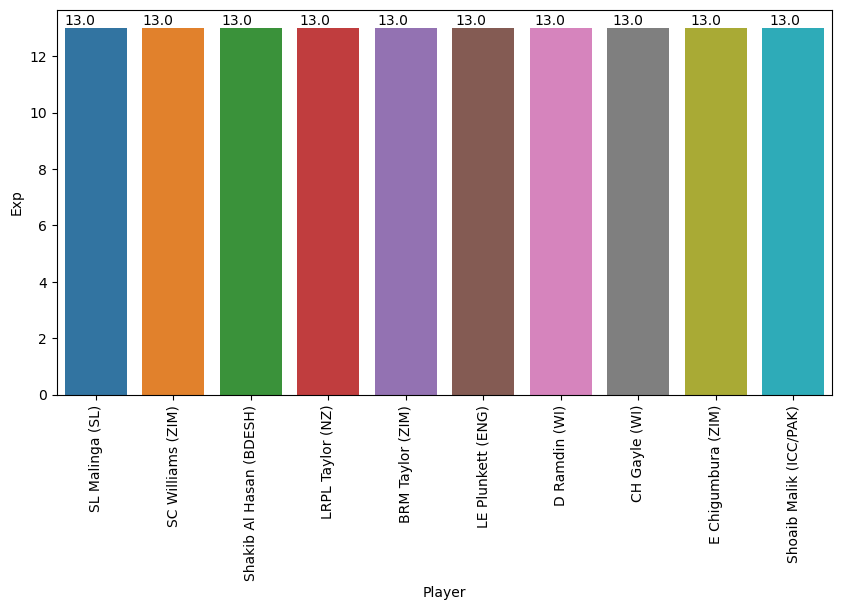

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


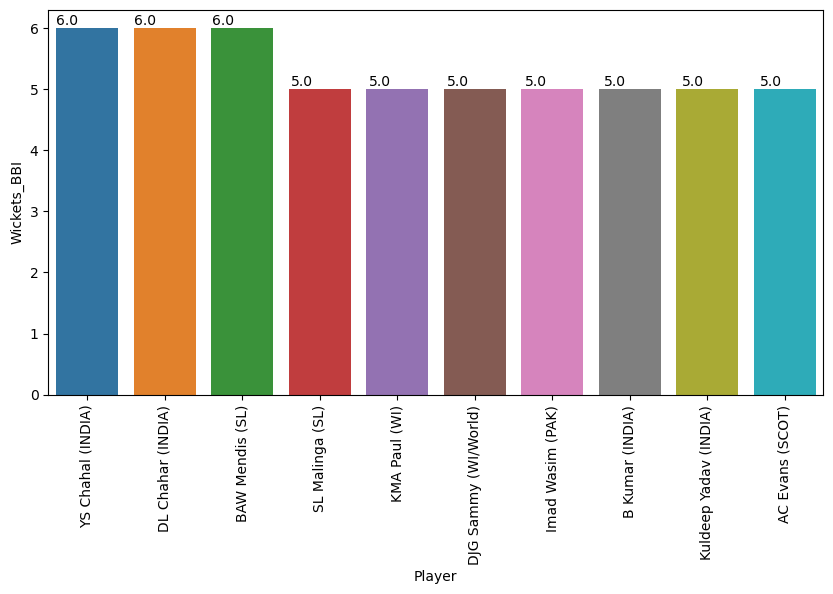

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


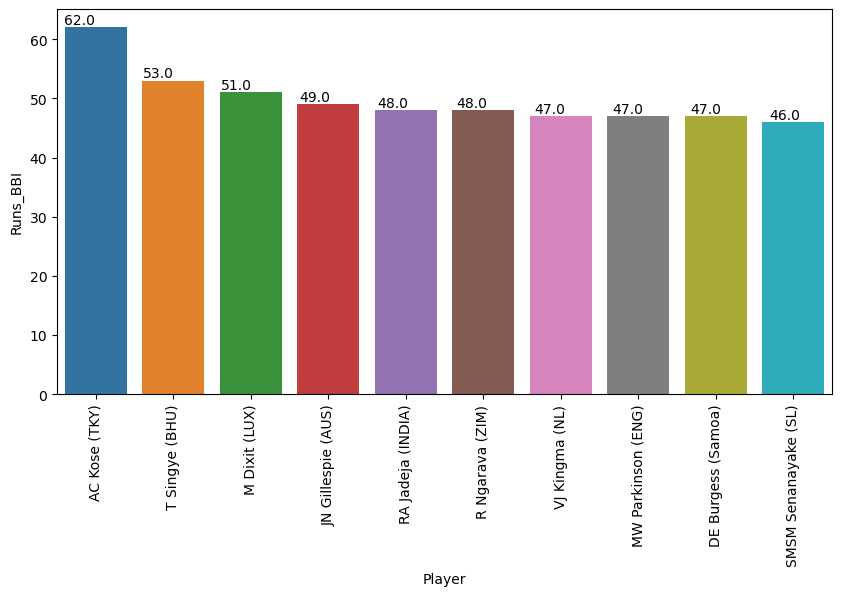

In [166]:
for column in T20_col:
    plt.figure(figsize = (10,5))
    mat_top10 = t20_data_dup[['Player',column]].sort_values(column, ascending = False).head(10)
    ax = sns.barplot(x='Player', y=column, data= mat_top10)
    for p in ax.patches:
        ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
    ax.set(xlabel = 'Player', ylabel= column)
    plt.xticks(rotation=90)
    plt.show()

### Univariate Analysis for Test Data

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


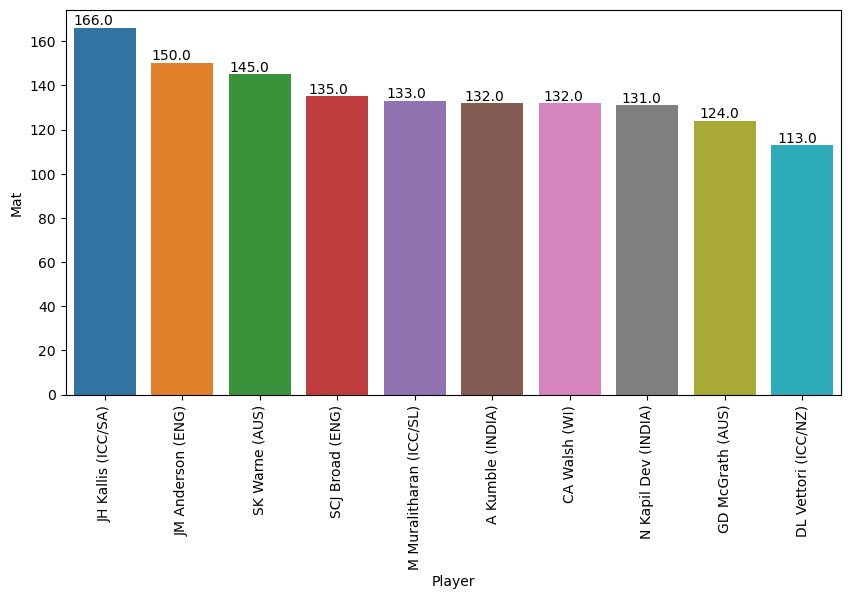

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


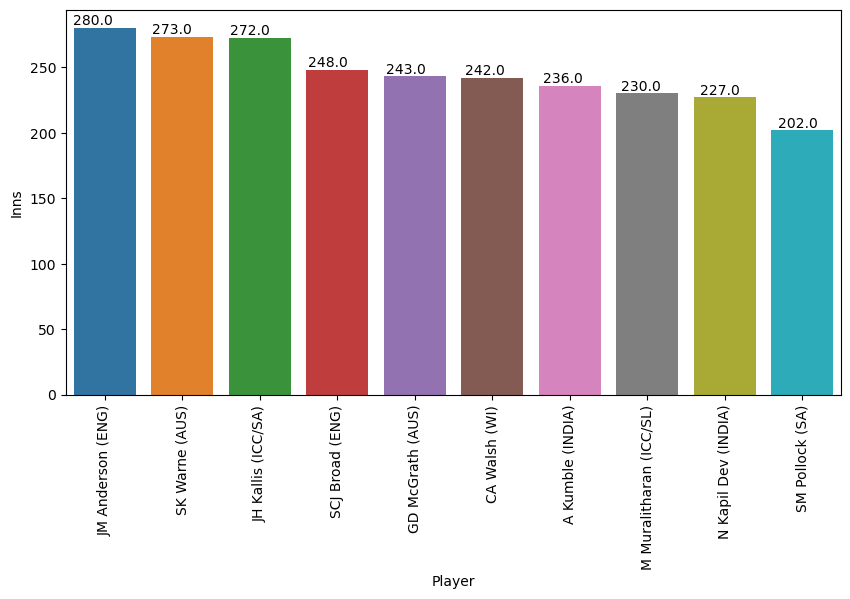

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


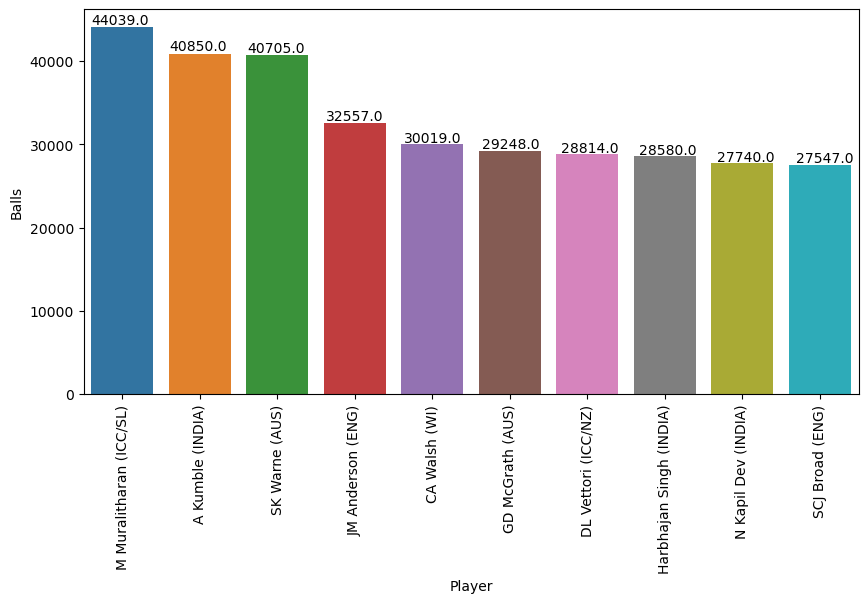

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


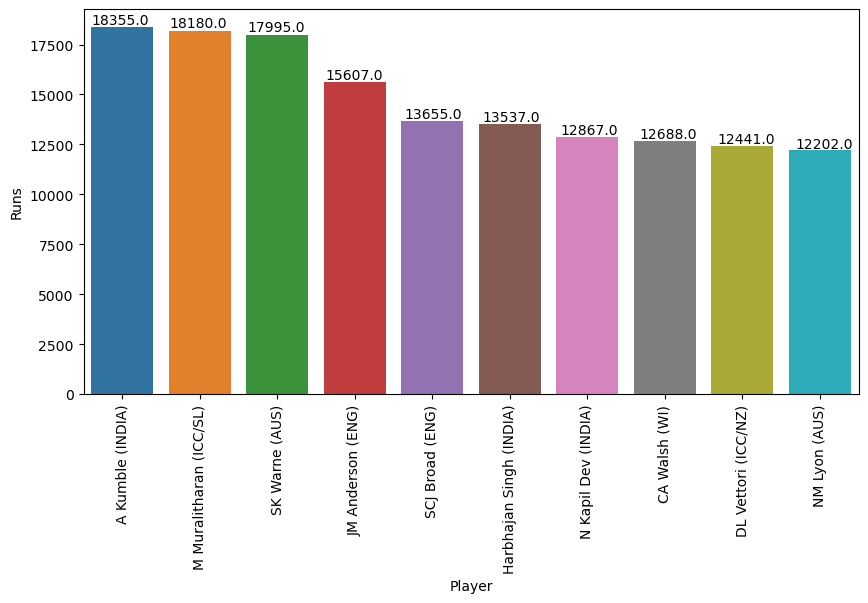

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


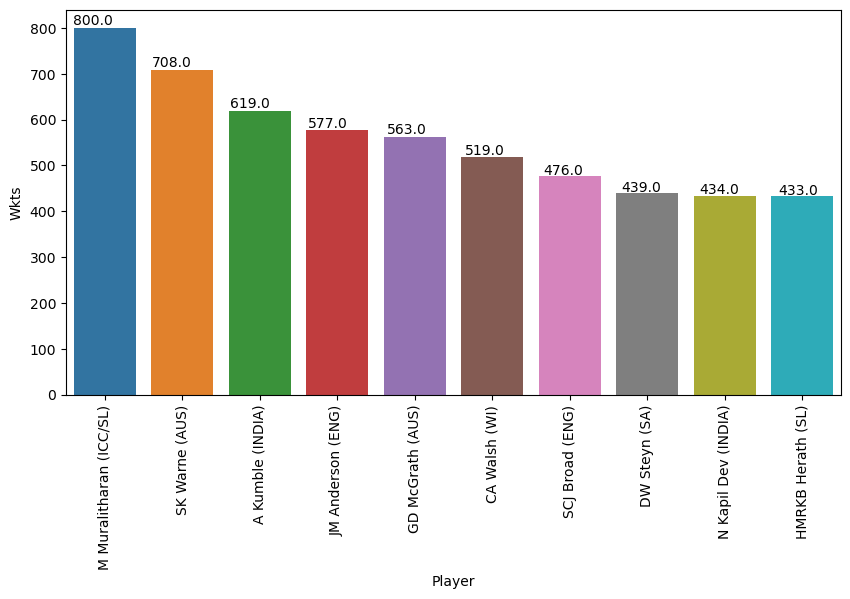

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


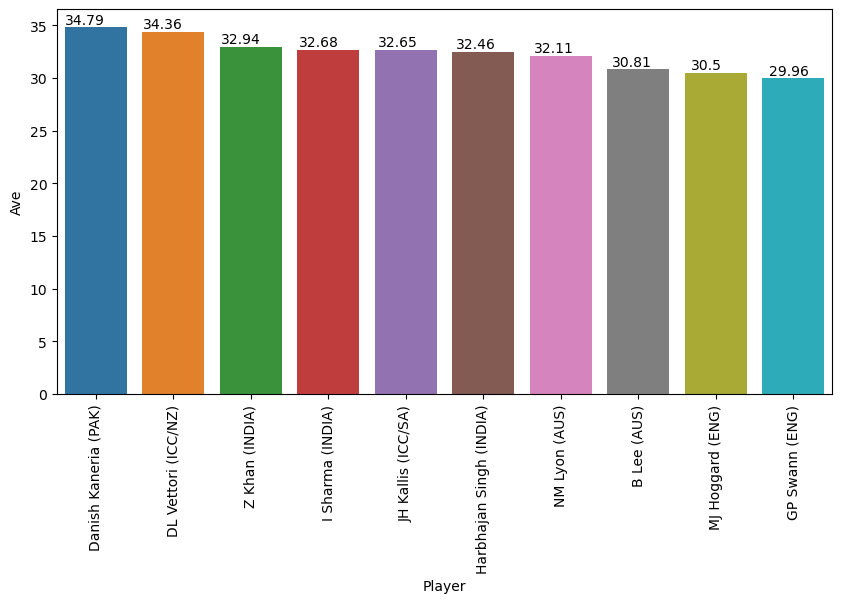

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


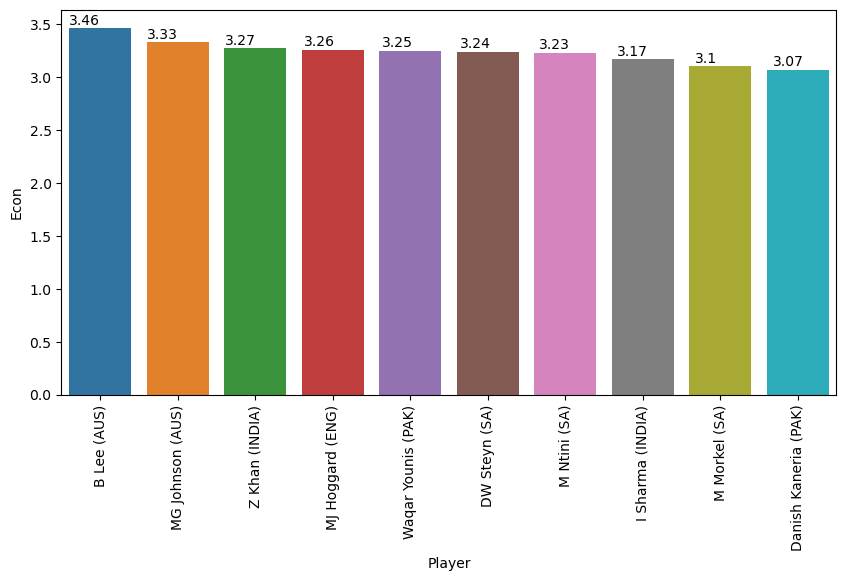

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


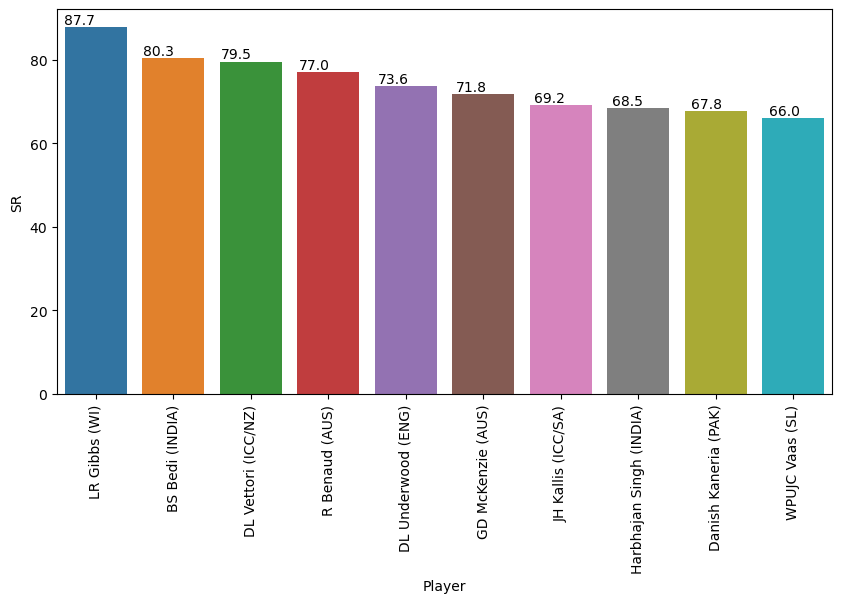

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


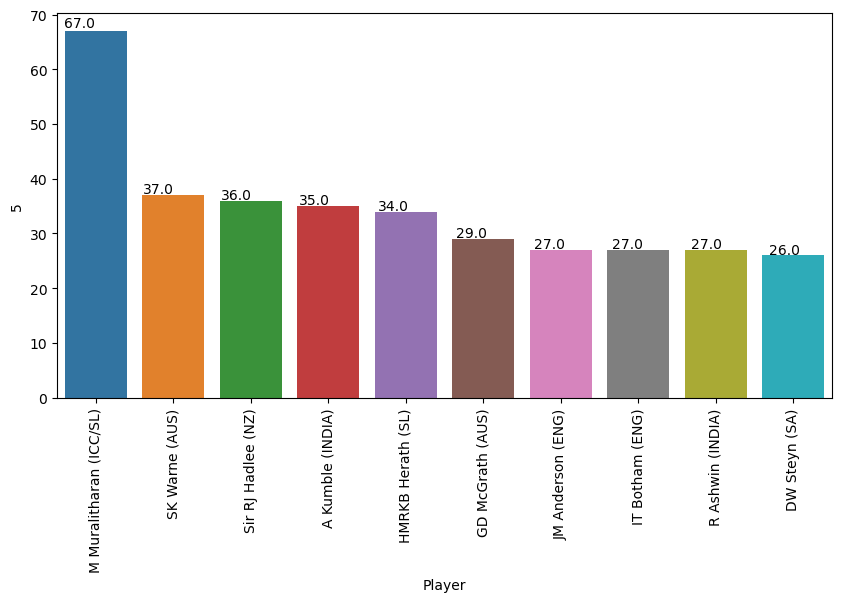

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


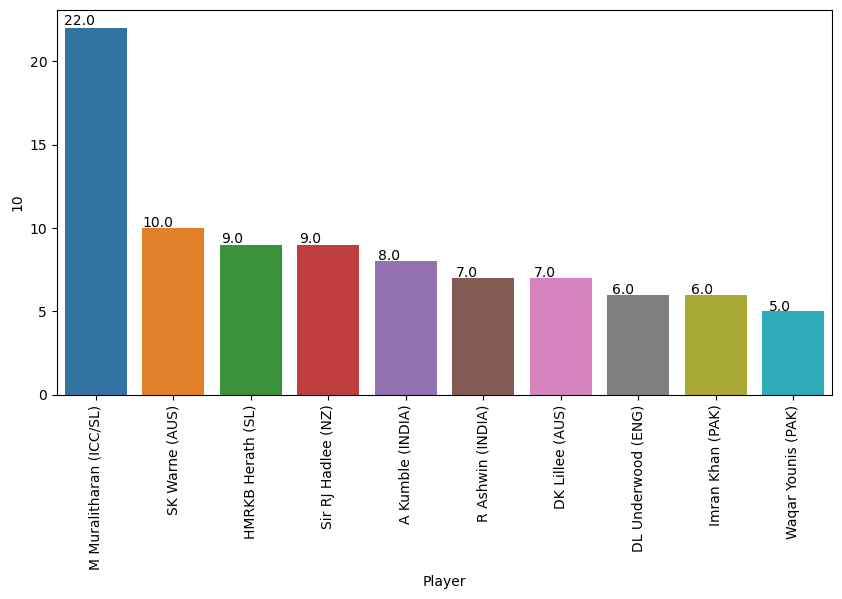

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


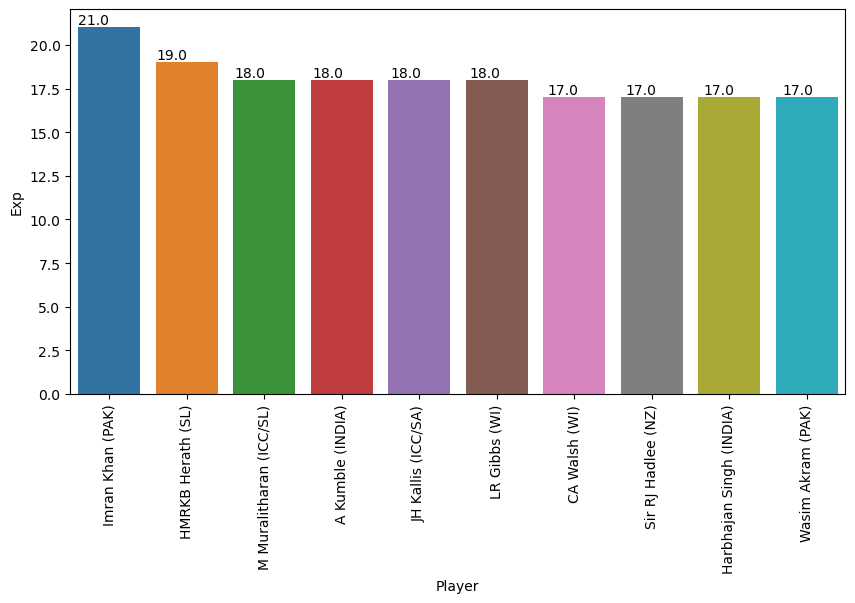

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


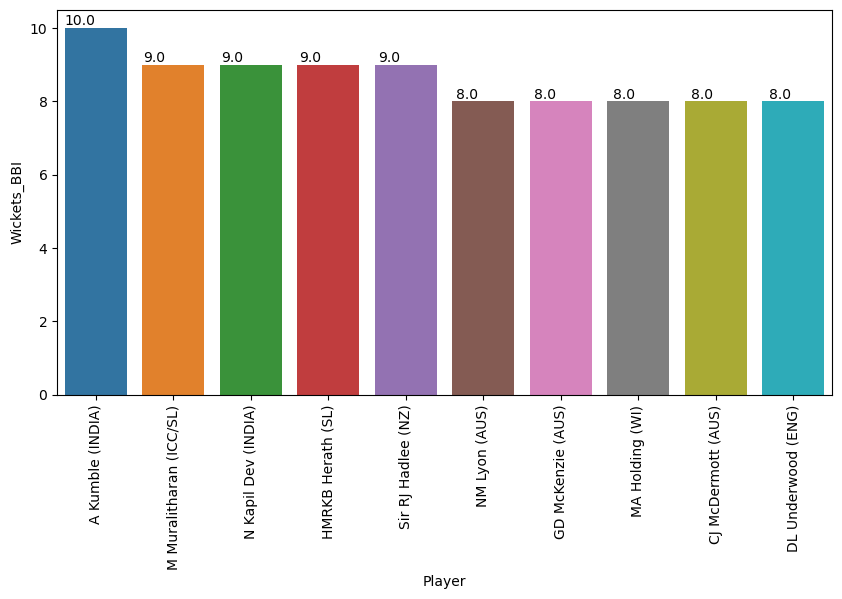

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


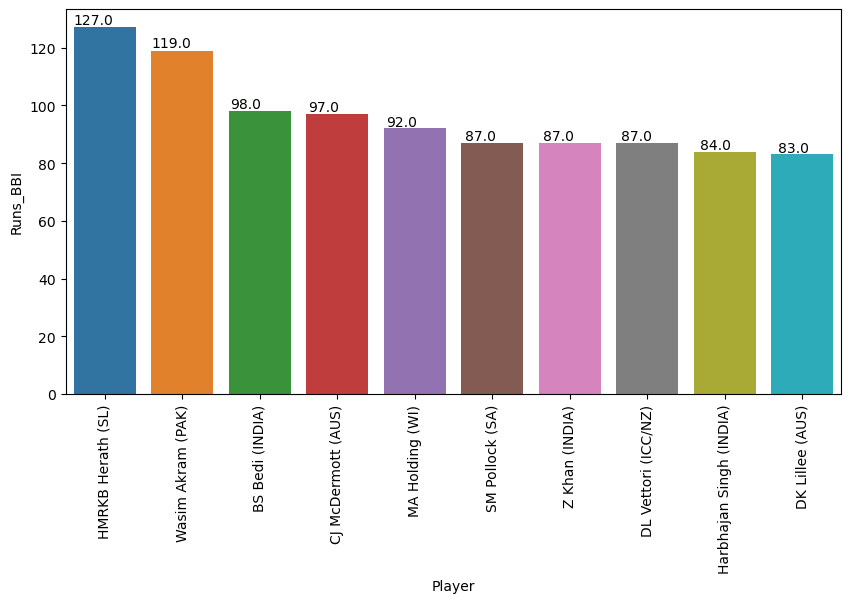

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


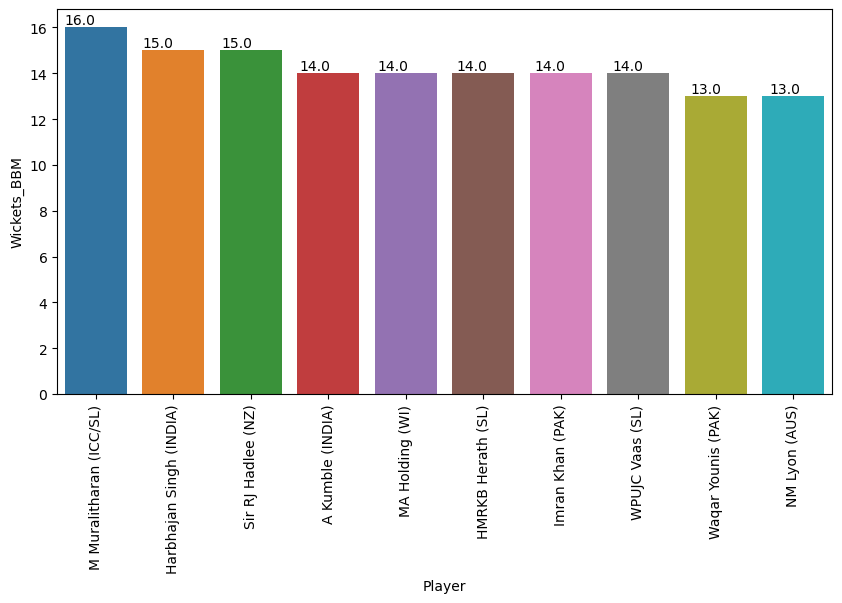

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


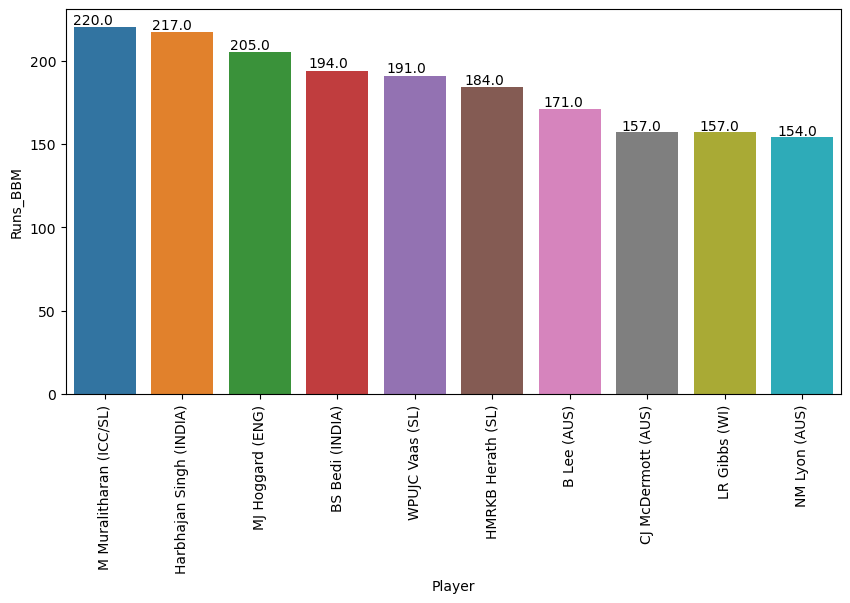

In [167]:
for column in Test_col:
    plt.figure(figsize = (10,5))
    mat_top10 = test_data_dup[['Player',column]].sort_values(column, ascending = False).head(10)
    ax = sns.barplot(x='Player', y=column, data= mat_top10)
    for p in ax.patches:
        ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
    ax.set(xlabel = 'Player', ylabel= column)
    plt.xticks(rotation=90)
    plt.show()

## Correlation between ODI data

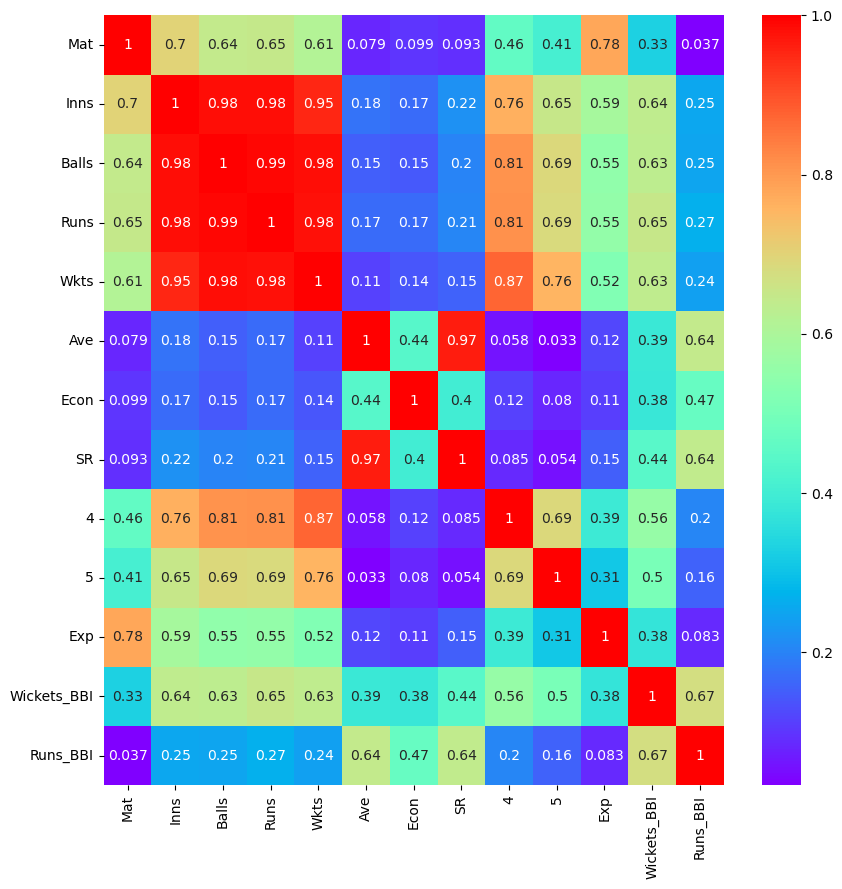

In [168]:
# Let's check the correlation coefficients to see which variables are highly correlated
plt.figure(figsize = (10, 10))
sns.heatmap(odi_data_dup[ODI_col].corr(), annot = True, cmap="rainbow")
plt.savefig('Correlation')
plt.show()

## Correlation between T20 Data

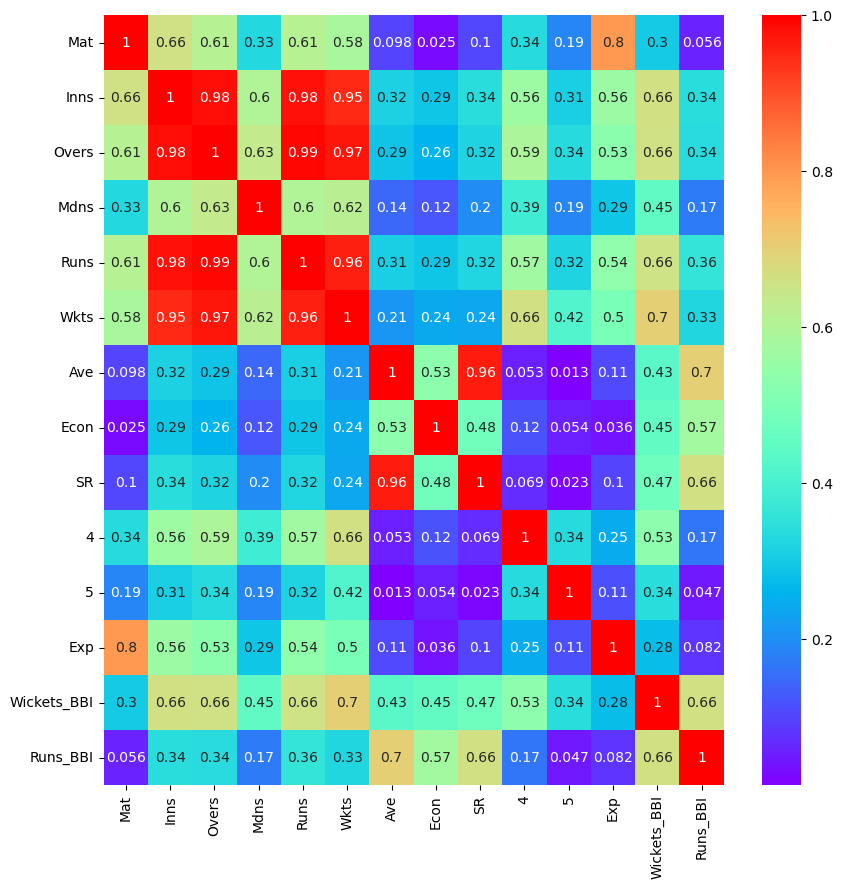

In [169]:
# Let's check the correlation coefficients to see which variables are highly correlated
plt.figure(figsize = (10, 10))
sns.heatmap(t20_data_dup[T20_col].corr(), annot = True, cmap="rainbow")
plt.savefig('Correlation')
plt.show()

## Correlation between Test Data

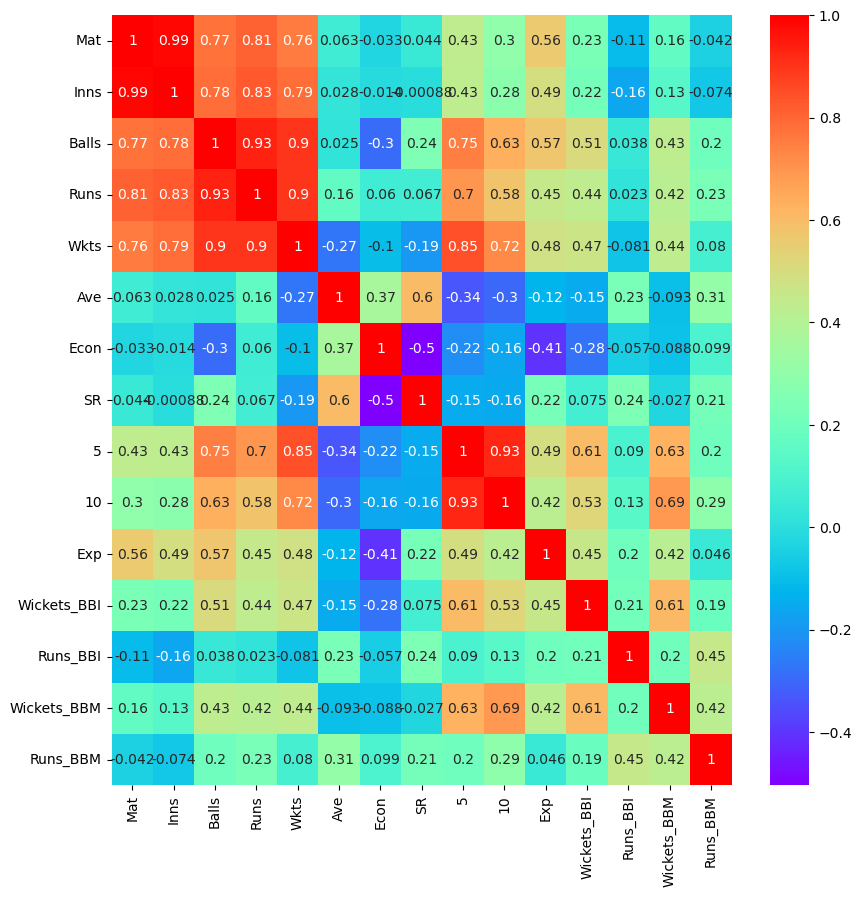

In [170]:
# Let's check the correlation coefficients to see which variables are highly correlated
plt.figure(figsize = (10, 10))
sns.heatmap(test_data_dup[Test_col].corr(), annot = True, cmap="rainbow")
plt.savefig('Correlation')
plt.show()

## Pair Plot

### ODI Data

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstan

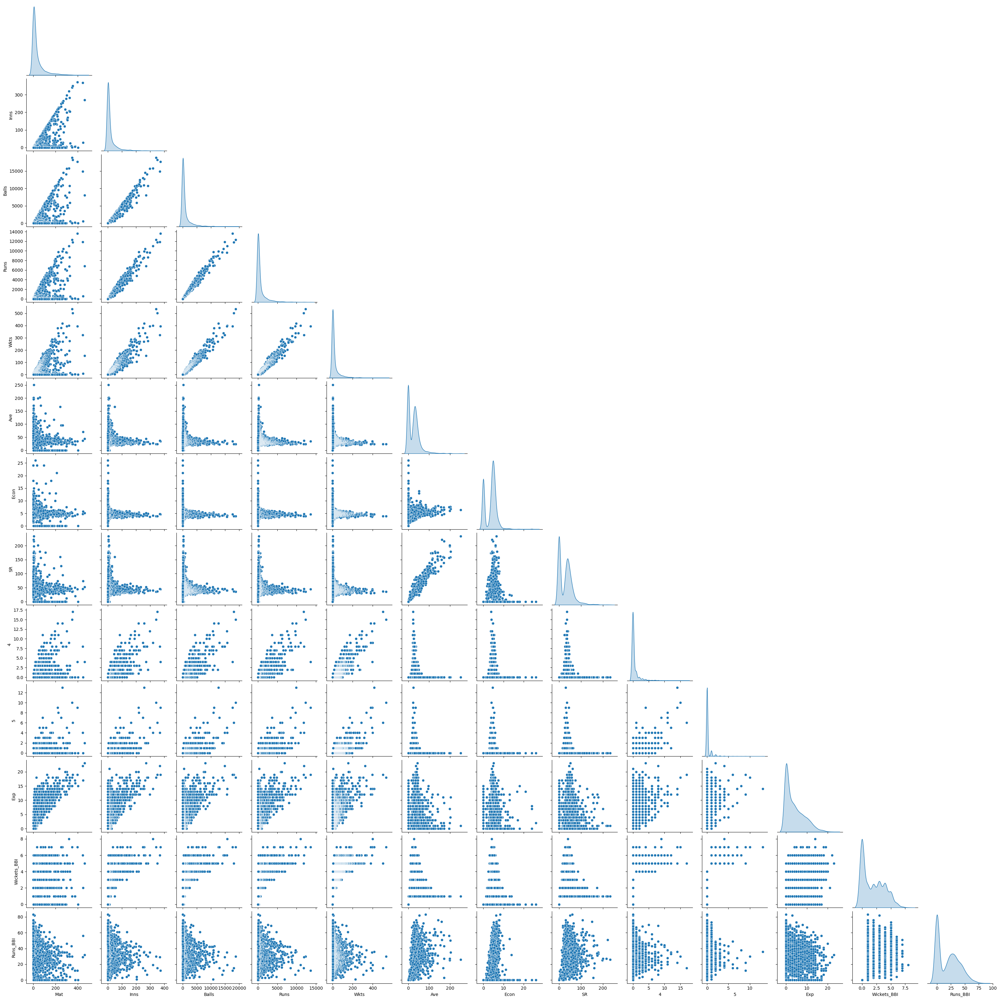

In [171]:
sns.pairplot(odi_data_dup,corner=True,diag_kind="kde")
plt.show()

### T20 Data

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstan

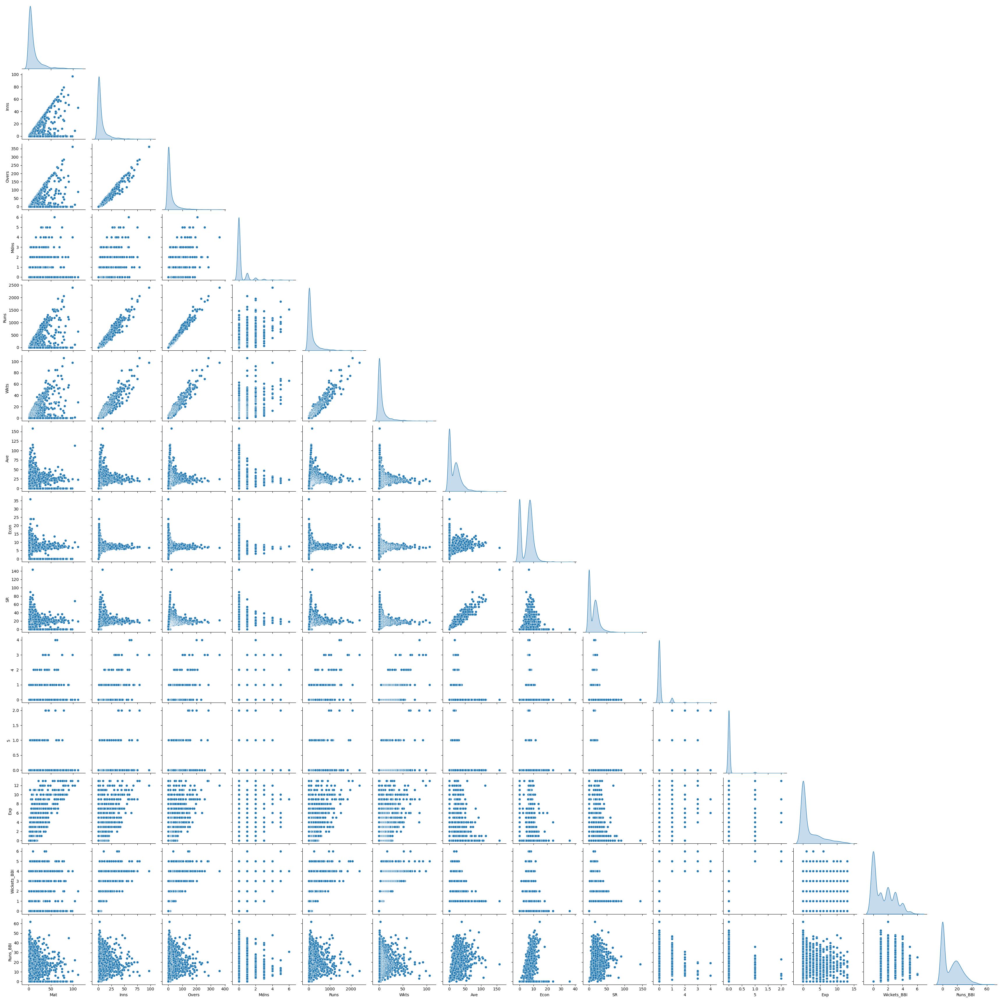

In [172]:
sns.pairplot(t20_data_dup,corner=True,diag_kind="kde")
plt.show()

### Test Data

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstan

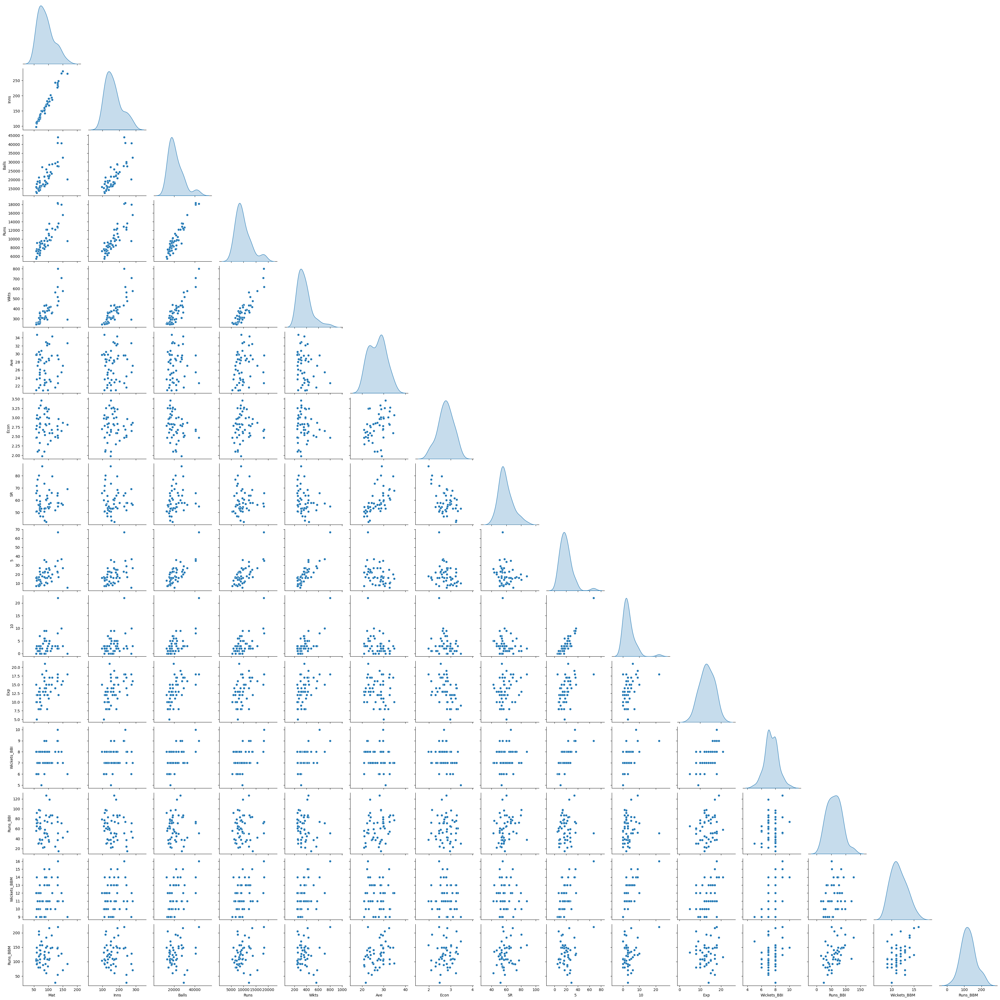

In [173]:
sns.pairplot(test_data_dup,corner=True,diag_kind="kde")
plt.show()

# Outlier Analysis

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstan

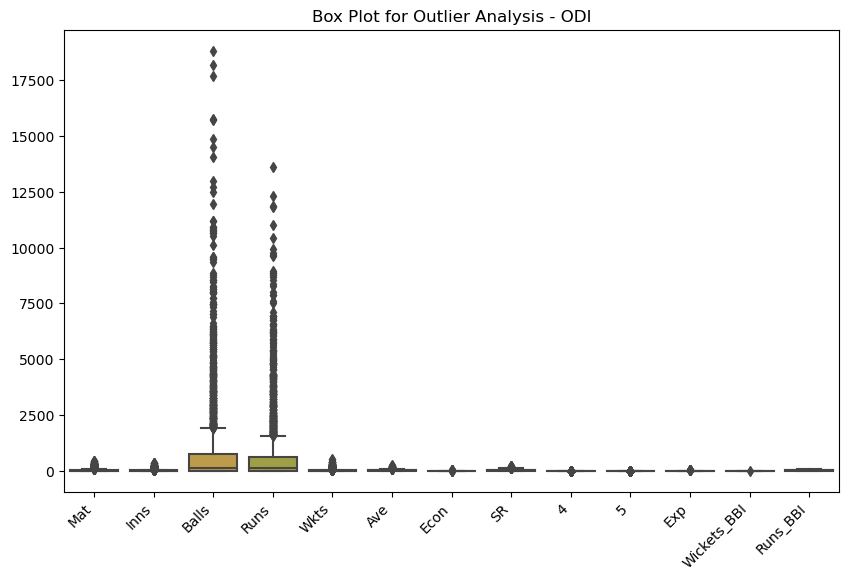

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstan

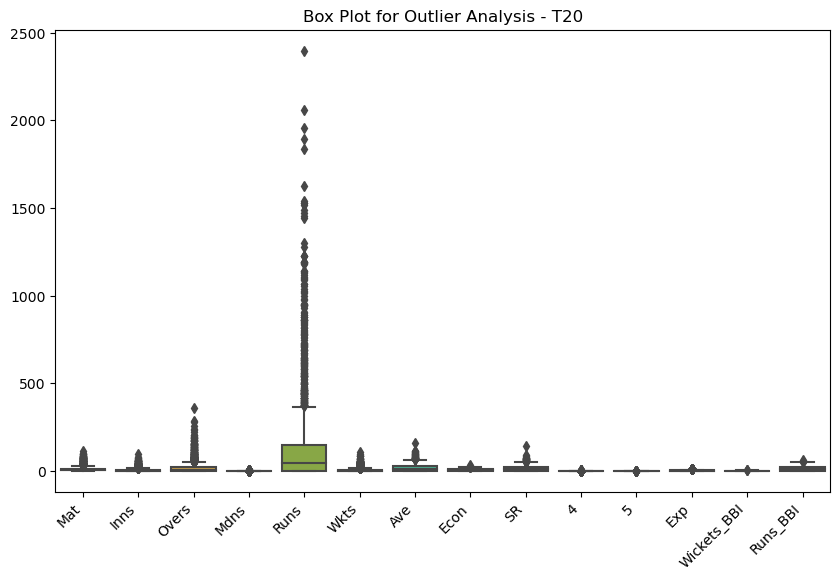

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstan

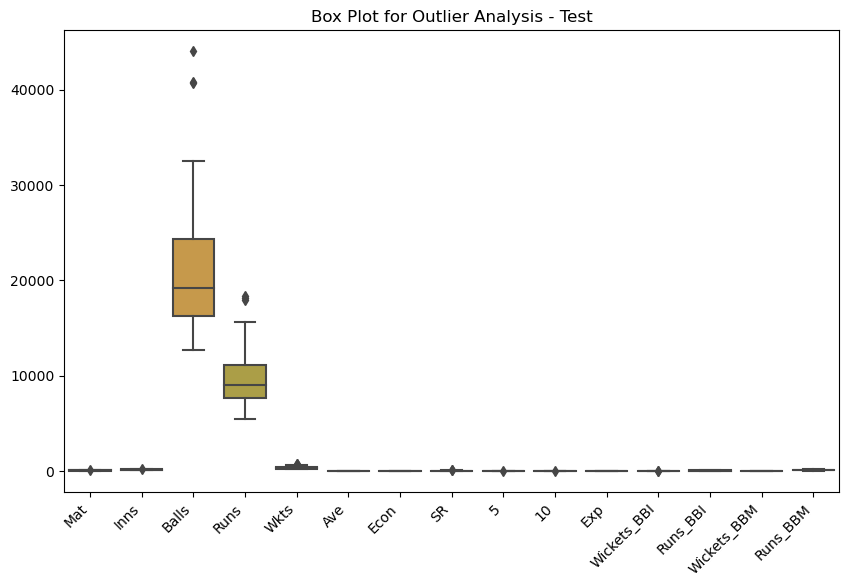

In [174]:

dataset_names = ['ODI', 'T20', 'Test']

# Box plot for each dataset
for i, dataset in enumerate(datasets):
    plt.figure(figsize=(10, 6))
    plt.title(f'Box Plot for Outlier Analysis - {dataset_names[i]}')
    sns.boxplot(data=dataset)
    plt.xticks(rotation=45, ha='right')
    plt.show()

# Probability Question using Cricket (Bowling Dataset)

1. What is the distribution of bowling averages among different players?

2. What is the average number of wickets taken by players with bowling averages  below a certain threshold?

3. How do the economy rates vary among different bowlers?
 
4. Is there a correlation between economy rate and wickets taken?

5. What is the typical strike rate for bowlers?

6. How does the number of wickets taken correlate with the strike rate?

7. Who had the best bowling performance, and in which match did it occur?

8. How often do players achieve their best bowling performance?

9. What is the probability of a player taking a specific number of wickets in an inning?

10. Given a specific bowling average threshold, what is the probability of a player having an average below that threshold?

### 1. What is the distribution of bowling averages among different players?

In [175]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import norm
from scipy import stats

ODI Dataset

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


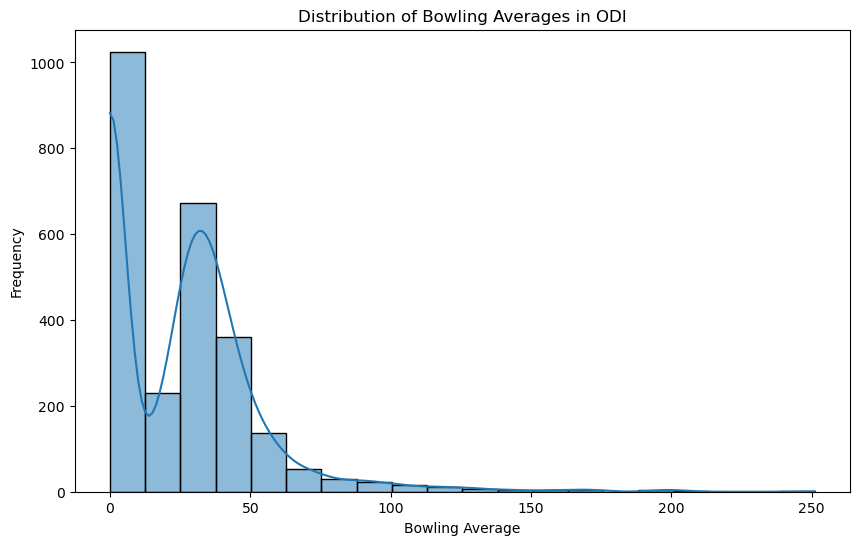

In [176]:
# bowling_data is your DataFrame
bowling_data = odi_data_dup
bowling_data[['Ave', 'Wkts', 'SR', 'Econ']] = bowling_data[['Ave', 'Wkts', 'SR', 'Econ']].apply(pd.to_numeric, errors='coerce')

# 1. Distribution of Bowling Averages among Different Players
plt.figure(figsize=(10, 6))
sns.histplot(bowling_data['Ave'], bins=20, kde=True)
plt.title('Distribution of Bowling Averages in ODI')
plt.xlabel('Bowling Average')
plt.ylabel('Frequency')
plt.show()

T20

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


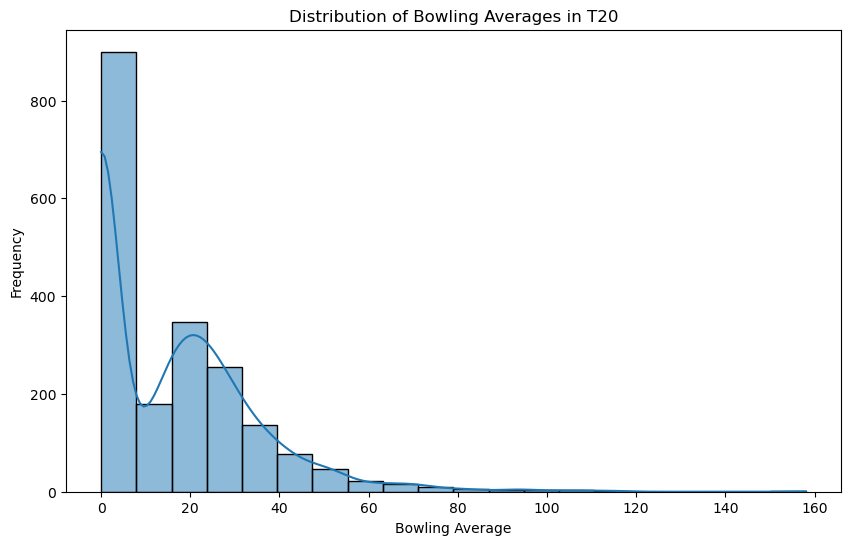

In [177]:
# bowling_data is your DataFrame
bowling_data = t20_data_dup
bowling_data[['Ave', 'Wkts', 'SR', 'Econ']] = bowling_data[['Ave', 'Wkts', 'SR', 'Econ']].apply(pd.to_numeric, errors='coerce')

# 1. Distribution of Bowling Averages among Different Players
plt.figure(figsize=(10, 6))
sns.histplot(bowling_data['Ave'], bins=20, kde=True)
plt.title('Distribution of Bowling Averages in T20')
plt.xlabel('Bowling Average')
plt.ylabel('Frequency')
plt.show()

Test data

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


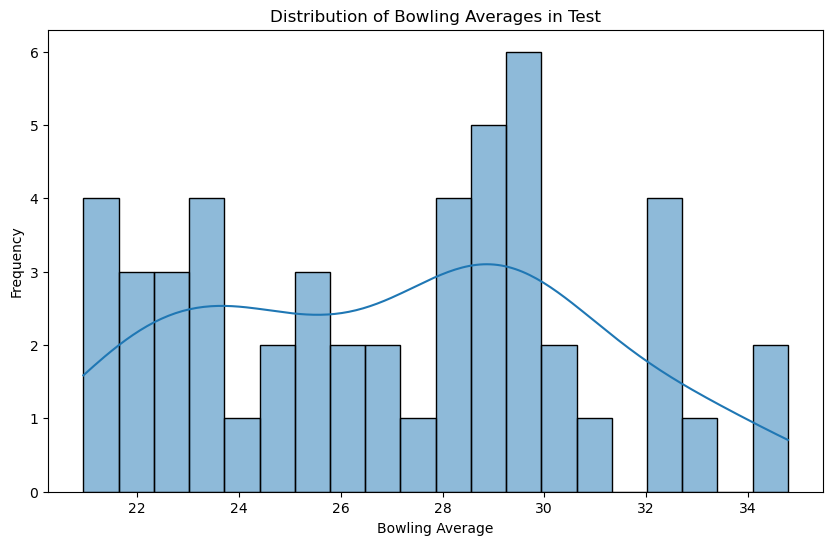

In [178]:
# bowling_data is your DataFrame
bowling_data = test_data_dup
bowling_data[['Ave', 'Wkts', 'SR', 'Econ']] = bowling_data[['Ave', 'Wkts', 'SR', 'Econ']].apply(pd.to_numeric, errors='coerce')

# 1. Distribution of Bowling Averages among Different Players
plt.figure(figsize=(10, 6))
sns.histplot(bowling_data['Ave'], bins=20, kde=True)
plt.title('Distribution of Bowling Averages in Test')
plt.xlabel('Bowling Average')
plt.ylabel('Frequency')
plt.show()

## 2. Average Number of Wickets for Bowlers with Bowling Averages below a Certain Threshold (25)

ODI

In [179]:
bowling_data = odi_data_dup
average_threshold = 25  # Set your threshold
below_threshold_data = bowling_data[bowling_data['Ave'] < average_threshold]
average_wickets_below_threshold = below_threshold_data['Wkts'].mean()
print(f"Average number of wickets for bowlers in ODI with average below {average_threshold}: {average_wickets_below_threshold:.2f}")


Average number of wickets for bowlers in ODI with average below 25: 7.85


T20

In [180]:
bowling_data = t20_data_dup
average_threshold = 25  # Set your threshold
below_threshold_data = bowling_data[bowling_data['Ave'] < average_threshold]
average_wickets_below_threshold = below_threshold_data['Wkts'].mean()
print(f"Average number of wickets for bowlers in T20 with average below {average_threshold}: {average_wickets_below_threshold:.2f}")


Average number of wickets for bowlers in T20 with average below 25: 5.39


Test

In [181]:
bowling_data = test_data_dup
average_threshold = 25  # Set your threshold
below_threshold_data = bowling_data[bowling_data['Ave'] < average_threshold]
average_wickets_below_threshold = below_threshold_data['Wkts'].mean()
print(f"Average number of wickets for bowlers in Test with average below {average_threshold}: {average_wickets_below_threshold:.2f}")


Average number of wickets for bowlers in Test with average below 25: 403.24


## 3.  Variation of Economy Rates Among Bowlers

ODI

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


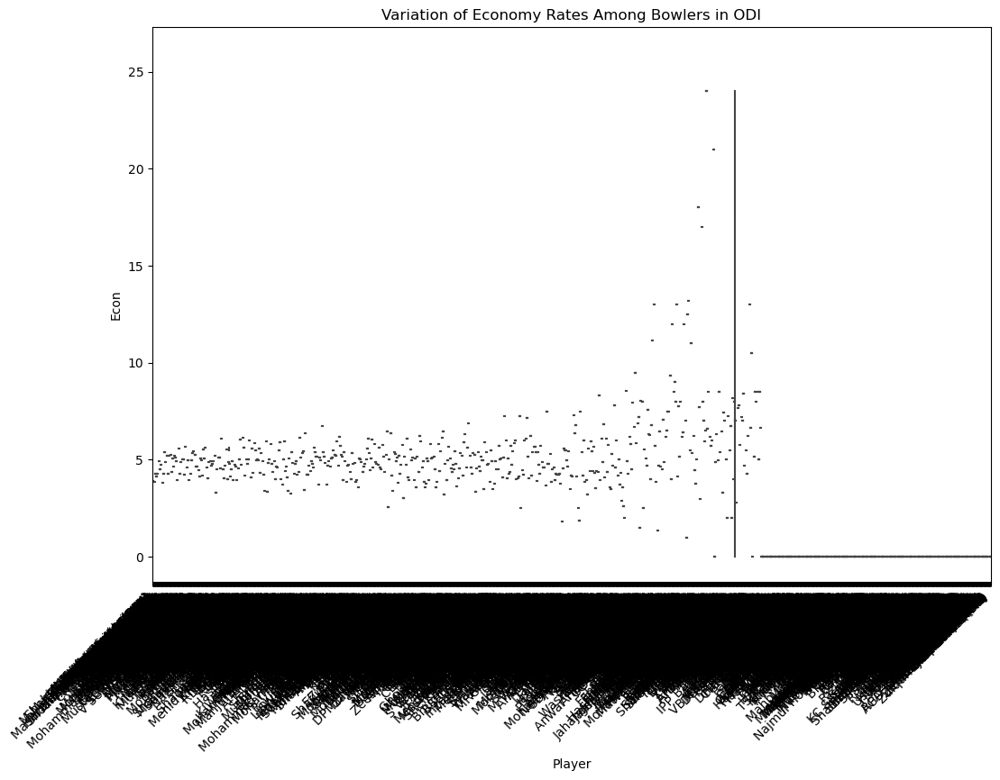

In [182]:
# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a box plot or violin plot for the distribution of economy rates
sns.boxplot(x='Player', y='Econ', data=odi_data_dup)
# Uncomment the line below if you want to use a violin plot instead
# sns.violinplot(x='Player', y='Econ', data=df)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Set plot title
plt.title('Variation of Economy Rates Among Bowlers in ODI')

# Show the plot
plt.show()

T20

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


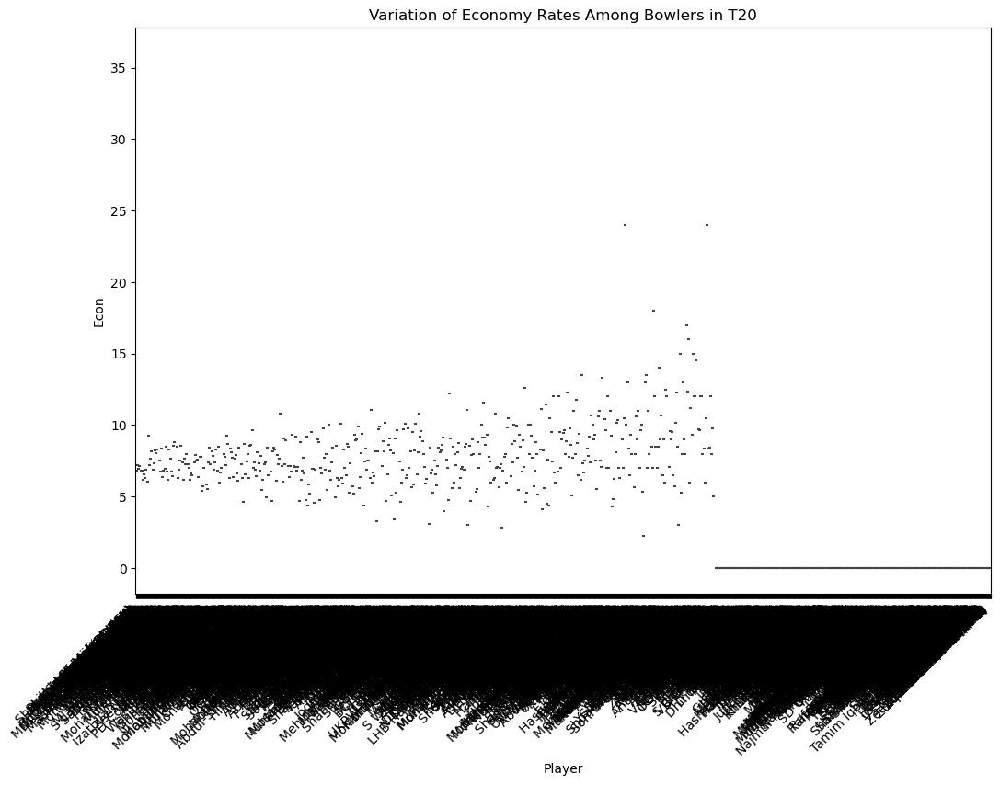

In [183]:
# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a box plot or violin plot for the distribution of economy rates
#sns.boxplot(x='Player', y='Econ', data=t20_data_dup)
# Uncomment the line below if you want to use a violin plot instead
sns.violinplot(x='Player', y='Econ', data=t20_data_dup)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Set plot title
plt.title('Variation of Economy Rates Among Bowlers in T20')

# Show the plot
plt.show()

Test

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


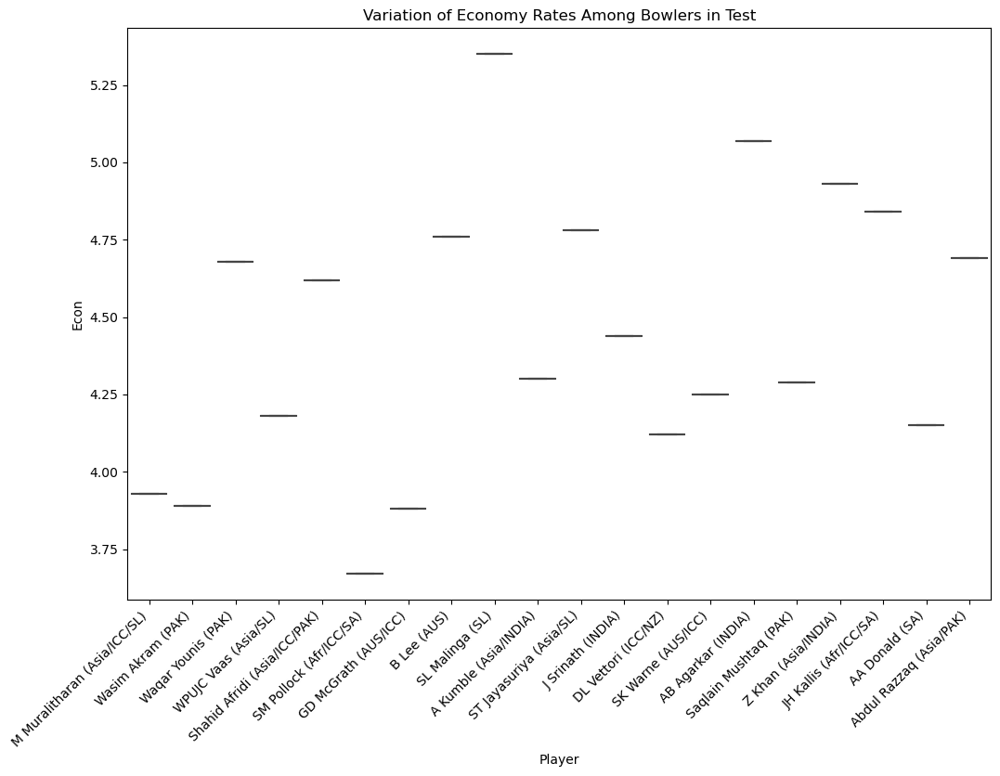

In [184]:
# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a box plot or violin plot for the distribution of economy rates
# Select the top 20 rows
top_20_bowlers = odi_data_dup.head(20)
sns.boxplot(x='Player', y='Econ', data=top_20_bowlers)
# Uncomment the line below if you want to use a violin plot instead
# sns.violinplot(x='Player', y='Econ', data=df)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Set plot title
plt.title('Variation of Economy Rates Among Bowlers in Test')

# Show the plot
plt.show()

## 4. Correlation between economy rate and the number of wickets taken

ODI

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


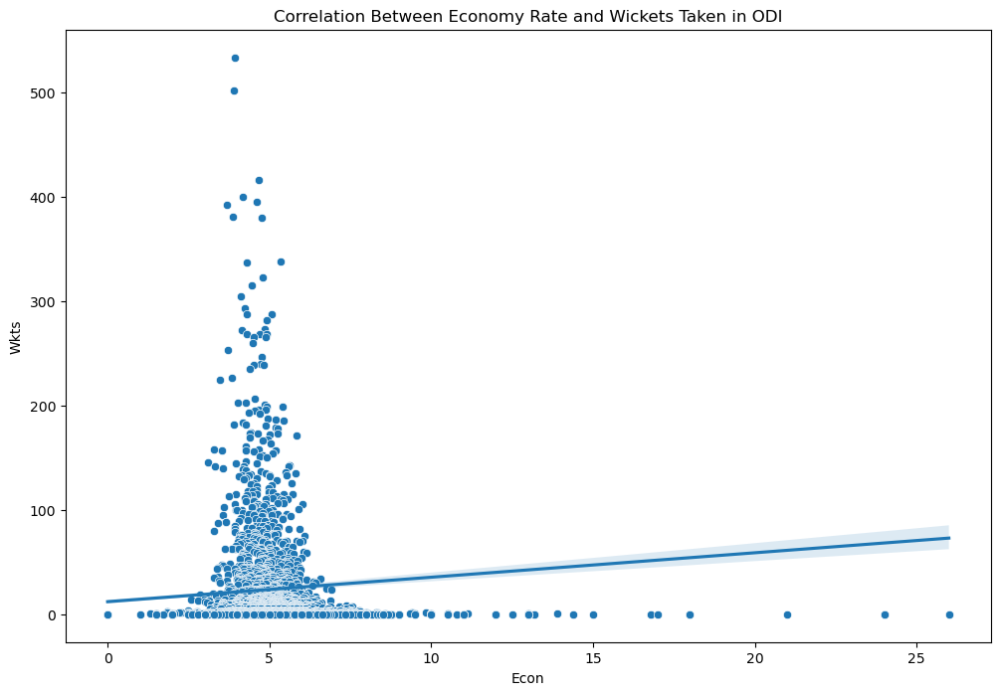

In [185]:
# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a scatter plot
sns.scatterplot(x='Econ', y='Wkts', data=odi_data_dup)

# Add a trendline (regression line)
sns.regplot(x='Econ', y='Wkts', data=odi_data_dup, scatter=False)

# Set plot title
plt.title('Correlation Between Economy Rate and Wickets Taken in ODI')

# Show the plot
plt.show()

T20

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


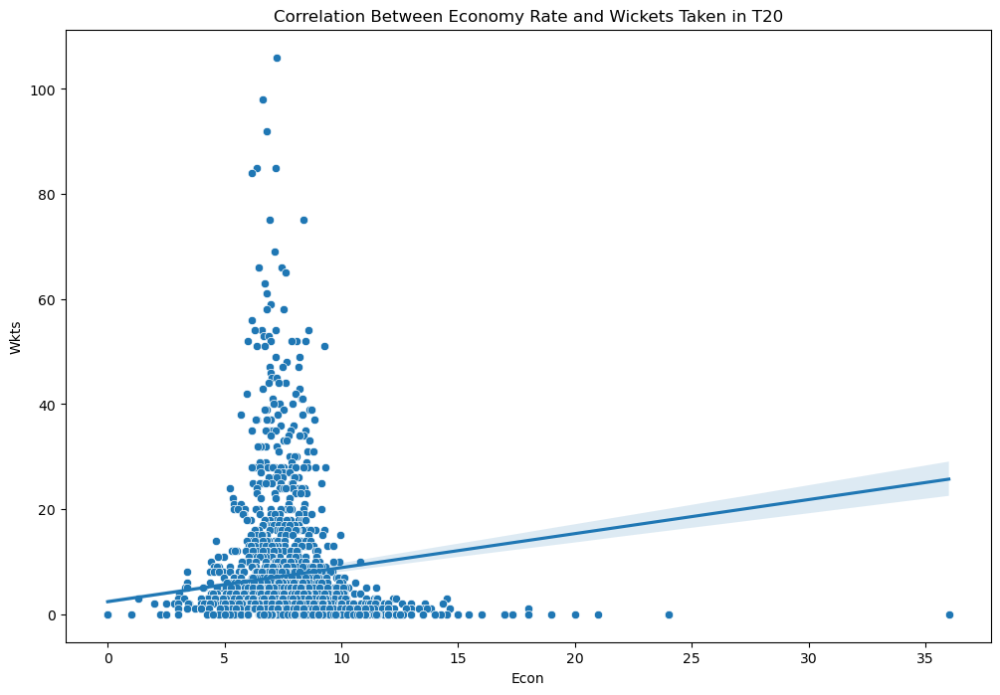

In [186]:
# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a scatter plot
sns.scatterplot(x='Econ', y='Wkts', data=t20_data_dup)

# Add a trendline (regression line)
sns.regplot(x='Econ', y='Wkts', data=t20_data_dup, scatter=False)

# Set plot title
plt.title('Correlation Between Economy Rate and Wickets Taken in T20')

# Show the plot
plt.show()

Test

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


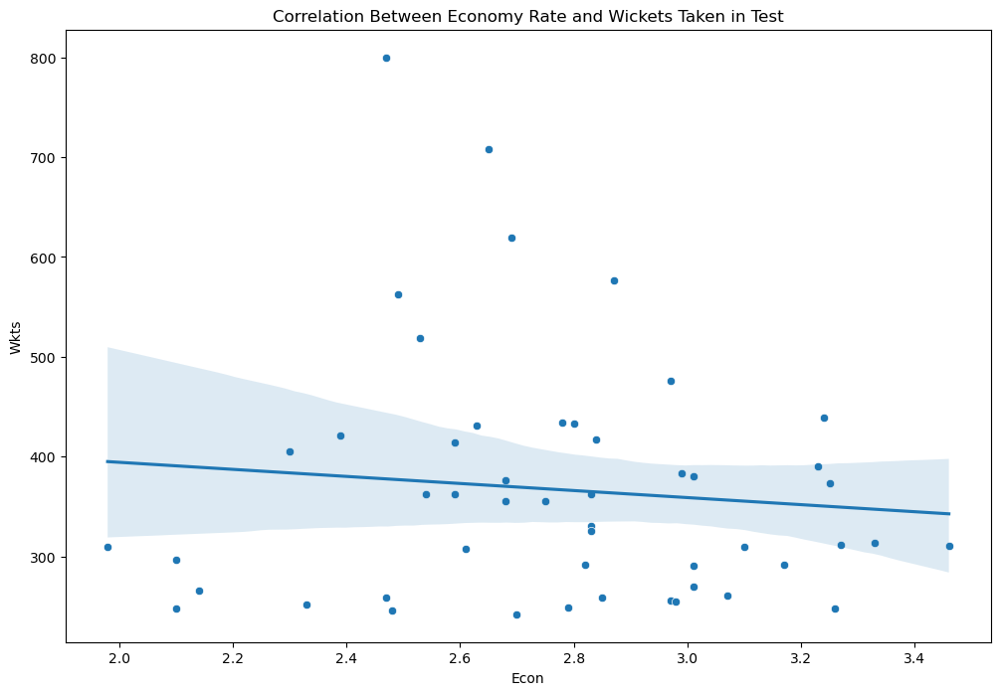

In [187]:
# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a scatter plot
sns.scatterplot(x='Econ', y='Wkts', data=test_data_dup)

# Add a trendline (regression line)
sns.regplot(x='Econ', y='Wkts', data=test_data_dup, scatter=False)

# Set plot title
plt.title('Correlation Between Economy Rate and Wickets Taken in Test')

# Show the plot
plt.show()

## 5. Distribution of Strike Rates

ODI

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


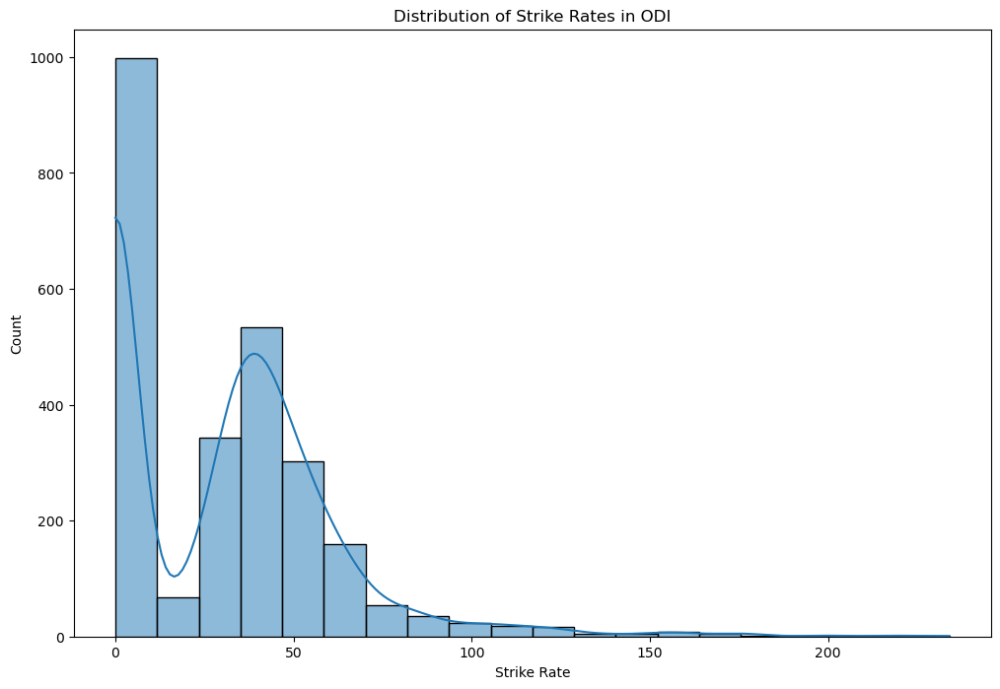

Typical strike rate for bowlers: 32.25


In [188]:
# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a histogram or kernel density plot for the distribution of strike rates
sns.histplot(odi_data_dup['SR'], kde=True, bins=20)  # You can adjust the number of bins for better visualization

# Set x-axis label
plt.xlabel('Strike Rate')

# Set plot title
plt.title('Distribution of Strike Rates in ODI')

# Show the plot
plt.show()

typical_strike_rate = odi_data_dup['SR'].median()
print(f"Typical strike rate for bowlers: {typical_strike_rate:.2f}")

T20

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


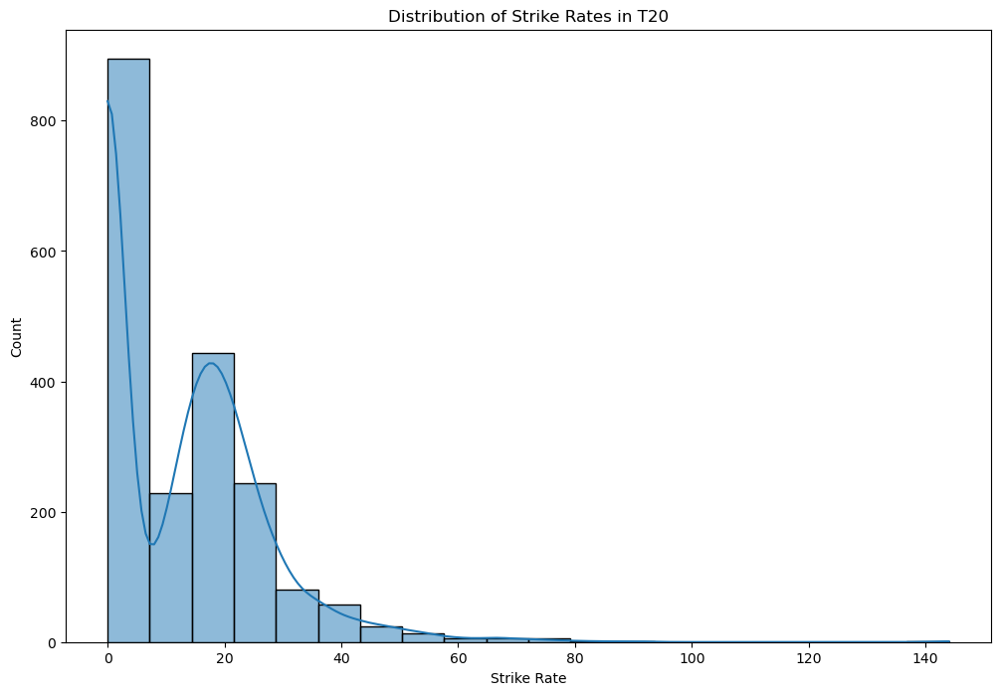

Typical strike rate for bowlers: 12.00


In [189]:
# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a histogram or kernel density plot for the distribution of strike rates
sns.histplot(t20_data_dup['SR'], kde=True, bins=20)  # You can adjust the number of bins for better visualization

# Set x-axis label
plt.xlabel('Strike Rate')

# Set plot title
plt.title('Distribution of Strike Rates in T20')

# Show the plot
plt.show()
typical_strike_rate = t20_data_dup['SR'].median()
print(f"Typical strike rate for bowlers: {typical_strike_rate:.2f}")

Test

C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\AppData\Roaming\Python\Python39\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


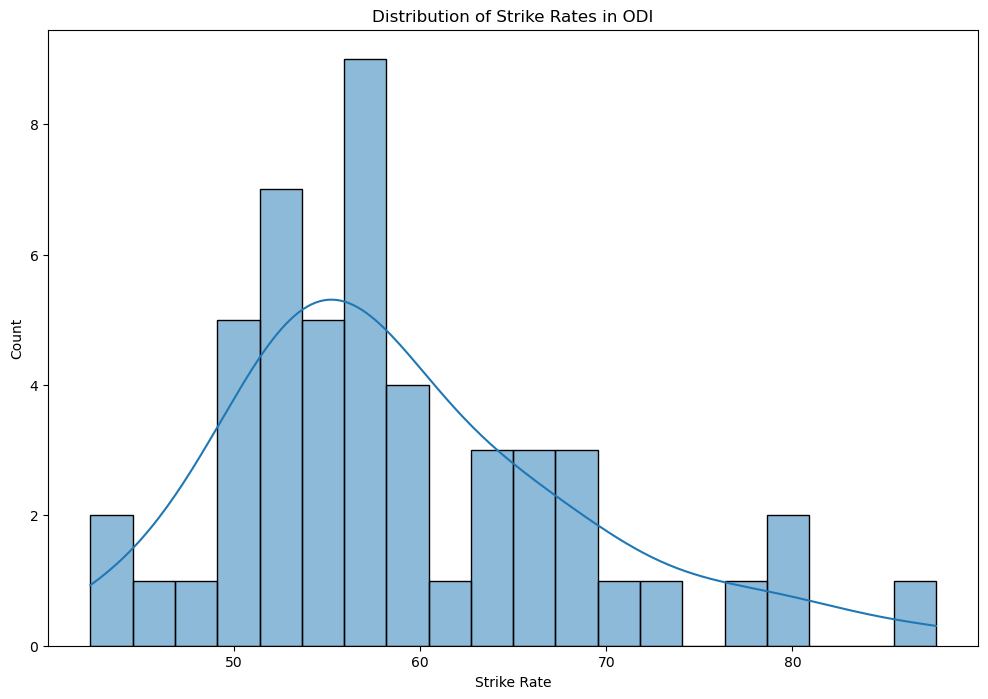

Typical strike rate for bowlers: 56.90


In [190]:
# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a histogram or kernel density plot for the distribution of strike rates
sns.histplot(test_data_dup['SR'], kde=True, bins=20)  # You can adjust the number of bins for better visualization

# Set x-axis label
plt.xlabel('Strike Rate')

# Set plot title
plt.title('Distribution of Strike Rates in ODI')

# Show the plot
plt.show()

typical_strike_rate = test_data_dup['SR'].median()
print(f"Typical strike rate for bowlers: {typical_strike_rate:.2f}")

## 6. Correlation Matrix between Wickets Taken and Strike Rate

ODI

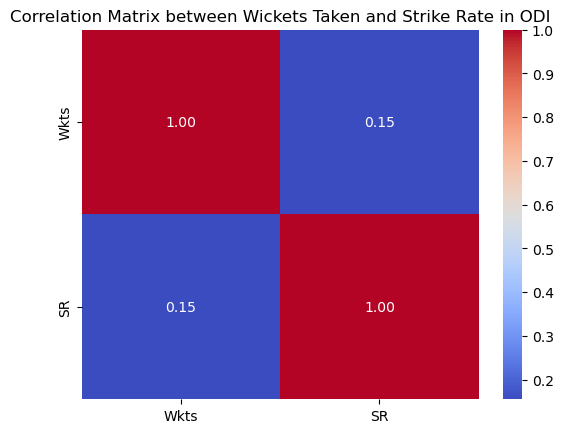

In [191]:
correlation_matrix_wickets_sr = odi_data_dup[['Wkts', 'SR']].corr()
sns.heatmap(correlation_matrix_wickets_sr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix between Wickets Taken and Strike Rate in ODI')
plt.show()

T20

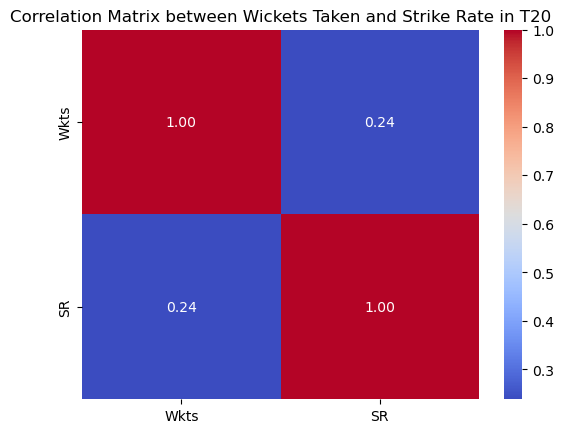

In [192]:
correlation_matrix_wickets_sr = t20_data_dup[['Wkts', 'SR']].corr()
sns.heatmap(correlation_matrix_wickets_sr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix between Wickets Taken and Strike Rate in T20')
plt.show()

Test

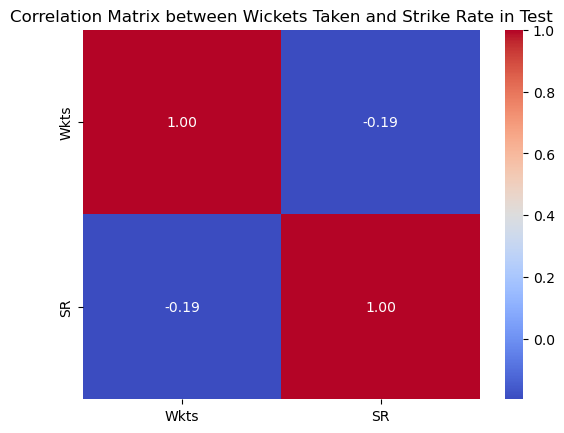

In [193]:
correlation_matrix_wickets_sr = test_data_dup[['Wkts', 'SR']].corr()
sns.heatmap(correlation_matrix_wickets_sr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix between Wickets Taken and Strike Rate in Test')
plt.show()

## 7. Best Bowling Performance and Match

ODI

In [194]:
# Assuming bowling_data is your DataFrame with columns 'Player', 'Wickets_BBI', 'Runs_BBI'

# Combine 'Wickets_BBI' and 'Runs_BBI' into a numeric value for comparison
bowling_data['BBI_numeric'] = odi_data_dup['Runs_BBI'].astype(float) / odi_data_dup['Wickets_BBI'].astype(float)

# Find the index of the row with the maximum 'BBI_numeric' value
best_bowling_index = bowling_data['BBI_numeric'].idxmax()

# Display the information about the best bowling performance
best_bowling_player = bowling_data.loc[best_bowling_index, 'Player']
best_bowling_match = bowling_data.loc[best_bowling_index, 'BBI_numeric']
print(f"The best bowling performance was by {best_bowling_player} in ODI with BBI {best_bowling_match}")

# Remove the temporary column 'BBI_numeric'
bowling_data = bowling_data.drop('BBI_numeric', axis=1)


The best bowling performance was by LR Gibbs (WI) in ODI with BBI 8.8


T20

In [195]:
bowling_data['BBI_numeric'] = t20_data_dup['Runs_BBI'].astype(float) / t20_data_dup['Wickets_BBI'].astype(float)

# Find the index of the row with the maximum 'BBI_numeric' value
best_bowling_index = bowling_data['BBI_numeric'].idxmax()

# Display the information about the best bowling performance
best_bowling_player = bowling_data.loc[best_bowling_index, 'Player']
best_bowling_match = bowling_data.loc[best_bowling_index, 'BBI_numeric']
print(f"The best bowling performance was by {best_bowling_player} in T20 with BBI {best_bowling_match}")

# Remove the temporary column 'BBI_numeric'
bowling_data = bowling_data.drop('BBI_numeric', axis=1)

The best bowling performance was by IT Botham (ENG) in T20 with BBI 11.25


Test

In [196]:
bowling_data['BBI_numeric'] = test_data_dup['Runs_BBI'].astype(float) / test_data_dup['Wickets_BBI'].astype(float)

# Find the index of the row with the maximum 'BBI_numeric' value
best_bowling_index = bowling_data['BBI_numeric'].idxmax()

# Display the information about the best bowling performance
best_bowling_player = bowling_data.loc[best_bowling_index, 'Player']
best_bowling_match = bowling_data.loc[best_bowling_index, 'BBI_numeric']
print(f"The best bowling performance was by {best_bowling_player} in test with BBI {best_bowling_match}")

# Remove the temporary column 'BBI_numeric'
bowling_data = bowling_data.drop('BBI_numeric', axis=1)

The best bowling performance was by Wasim Akram (PAK) in test with BBI 17.0


## 8. Frequency of Best Bowling Performances

ODI

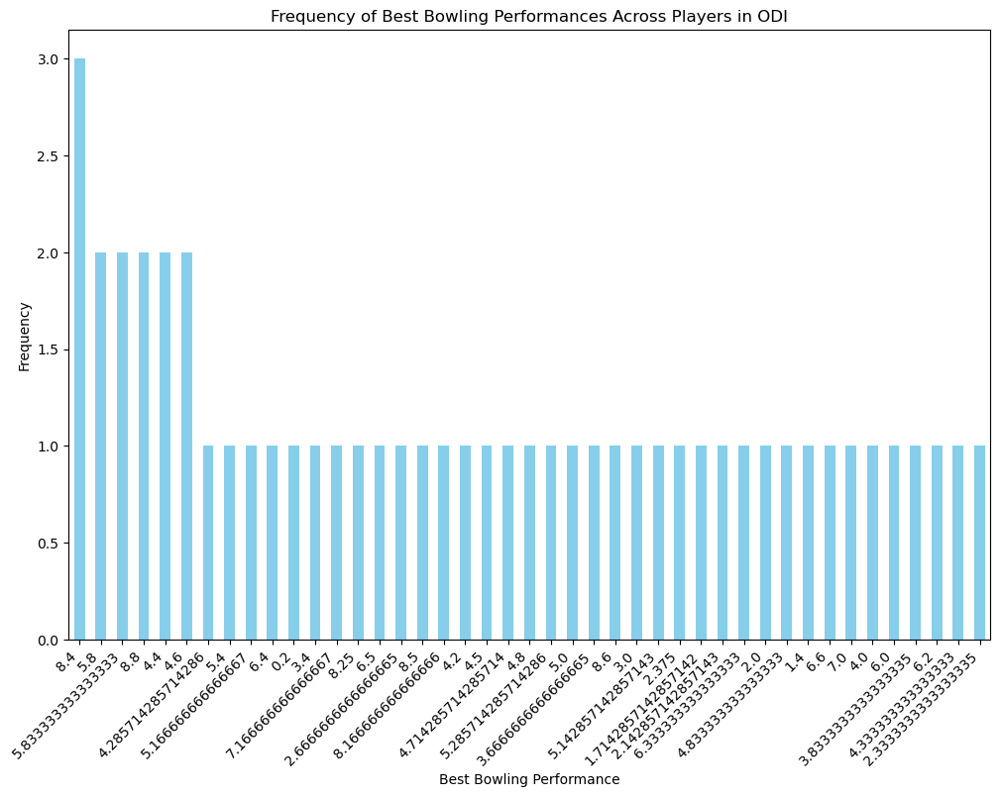

In [197]:
# Count the frequency of each unique best bowling performance
bowling_data['BBI'] = odi_data_dup['Runs_BBI'].astype(float) / odi_data_dup['Wickets_BBI'].astype(float)
best_bowling_counts = bowling_data['BBI'].value_counts()

# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a bar chart
best_bowling_counts.plot(kind='bar', color='skyblue')

# Set x-axis label
plt.xlabel('Best Bowling Performance')

# Set y-axis label
plt.ylabel('Frequency')

# Set plot title
plt.title('Frequency of Best Bowling Performances Across Players in ODI')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Show the plot
plt.show()

T20

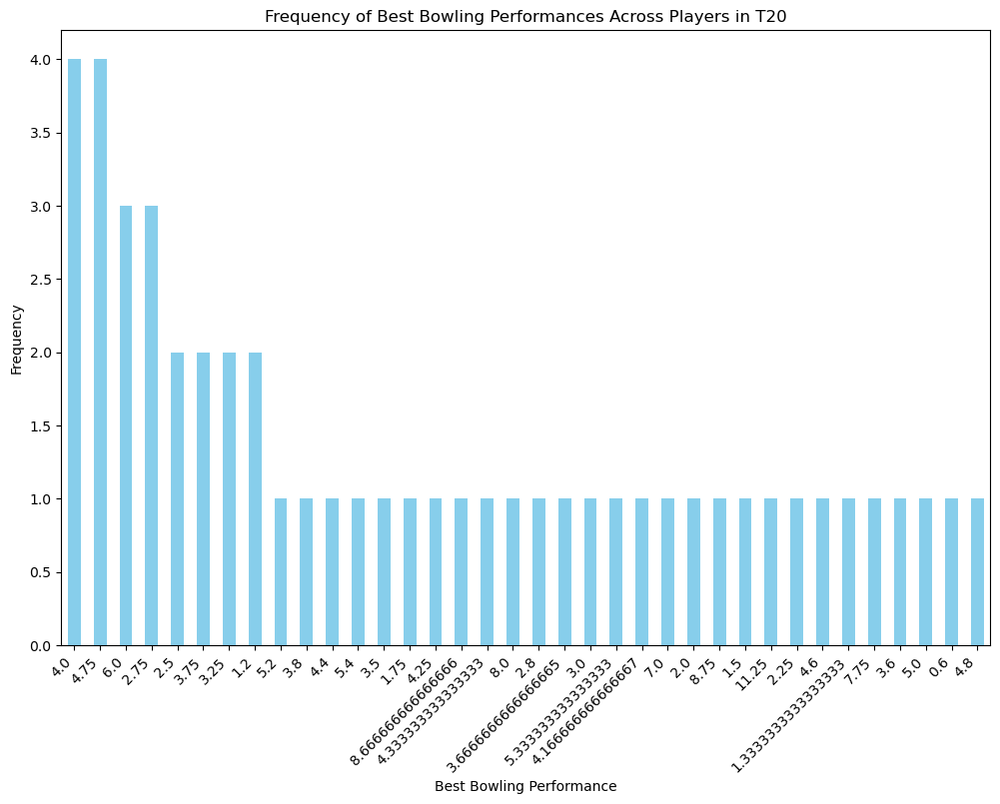

In [198]:
# Count the frequency of each unique best bowling performance
bowling_data['BBI'] = t20_data_dup['Runs_BBI'].astype(float) / t20_data_dup['Wickets_BBI'].astype(float)
best_bowling_counts = bowling_data['BBI'].value_counts()

# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a bar chart
best_bowling_counts.plot(kind='bar', color='skyblue')

# Set x-axis label
plt.xlabel('Best Bowling Performance')

# Set y-axis label
plt.ylabel('Frequency')

# Set plot title
plt.title('Frequency of Best Bowling Performances Across Players in T20')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Show the plot
plt.show()

Test

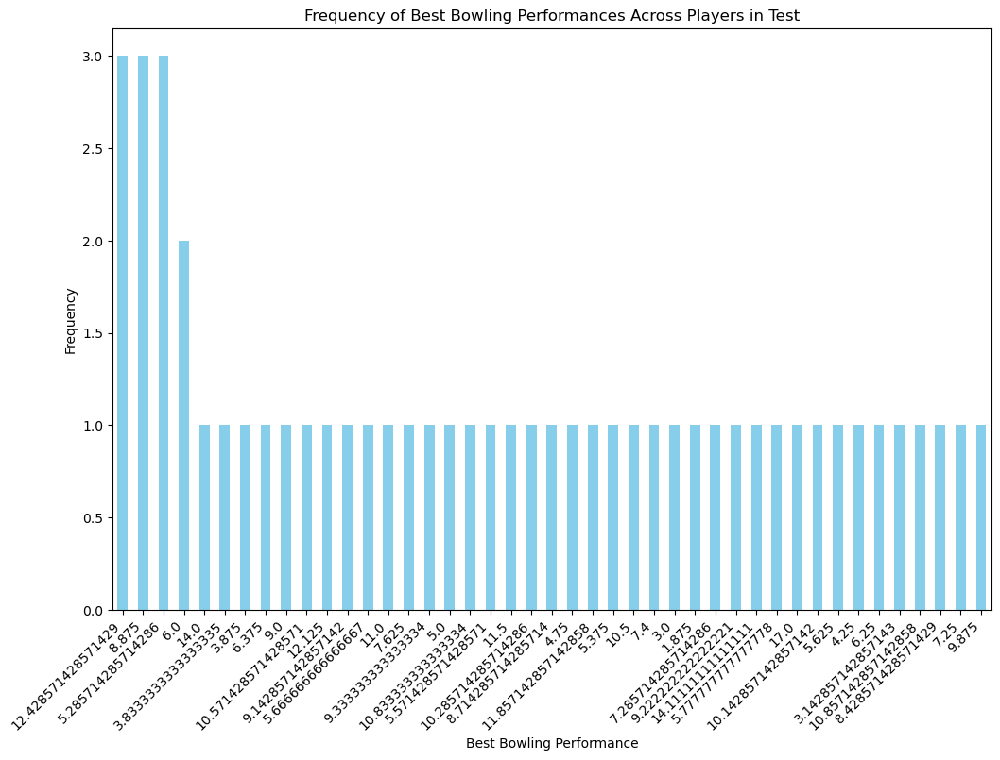

In [199]:
# Count the frequency of each unique best bowling performance
bowling_data['BBI'] = test_data_dup['Runs_BBI'].astype(float) / test_data_dup['Wickets_BBI'].astype(float)
best_bowling_counts = bowling_data['BBI'].value_counts()

# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a bar chart
best_bowling_counts.plot(kind='bar', color='skyblue')

# Set x-axis label
plt.xlabel('Best Bowling Performance')

# Set y-axis label
plt.ylabel('Frequency')

# Set plot title
plt.title('Frequency of Best Bowling Performances Across Players in Test')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Show the plot
plt.show()

## 9. Probability of a Player Taking a Specific Number of Wickets in an Inning

ODI

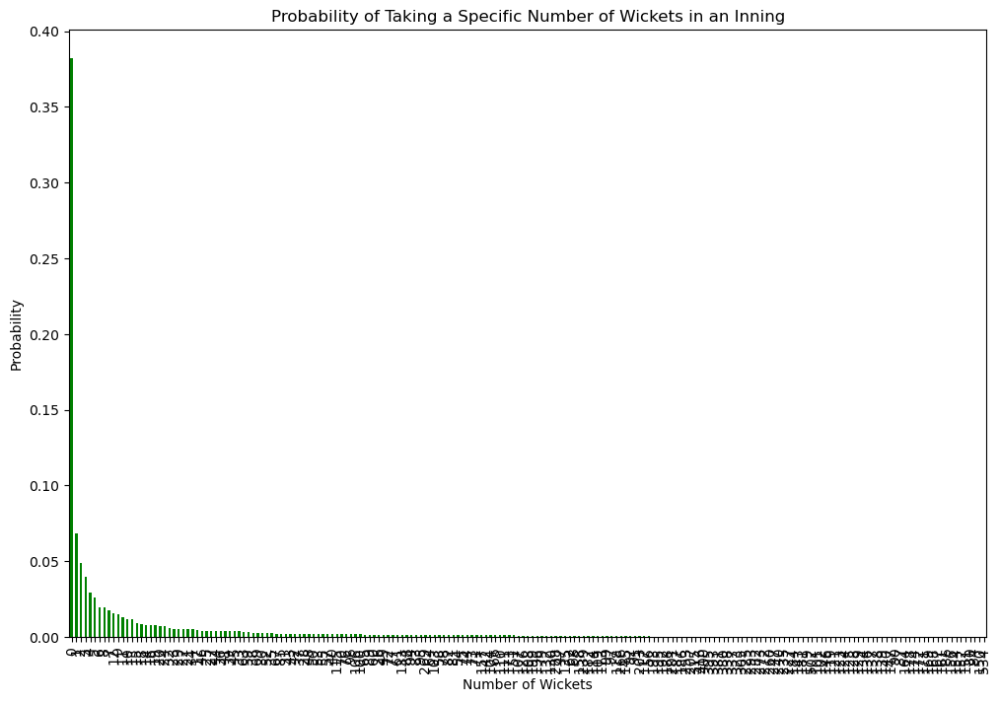

In [200]:
# Count the frequency of each unique number of wickets
wickets_counts = odi_data_dup['Wkts'].value_counts()

# Calculate the probability distribution
wickets_probabilities = wickets_counts / wickets_counts.sum()

# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a bar chart for the probability distribution of wickets
wickets_probabilities.plot(kind='bar', color='green')

# Set x-axis label
plt.xlabel('Number of Wickets')

# Set y-axis label
plt.ylabel('Probability')

# Set plot title
plt.title('Probability of Taking a Specific Number of Wickets in an Inning')

# Show the plot
plt.show()


T20

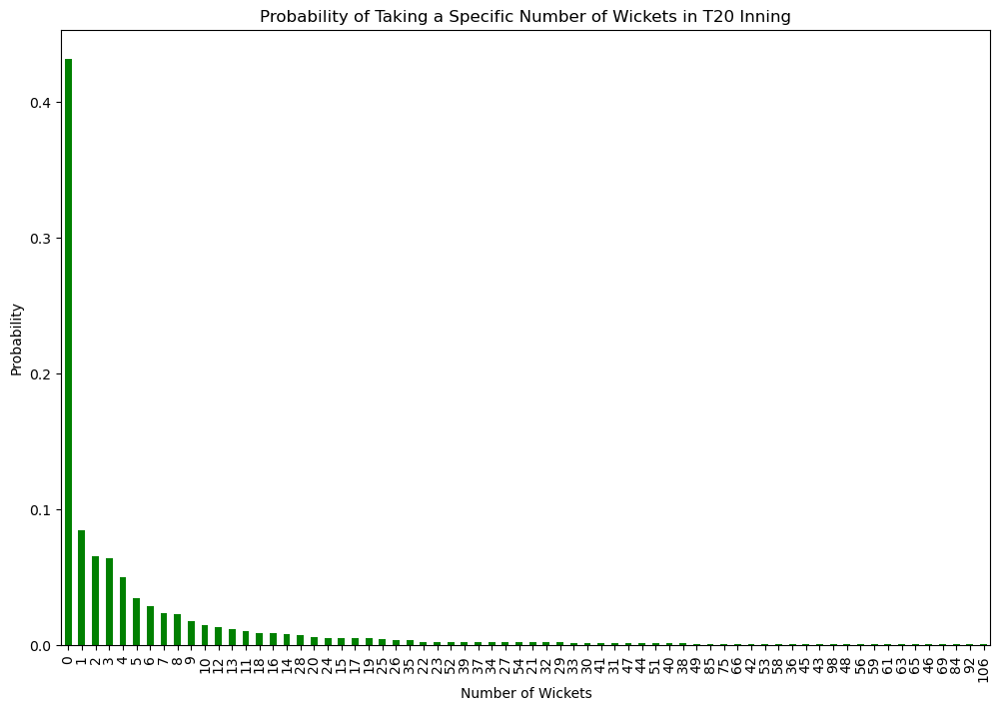

In [201]:

wickets_counts = t20_data_dup['Wkts'].value_counts()

# Calculate the probability distribution
wickets_probabilities = wickets_counts / wickets_counts.sum()

# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a bar chart for the probability distribution of wickets
wickets_probabilities.plot(kind='bar', color='green')

# Set x-axis label
plt.xlabel('Number of Wickets')

# Set y-axis label
plt.ylabel('Probability')

# Set plot title
plt.title('Probability of Taking a Specific Number of Wickets in T20 Inning')

# Show the plot
plt.show()


Test

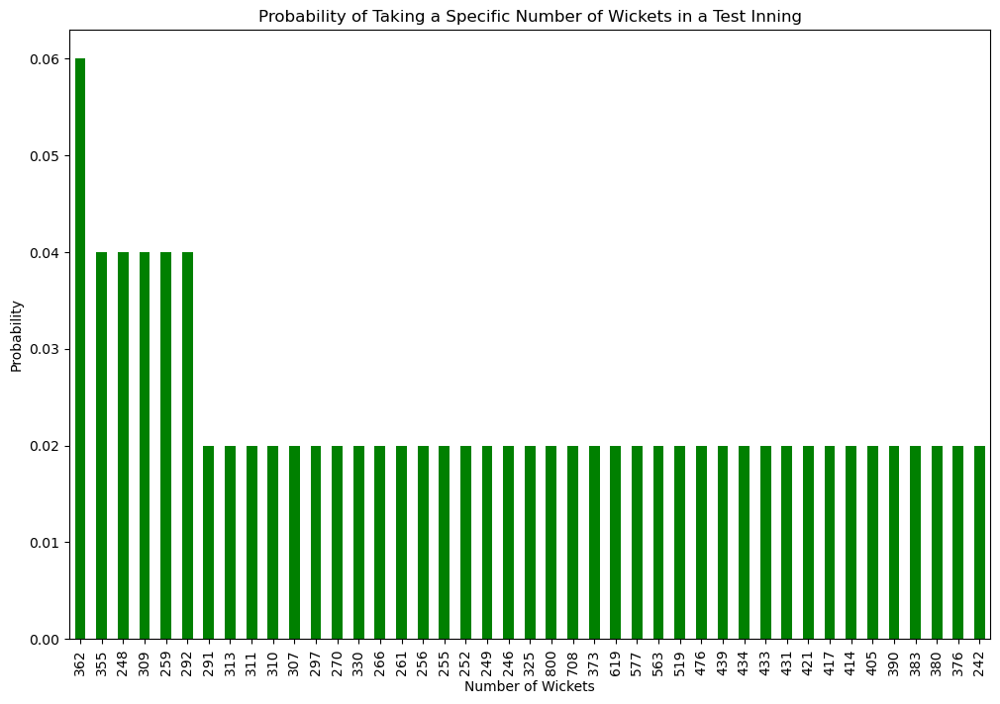

In [202]:


# Count the frequency of each unique number of wickets
wickets_counts = test_data_dup['Wkts'].value_counts()

# Calculate the probability distribution
wickets_probabilities = wickets_counts / wickets_counts.sum()

# Set the size of the plot
plt.figure(figsize=(12, 8))

# Create a bar chart for the probability distribution of wickets
wickets_probabilities.plot(kind='bar', color='green')

# Set x-axis label
plt.xlabel('Number of Wickets')

# Set y-axis label
plt.ylabel('Probability')

# Set plot title
plt.title('Probability of Taking a Specific Number of Wickets in a Test Inning')

# Show the plot
plt.show()


## 10. Probability of Having a Bowling Average Below a Threshold

ODI

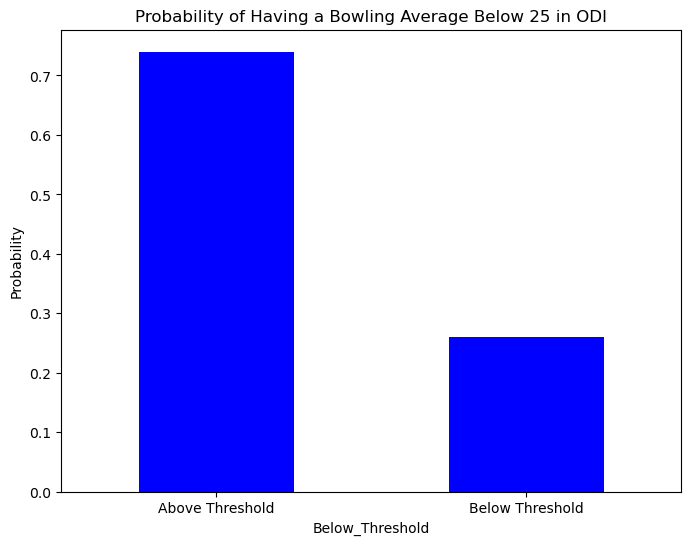

In [203]:


# Set the threshold for the bowling average
threshold = 25  # Adjust the threshold as needed

# Create a binary column indicating whether the bowling average is below the threshold
bowling_data['Below_Threshold'] = (odi_data_dup['Ave'] < threshold).astype(int)

# Calculate the probability distribution
average_probabilities = bowling_data['Below_Threshold'].value_counts(normalize=True)

# Set the size of the plot
plt.figure(figsize=(8, 6))

# Create a bar chart for the probability distribution of having a bowling average below the threshold
average_probabilities.plot(kind='bar', color='blue', rot=0)

# Set x-axis labels
plt.xticks([0, 1], ['Above Threshold', 'Below Threshold'])

# Set y-axis label
plt.ylabel('Probability')

# Set plot title
plt.title(f'Probability of Having a Bowling Average Below {threshold} in ODI')

# Show the plot
plt.show()


T20

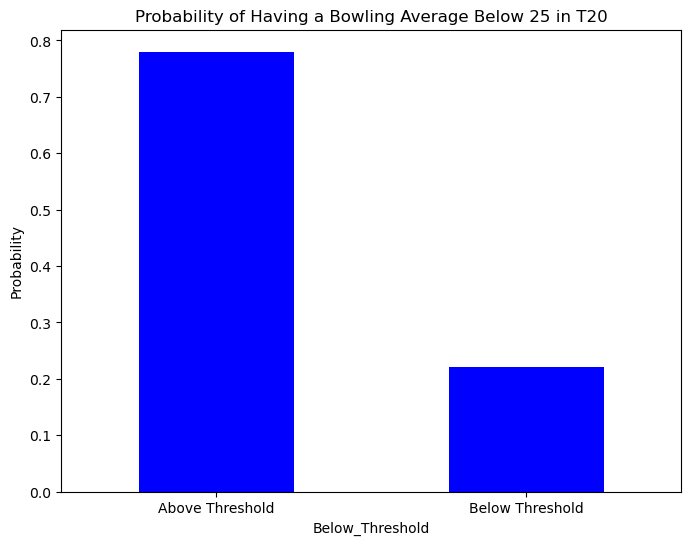

In [204]:


# Set the threshold for the bowling average
threshold = 25  # Adjust the threshold as needed

# Create a binary column indicating whether the bowling average is below the threshold
bowling_data['Below_Threshold'] = (t20_data_dup['Ave'] < threshold).astype(int)

# Calculate the probability distribution
average_probabilities = bowling_data['Below_Threshold'].value_counts(normalize=True)

# Set the size of the plot
plt.figure(figsize=(8, 6))

# Create a bar chart for the probability distribution of having a bowling average below the threshold
average_probabilities.plot(kind='bar', color='blue', rot=0)

# Set x-axis labels
plt.xticks([0, 1], ['Above Threshold', 'Below Threshold'])

# Set y-axis label
plt.ylabel('Probability')

# Set plot title
plt.title(f'Probability of Having a Bowling Average Below {threshold} in T20')

# Show the plot
plt.show()


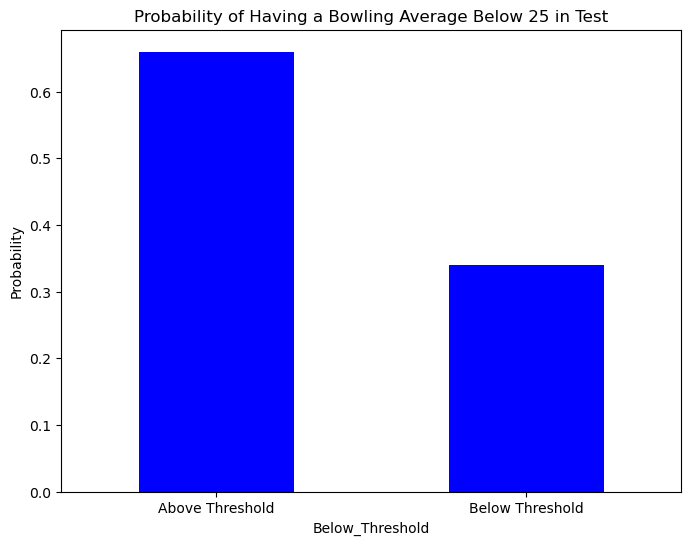

In [205]:


# Set the threshold for the bowling average
threshold = 25  # Adjust the threshold as needed

# Create a binary column indicating whether the bowling average is below the threshold
bowling_data['Below_Threshold'] = (test_data_dup['Ave'] < threshold).astype(int)

# Calculate the probability distribution
average_probabilities = bowling_data['Below_Threshold'].value_counts(normalize=True)

# Set the size of the plot
plt.figure(figsize=(8, 6))

# Create a bar chart for the probability distribution of having a bowling average below the threshold
average_probabilities.plot(kind='bar', color='blue', rot=0)

# Set x-axis labels
plt.xticks([0, 1], ['Above Threshold', 'Below Threshold'])

# Set y-axis label
plt.ylabel('Probability')

# Set plot title
plt.title(f'Probability of Having a Bowling Average Below {threshold} in Test')

# Show the plot
plt.show()


# Batting and Fielding Dataset

**Load Cricket Data**

In [1]:
import pandas as pd;


from google.colab import files
uploaded = files.upload()

Saving Fielding_ODI.csv to Fielding_ODI.csv
Saving Fielding_t20.csv to Fielding_t20.csv
Saving Fielding_test.csv to Fielding_test.csv
Saving ODI data.csv to ODI data.csv
Saving t20.csv to t20.csv
Saving test.csv to test.csv


In [5]:
# Create an empty dictionary to store DataFrames
import io
data_frames = {}

# Read each file into a DataFrame and store it in the dictionary
for file_name, content in uploaded.items():
    data_frames[file_name] = pd.read_csv(io.StringIO(content.decode('utf-8')))

In [6]:
print(data_frames.keys())

dict_keys(['Fielding_ODI.csv', 'Fielding_t20.csv', 'Fielding_test.csv', 'ODI data.csv', 't20.csv', 'test.csv'])


In [7]:
# load data set

odi_data = data_frames['ODI data.csv']
t20_data = data_frames['t20.csv']
test_data = data_frames['test.csv']
fielding_odi_data = data_frames['Fielding_ODI.csv']
fielding_t20_data = data_frames['Fielding_t20.csv']
fielding_test_data = data_frames['Fielding_test.csv']

**Analysis Of Batting Data Set**

Data Cleaning

Perform EDA

In [9]:
# Display basic information about the datasets
print("ODI Data:")
print(t20_data.info())

print("\nT20 Data:")
print(t20_data.info())

print("\nTest Data:")
print(test_data.info())

# Display summary statistics for each format
print("\nSummary Statistics for ODI:")
print(odi_data.describe())

print("\nSummary Statistics for T20:")
print(t20_data.describe())

print("\nSummary Statistics for Test:")
print(test_data.describe())


ODI Data:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2006 entries, 0 to 2005
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Unnamed: 0   2006 non-null   int64  
 1   Player       2006 non-null   object 
 2   Span         2006 non-null   object 
 3   Mat          2006 non-null   int64  
 4   Inns         2006 non-null   int64  
 5   NO           2006 non-null   int64  
 6   Runs         2006 non-null   int64  
 7   HS           1342 non-null   float64
 8   Ave          2006 non-null   float64
 9   BF           2006 non-null   int64  
 10  SR           2006 non-null   float64
 11  100          2006 non-null   int64  
 12  50           2006 non-null   int64  
 13  0            2006 non-null   int64  
 14  4s           2006 non-null   int64  
 15  6s           2006 non-null   int64  
 16  Unnamed: 15  0 non-null      float64
dtypes: float64(4), int64(11), object(2)
memory usage: 266.5+ KB
None

T20 Data:
<cla

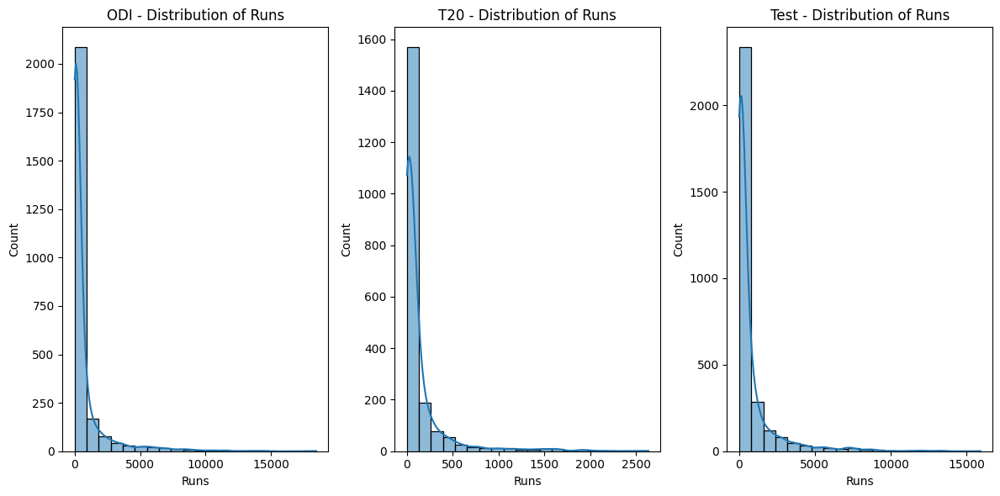

In [12]:
import matplotlib.pyplot as plt
import seaborn as sns

# Visualize the distribution of Runs in each format
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
sns.histplot(odi_data['Runs'], bins=20, kde=True)
plt.title('ODI - Distribution of Runs')

plt.subplot(1, 3, 2)
sns.histplot(t20_data['Runs'], bins=20, kde=True)
plt.title('T20 - Distribution of Runs')

plt.subplot(1, 3, 3)
sns.histplot(test_data['Runs'], bins=20, kde=True)
plt.title('Test - Distribution of Runs')

plt.tight_layout()
plt.show()



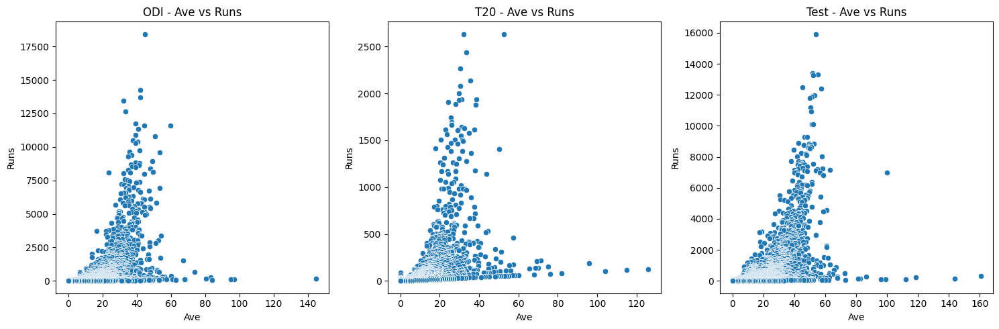

In [13]:
# Analyze the relationship between Batting Average (Ave) and Runs using a scatter plot
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
sns.scatterplot(x='Ave', y='Runs', data=odi_data)
plt.title('ODI - Ave vs Runs')

plt.subplot(1, 3, 2)
sns.scatterplot(x='Ave', y='Runs', data=t20_data)
plt.title('T20 - Ave vs Runs')

plt.subplot(1, 3, 3)
sns.scatterplot(x='Ave', y='Runs', data=test_data)
plt.title('Test - Ave vs Runs')

plt.tight_layout()
plt.show()

In [69]:
# Data Cleaning

# Clean numeric data
# ODI Data
numeric_columns = ['Runs', 'HS', 'Ave', 'BF', 'SR', '100', '50', '0','Mat','Inns','NO']

odi_data[numeric_columns] = odi_data[numeric_columns].replace('-', 0) # replace - with 0 in data
odi_data[numeric_columns] = odi_data[numeric_columns].replace('*', '') # remove * from data
odi_data[numeric_columns] = odi_data[numeric_columns].apply(pd.to_numeric, errors='coerce') # convert it to numeric form

# Test Data
numeric_columns = ['Runs', 'HS', 'Ave', '100', '50', '0','Mat','Inns','NO']
test_data[numeric_columns] = test_data[numeric_columns].replace('-', 0) # replace - with 0 in data
test_data[numeric_columns] = test_data[numeric_columns].replace('*', '') # remove * from data
test_data[numeric_columns] = test_data[numeric_columns].apply(pd.to_numeric, errors='coerce') # convert it to numeric form

# T20 Data
numeric_columns = ['Runs', 'HS', 'Ave', 'BF', 'SR', '100', '50', '0','Mat','Inns','NO','4s','6s']

t20_data[numeric_columns] = t20_data[numeric_columns].replace('-', 0) # replace - with 0 in data
t20_data[numeric_columns] = t20_data[numeric_columns].replace('', '') # remove * from data
t20_data[numeric_columns] = t20_data[numeric_columns].apply(pd.to_numeric, errors='coerce') # convert it to numeric form


In [14]:
# Drop the Unnamed Column as it have no data

odi_data.drop('Unnamed: 0', axis=1, inplace=True)
odi_data.drop('Unnamed: 13', axis=1, inplace=True)
t20_data.drop('Unnamed: 15', axis=1, inplace=True)
test_data.drop('Unnamed: 11', axis=1, inplace=True)

In [16]:
import numpy as np

# Visualize missing values

features_with_na_odi=[features for features in odi_data.columns if odi_data[features].isnull().sum()>1]

for feature in features_with_na_odi:
    print(feature, np.round(odi_data[feature].isnull().mean(), 2),  ' % missing values')

features_with_na_t20=[features for features in t20_data.columns if t20_data[features].isnull().sum()>1]

for feature in features_with_na_odi:
    print(feature, np.round(t20_data[feature].isnull().mean(), 2),  ' % missing values')

features_with_na_test=[features for features in test_data.columns if test_data[features].isnull().sum()>1]

for feature in features_with_na_odi:
    print(feature, np.round(test_data[feature].isnull().mean(), 2),  ' % missing values')



HS 0.31  % missing values
HS 0.33  % missing values
HS 0.22  % missing values


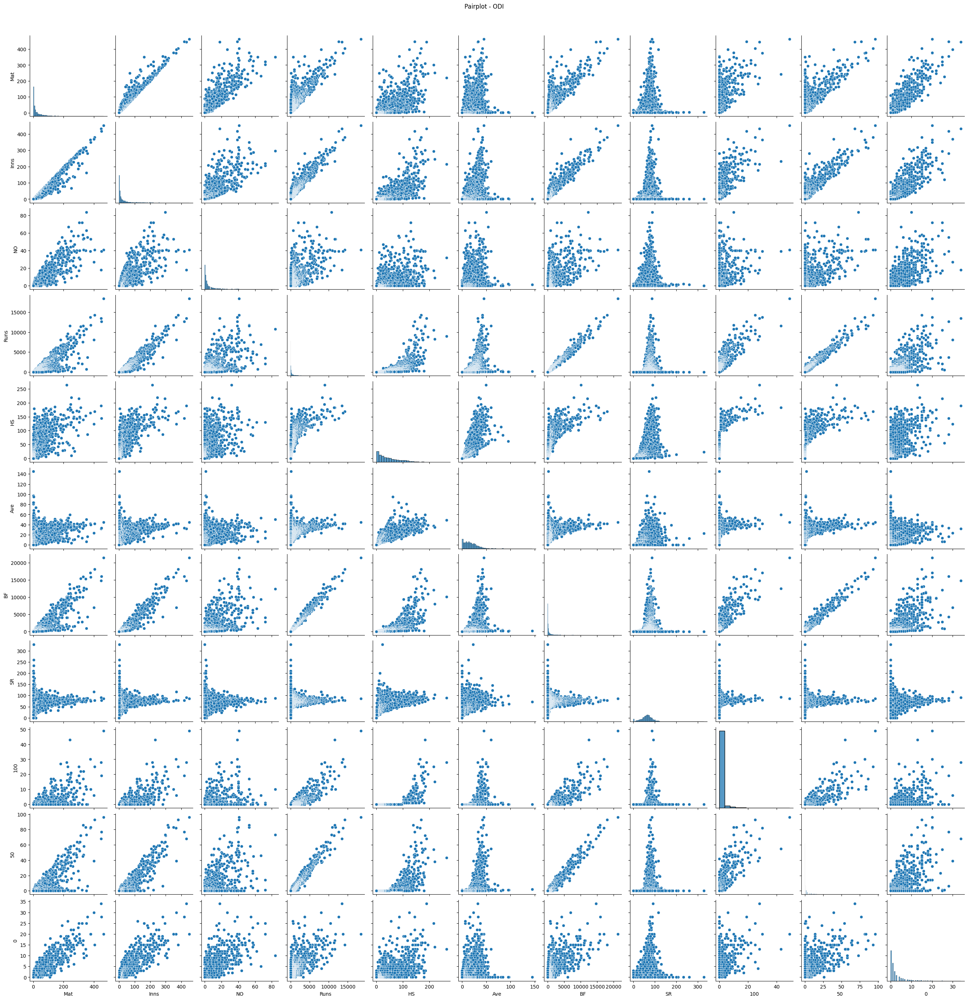

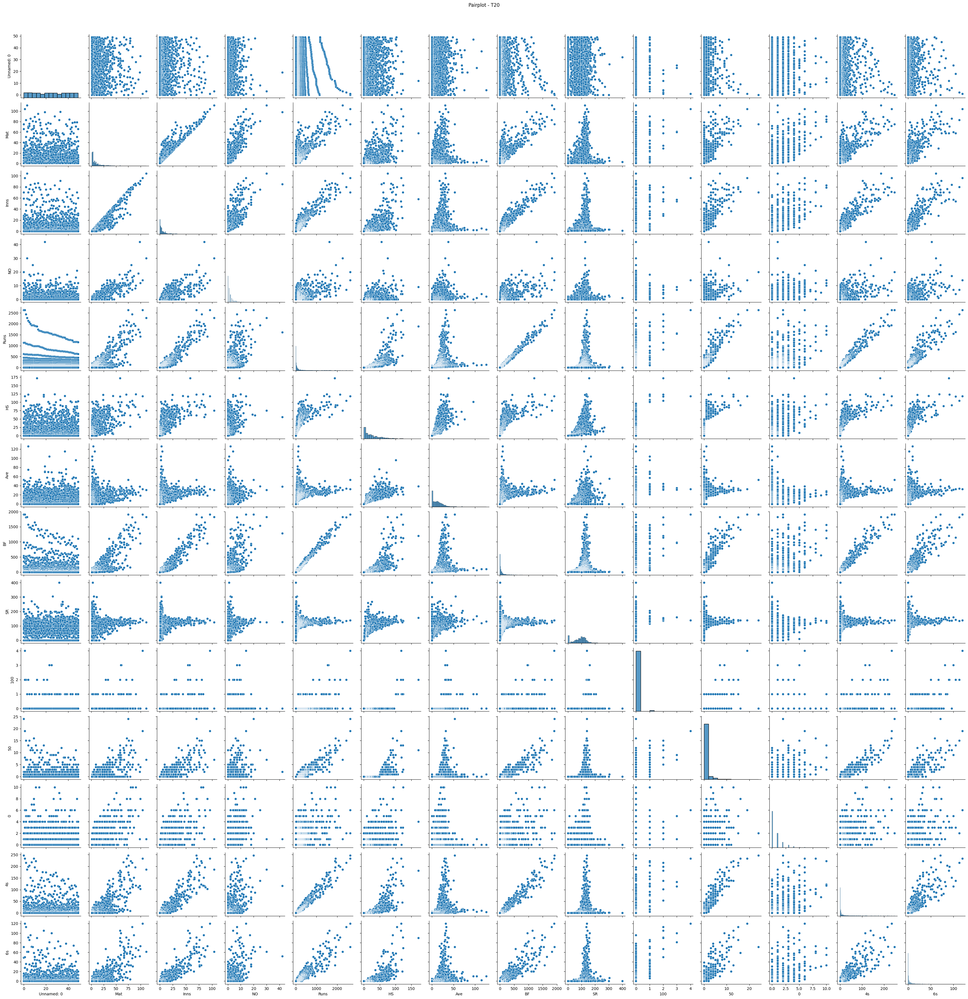

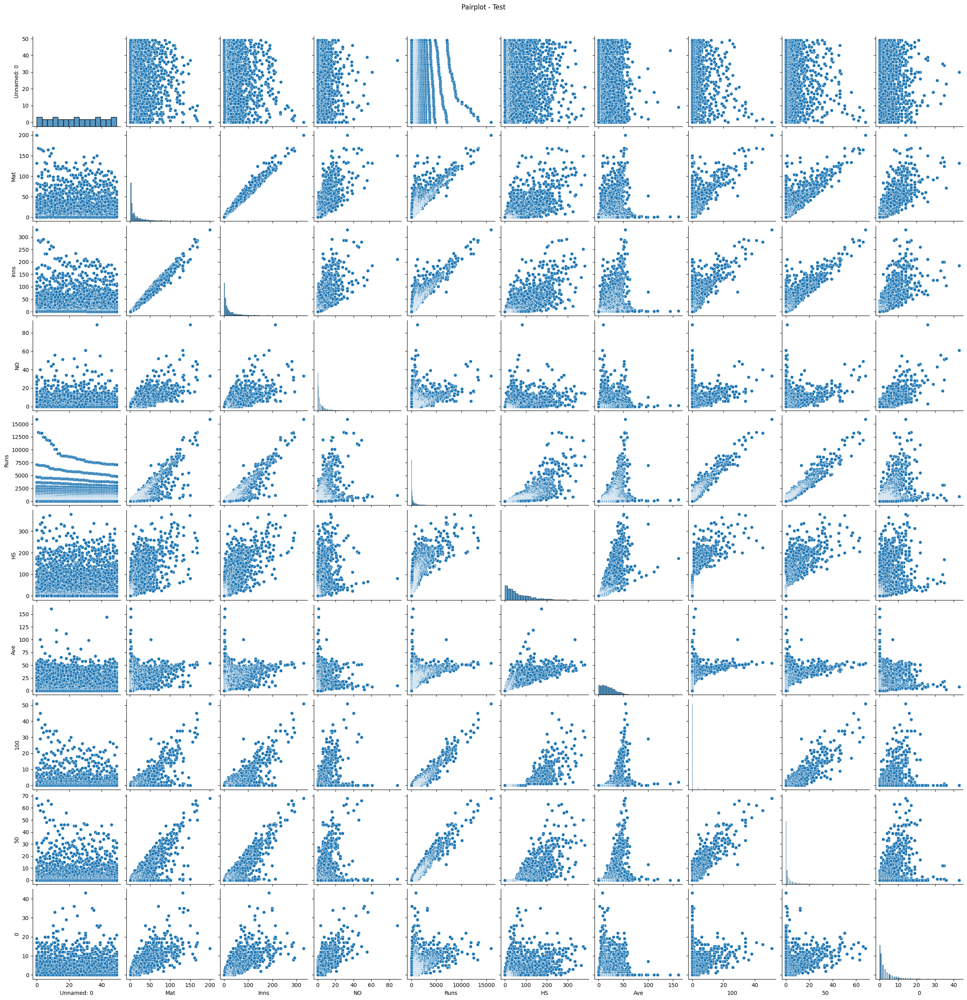

In [17]:
# Explore relationships among numerical variables using seaborn pairplot
numerical_cols_odi = [feature for feature in odi_data.columns if odi_data[feature].dtypes != 'O']
numerical_cols_t20 = [feature for feature in t20_data.columns if t20_data[feature].dtypes != 'O']
numerical_cols_test = [feature for feature in test_data.columns if test_data[feature].dtypes != 'O']

# ODI
sns.pairplot(odi_data[numerical_cols_odi])
plt.suptitle('Pairplot - ODI', y=1.02)
plt.show()

# T20
sns.pairplot(t20_data[numerical_cols_t20])
plt.suptitle('Pairplot - T20', y=1.02)
plt.show()

# Test
sns.pairplot(test_data[numerical_cols_test])
plt.suptitle('Pairplot - Test', y=1.02)
plt.show()

Solve Questions Related to Batting Data

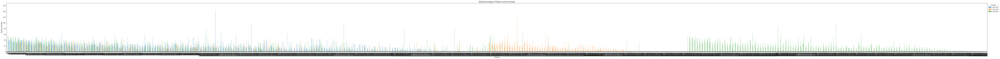

In [18]:
# What is the distribution of batting averages among different players?
import pandas as pd
import matplotlib.pyplot as plt

# Extract batting averages from each format
odi_averages = odi_data[['Player', 'Ave']]
t20_averages = t20_data[['Player', 'Ave']]
test_averages = test_data[['Player', 'Ave']]

# Merge the averages from all formats
all_averages = pd.merge(odi_averages, t20_averages, on='Player', how='outer')
all_averages = pd.merge(all_averages, test_averages, on='Player', how='outer')

# Rename columns for clarity
all_averages.columns = ['Player', 'Ave_ODI', 'Ave_T20', 'Ave_Test']

# Convert the 'Ave' columns to numeric type (coerce non-numeric values to NaN)
all_averages[['Ave_ODI', 'Ave_T20', 'Ave_Test']] = all_averages[['Ave_ODI', 'Ave_T20', 'Ave_Test']].apply(pd.to_numeric, errors='coerce')

# Fill NaN values with 0
all_averages = all_averages.fillna(0)

all_averages.plot(kind='bar', figsize=(100, 6), rot=45)
plt.title('Batting Averages of Players across Formats')
plt.xlabel('Players')
plt.ylabel('Batting Average')
plt.legend(title='Format', loc='upper left', bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.xticks(rotation=90)
plt.show()

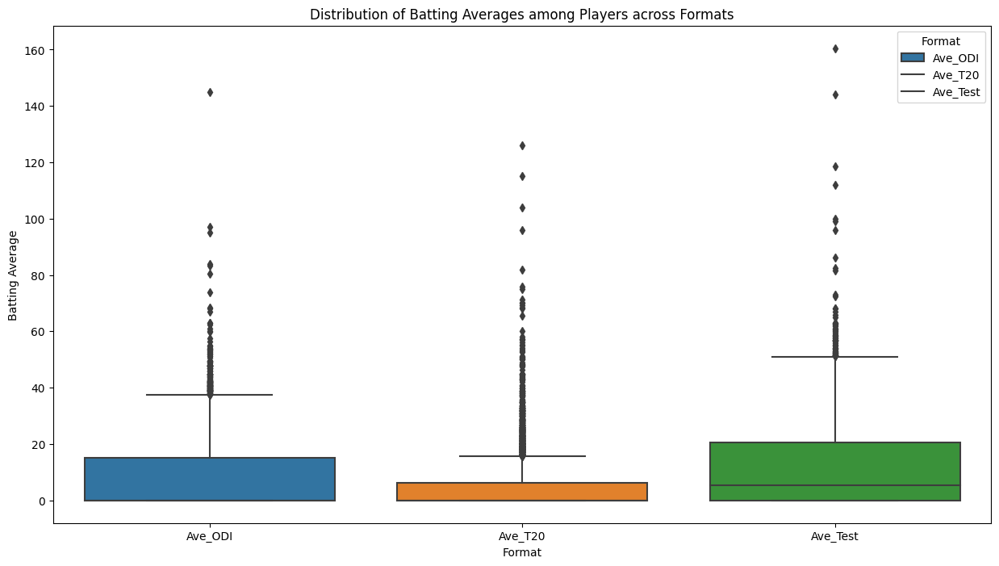

In [19]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the DataFrames

# Extract batting averages from each format
odi_averages = odi_data[['Player', 'Ave']]
t20_averages = t20_data[['Player', 'Ave']]
test_averages = test_data[['Player', 'Ave']]

# Merge the averages from all formats
all_averages = pd.merge(odi_averages, t20_averages, on='Player', how='outer')
all_averages = pd.merge(all_averages, test_averages, on='Player', how='outer')

# Rename columns for clarity
all_averages.columns = ['Player', 'Ave_ODI', 'Ave_T20', 'Ave_Test']

# Convert the 'Ave' columns to numeric type (coerce non-numeric values to NaN)
all_averages[['Ave_ODI', 'Ave_T20', 'Ave_Test']] = all_averages[['Ave_ODI', 'Ave_T20', 'Ave_Test']].apply(pd.to_numeric, errors='coerce')

# Fill NaN values with 0
all_averages = all_averages.fillna(0)

# Melt the DataFrame for seaborn box plot
melted_data = pd.melt(all_averages, id_vars=['Player'], value_vars=['Ave_ODI', 'Ave_T20', 'Ave_Test'], var_name='Format', value_name='Batting Average')

# Visualization (box plot)
plt.figure(figsize=(15, 8))
sns.boxplot(x='Format', y='Batting Average', data=melted_data)
plt.title('Distribution of Batting Averages among Players across Formats')
plt.legend(title='Format', loc='upper right', labels=melted_data['Format'].unique())
plt.show()

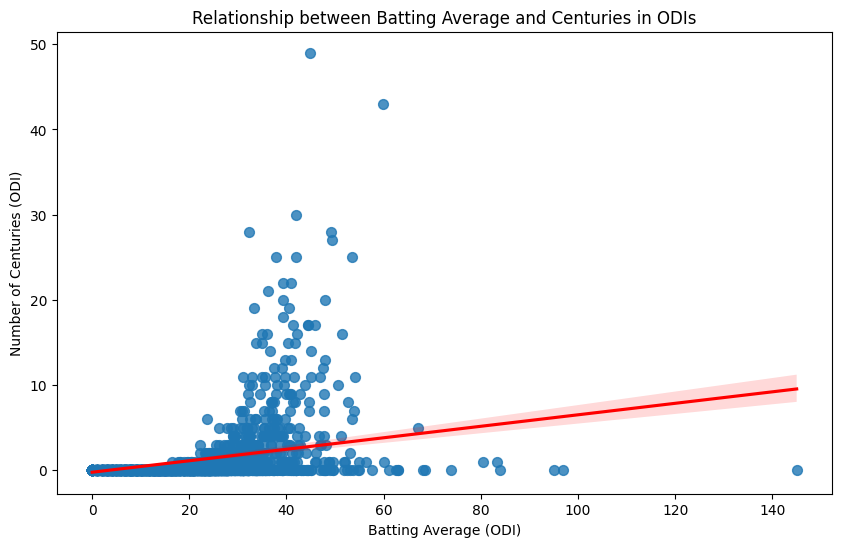

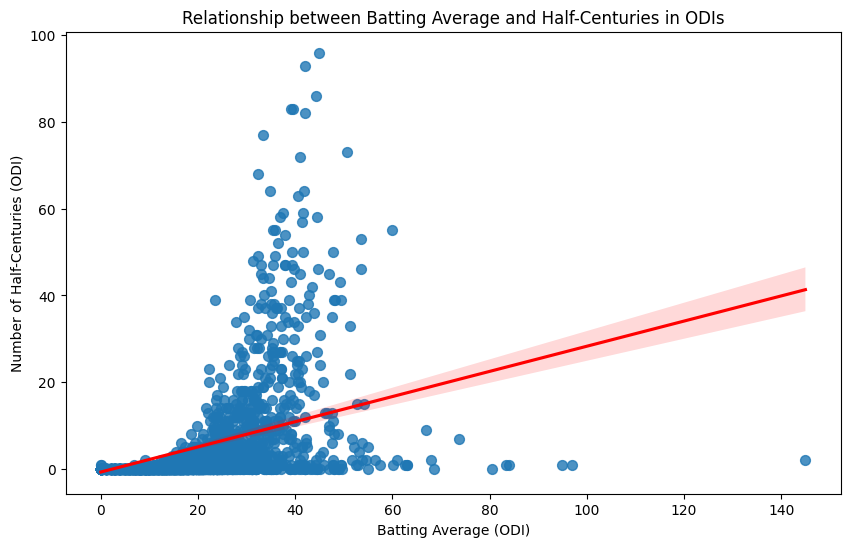

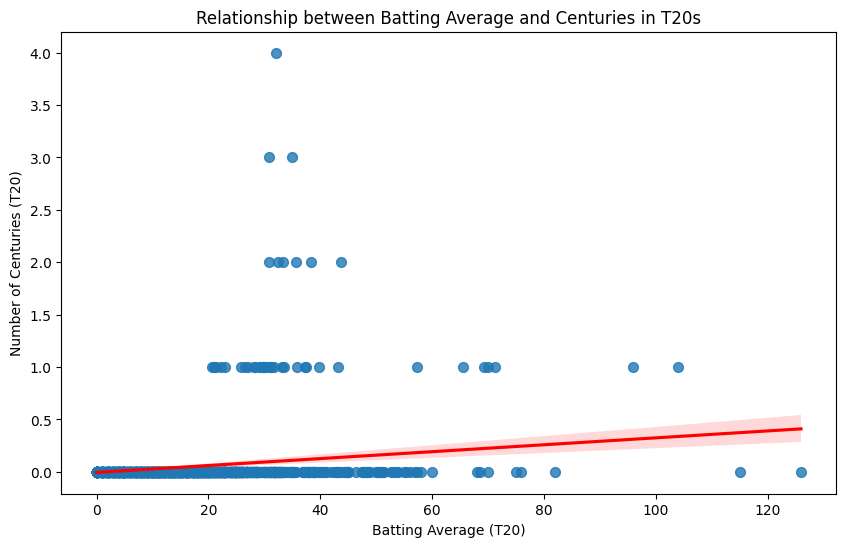

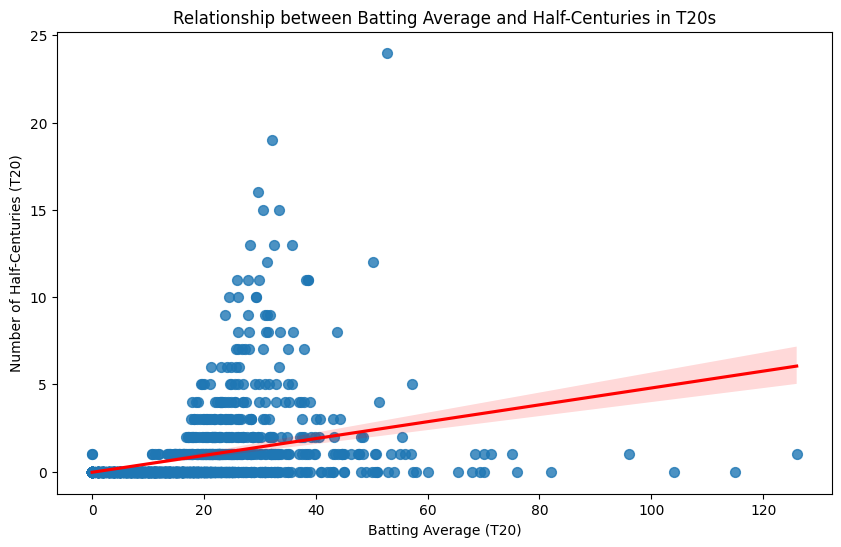

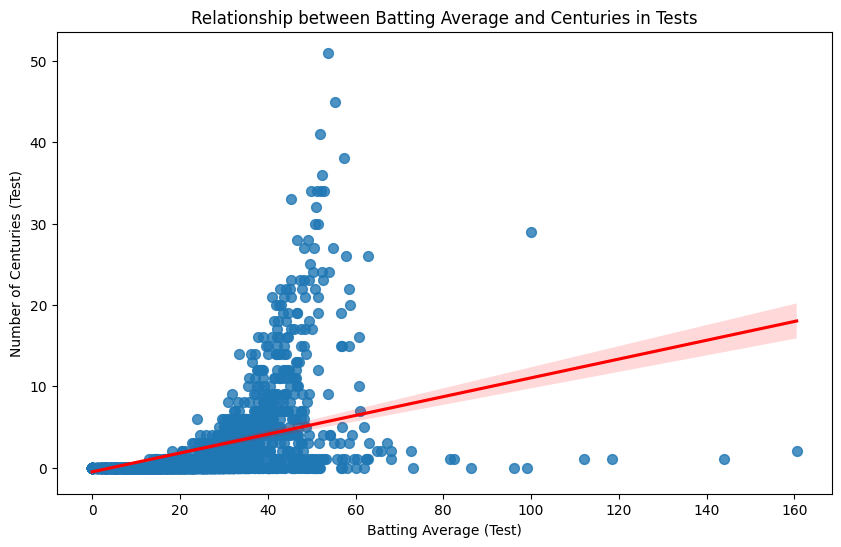

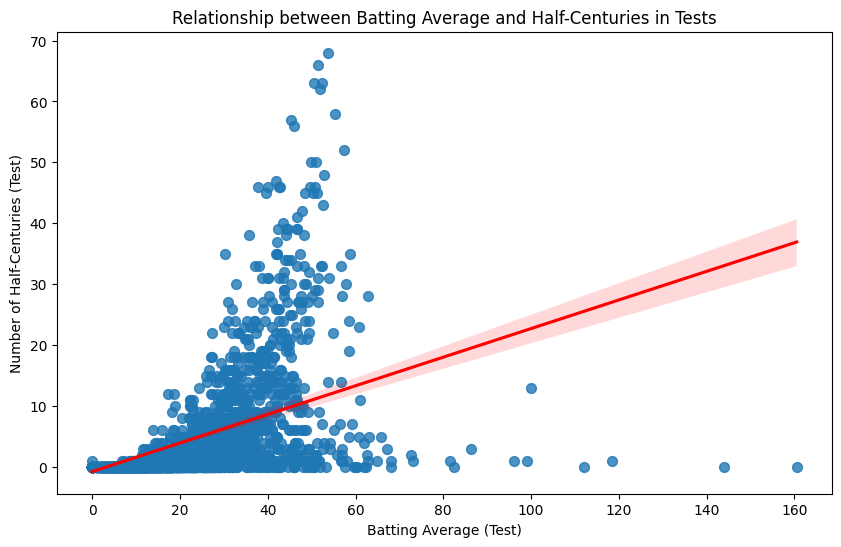

In [20]:
# What is the relationship between batting average and the number of centuries or half-centuries scored?


import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Extract batting averages from each format
odi_averages = odi_data[['Player', 'Ave', '100', '50']]
t20_averages = t20_data[['Player', 'Ave', '100', '50']]
test_averages = test_data[['Player', 'Ave', '100', '50']]

# Merge the averages from all formats
all_averages = pd.merge(odi_averages, t20_averages, on='Player', how='outer')
all_averages = pd.merge(all_averages, test_averages, on='Player', how='outer')

# Rename columns for clarity
all_averages.columns = ['Player', 'Ave_ODI', '100_ODI', '50_ODI', 'Ave_T20', '100_T20', '50_T20', 'Ave_Test', '100_Test', '50_Test']
all_averages = all_averages.fillna(0)

# Convert columns to numeric (in case they are not already)
numeric_columns = ['Ave_ODI', '100_ODI', '50_ODI', 'Ave_T20', '100_T20', '50_T20', 'Ave_Test', '100_Test', '50_Test']
all_averages[numeric_columns] = all_averages[numeric_columns].apply(pd.to_numeric, errors='coerce')

# Plotting individual relationships
for format in ['ODI', 'T20', 'Test']:
    plt.figure(figsize=(10, 6))

    # Scatter plot with regression line for centuries
    sns.regplot(x=f'Ave_{format}', y=f'100_{format}', data=all_averages, scatter_kws={'s': 50}, line_kws={'color': 'red'})
    plt.title(f'Relationship between Batting Average and Centuries in {format}s')
    plt.xlabel(f'Batting Average ({format})')
    plt.ylabel(f'Number of Centuries ({format})')
    plt.show()

    # Scatter plot with regression line for half-centuries
    plt.figure(figsize=(10, 6))
    sns.regplot(x=f'Ave_{format}', y=f'50_{format}', data=all_averages, scatter_kws={'s': 50}, line_kws={'color': 'red'})
    plt.title(f'Relationship between Batting Average and Half-Centuries in {format}s')
    plt.xlabel(f'Batting Average ({format})')
    plt.ylabel(f'Number of Half-Centuries ({format})')
    plt.show()

In [21]:
# How do the strike rates vary among different batsmen?

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have loaded the DataFrames odi_data, t20_data, and test_data

# Extract batting averages from each format
odi_averages = odi_data[['Player', 'SR']]
t20_averages = t20_data[['Player', 'SR']]

# Merge the averages from all formats
all_averages = pd.merge(odi_averages, t20_averages, on='Player', how='outer')

# Find the maximum strike rate for each player across ODI and T20
all_averages['Max_SR'] = all_averages[['SR_x', 'SR_y']].max(axis=1)

# Rename columns for clarity
all_averages.columns = ['Player', 'SR_ODI','SR_T20', 'Max_SR']
all_averages = all_averages.fillna(0)

# Convert columns to numeric (in case they are not already)
numeric_columns = [ 'SR_ODI','SR_T20', 'Max_SR']
all_averages[numeric_columns] = all_averages[numeric_columns].apply(pd.to_numeric, errors='coerce')


# Plotting with a violin plot
plt.figure(figsize=(100, 80))
sns.swarmplot(x='Player', y='Max_SR', data=all_averages, palette='Set3')
plt.title('Distribution of ODI Strike Rates Among Batsmen')
plt.xlabel('Batsman')
plt.ylabel('Strike Rate')
plt.xticks(rotation=90)
plt.show()


<ipython-input-21-5be86794330b>:30: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x='Player', y='Max_SR', data=all_averages, palette='Set3')
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:3544: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


<ipython-input-22-5ede229638ce>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  odi_averages[numeric_columns_odi] = odi_averages[numeric_columns_odi].apply(pd.to_numeric, errors='coerce')
<ipython-input-22-5ede229638ce>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  t20_averages[numeric_columns_t20] = t20_averages[numeric_columns_t20].apply(pd.to_numeric, errors='coerce')
<ipython-input-22-5ede229638ce>:32: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x='Playe

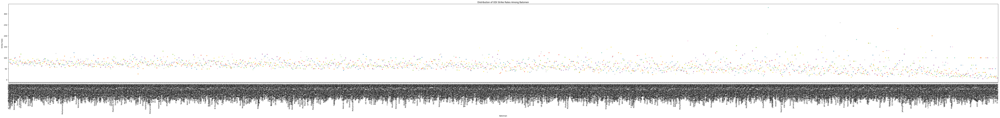

<ipython-input-22-5ede229638ce>:41: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x='Player', y='Strike Rate', data=melted_data_t20, palette='Set3')


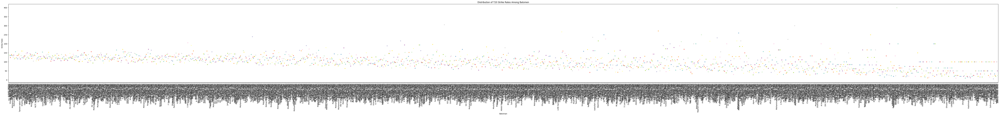

In [22]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Extract batting averages from each format
odi_averages = odi_data[['Player', 'SR']]
t20_averages = t20_data[['Player', 'SR']]

# Rename columns for clarity
odi_averages.columns = ['Player', 'SR_ODI']
t20_averages.columns = ['Player', 'SR_T20']

# Convert columns to numeric (in case they are not already)
numeric_columns_odi = [ 'SR_ODI']
numeric_columns_t20 = [ 'SR_T20']

odi_averages[numeric_columns_odi] = odi_averages[numeric_columns_odi].apply(pd.to_numeric, errors='coerce')
t20_averages[numeric_columns_t20] = t20_averages[numeric_columns_t20].apply(pd.to_numeric, errors='coerce')

# Melt the DataFrames to create long-form datasets for seaborn
melted_data_odi = pd.melt(odi_averages, id_vars=['Player'], value_vars=['SR_ODI'], var_name='Format', value_name='Strike Rate')
melted_data_t20 = pd.melt(t20_averages, id_vars=['Player'], value_vars=['SR_T20'], var_name='Format', value_name='Strike Rate')

# Drop rows containing any NaN values
melted_data_odi = melted_data_odi.query("`Strike Rate` != 0").dropna(subset=['Strike Rate'])
melted_data_t20 = melted_data_t20.query("`Strike Rate` != 0").dropna(subset=['Strike Rate'])

# Plotting individual relationships

# Plotting with a swarm plot for ODI data
plt.figure(figsize=(100, 8))
sns.swarmplot(x='Player', y='Strike Rate', data=melted_data_odi, palette='Set3')
plt.title('Distribution of ODI Strike Rates Among Batsmen')
plt.xlabel('Batsman')
plt.ylabel('Strike Rate')
plt.xticks(rotation=90)
plt.show()

# Plotting with a swarm plot for T20 data
plt.figure(figsize=(100, 8))
sns.swarmplot(x='Player', y='Strike Rate', data=melted_data_t20, palette='Set3')
plt.title('Distribution of T20 Strike Rates Among Batsmen')
plt.xlabel('Batsman')
plt.ylabel('Strike Rate')
plt.xticks(rotation=90)
plt.show()

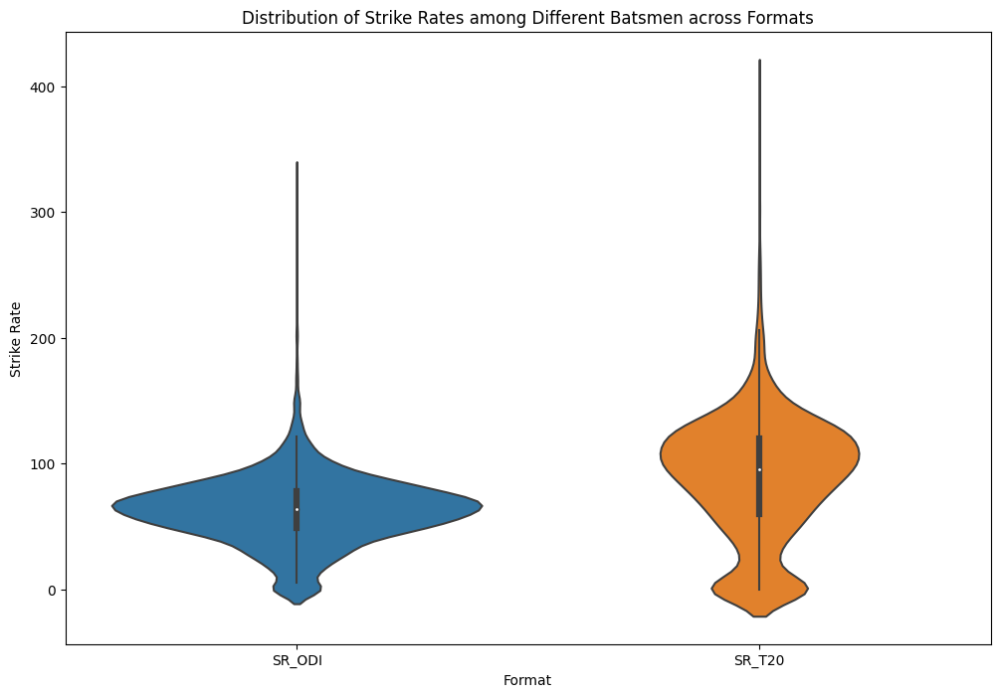

In [23]:
# Merge the subsets from all formats
odi_subset = odi_data[['Player', 'SR']]
t20_subset = t20_data[['Player', 'SR']]

all_subsets = pd.merge(odi_subset, t20_subset, on='Player', how='outer')

# Rename columns for clarity
all_subsets.columns = ['Player', 'SR_ODI', 'SR_T20']

# Melt the DataFrame for seaborn box plot
melted_data = pd.melt(all_subsets, id_vars=['Player'], value_vars=['SR_ODI', 'SR_T20'], var_name='Format', value_name='Strike Rate')

# Box plot
plt.figure(figsize=(12, 8))
sns.violinplot(x='Format', y='Strike Rate', data=melted_data)
plt.title('Distribution of Strike Rates among Different Batsmen across Formats')
plt.show()

0       86.23
1       78.86
2       80.39
3       91.20
4       78.96
        ...  
3527     0.00
3528     0.00
3529     0.00
3530     0.00
3531     0.00
Name: SR_ODI, Length: 3532, dtype: float64


<Figure size 1000x600 with 0 Axes>

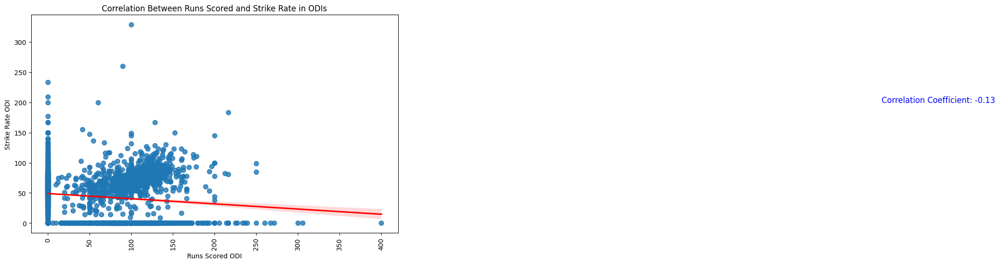

0       86.23
1       78.86
2       80.39
3       91.20
4       78.96
        ...  
3527     0.00
3528     0.00
3529     0.00
3530     0.00
3531     0.00
Name: SR_ODI, Length: 3532, dtype: float64


<Figure size 1000x600 with 0 Axes>

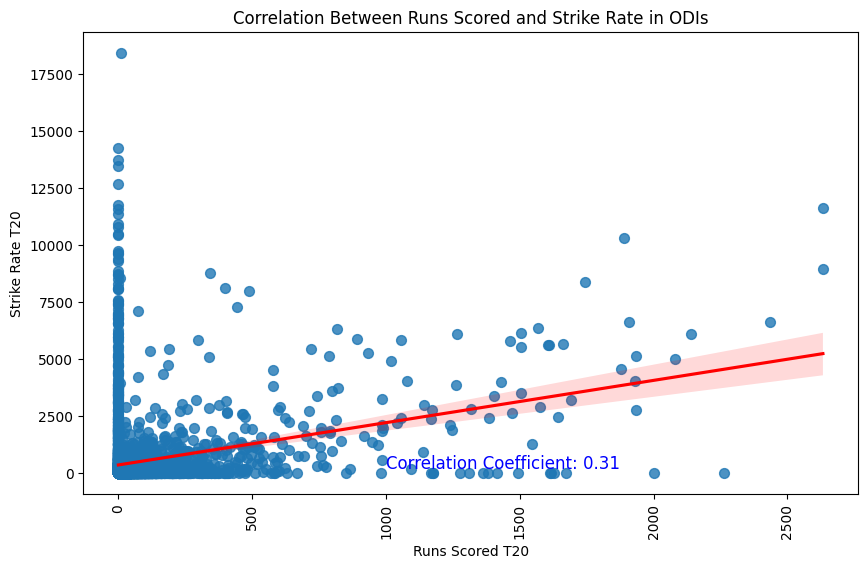

In [24]:
# Is there a correlation between strike rate and runs scored?

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have loaded your data into a DataFrame named 'all_averages'
# Include the relevant columns for analysis (e.g., 'Runs_ODI', 'SR_ODI')
# Adjust the column names based on your actual dataset
# Extract batting averages from each format
odi_averages = odi_data[['Player', 'SR','Runs']]
t20_averages = t20_data[['Player', 'SR','Runs']]

# Merge the averages from all formats
all_averages = pd.merge(odi_averages, t20_averages, on='Player', how='outer')

# Rename columns for clarity
all_averages.columns = ['Player', 'SR_ODI','SR_T20','Runs_ODI','Runs_T20']
all_averages = all_averages.fillna(0)
# Convert columns to numeric (in case they are not already)
numeric_columns = [ 'SR_ODI','SR_T20','Runs_ODI','Runs_T20']

all_averages[numeric_columns] = all_averages[numeric_columns].apply(pd.to_numeric, errors='coerce')

for format in ['ODI', 'T20']:
    plt.figure(figsize=(10, 6))
    print(all_averages['SR_ODI'])
    # Calculate the correlation coefficient
    correlation_coefficient = all_averages[f'Runs_{format}'].corr(all_averages[f'SR_{format}'])
    # Plotting a scatter plot with regression line
    plt.figure(figsize=(10, 6))
    sns.regplot(x=f'Runs_{format}', y=f'SR_{format}', data=all_averages, scatter_kws={'s': 50}, line_kws={'color': 'red'})
    plt.title('Correlation Between Runs Scored and Strike Rate in ODIs')
    plt.xlabel(f'Runs Scored {format}')
    plt.ylabel(f'Strike Rate {format}')
    plt.xticks(rotation=90)
    plt.text(1000, 200, f'Correlation Coefficient: {correlation_coefficient:.2f}', fontsize=12, color='blue')
    plt.show()




In [25]:
# Assuming '100' and '50' columns represent the number of centuries and half-centuries respectively
centuries_frequency_odi = odi_data['100'].apply(lambda x: 1 if x > 0 else 0).sum()
half_centuries_frequency_odi = odi_data['50'].apply(lambda x: 1 if x > 0 else 0).sum()

centuries_frequency_t20 = t20_data['100'].apply(lambda x: 1 if x > 0 else 0).sum()
half_centuries_frequency_t20 = t20_data['50'].apply(lambda x: 1 if x > 0 else 0).sum()

centuries_frequency_test = test_data['100'].apply(lambda x: 1 if x > 0 else 0).sum()
half_centuries_frequency_test = test_data['50'].apply(lambda x: 1 if x > 0 else 0).sum()

# Print the frequencies
print(f'ODI - Frequency of Players Scoring Centuries: {centuries_frequency_odi}')
print(f'ODI - Frequency of Players Scoring Half-Centuries: {half_centuries_frequency_odi}\n')

print(f'T20 - Frequency of Players Scoring Centuries: {centuries_frequency_t20}')
print(f'T20 - Frequency of Players Scoring Half-Centuries: {half_centuries_frequency_t20}\n')

print(f'Test - Frequency of Players Scoring Centuries: {centuries_frequency_test}')
print(f'Test - Frequency of Players Scoring Half-Centuries: {half_centuries_frequency_test}')

ODI - Frequency of Players Scoring Centuries: 394
ODI - Frequency of Players Scoring Half-Centuries: 940

T20 - Frequency of Players Scoring Centuries: 42
T20 - Frequency of Players Scoring Half-Centuries: 361

Test - Frequency of Players Scoring Centuries: 778
Test - Frequency of Players Scoring Half-Centuries: 1362


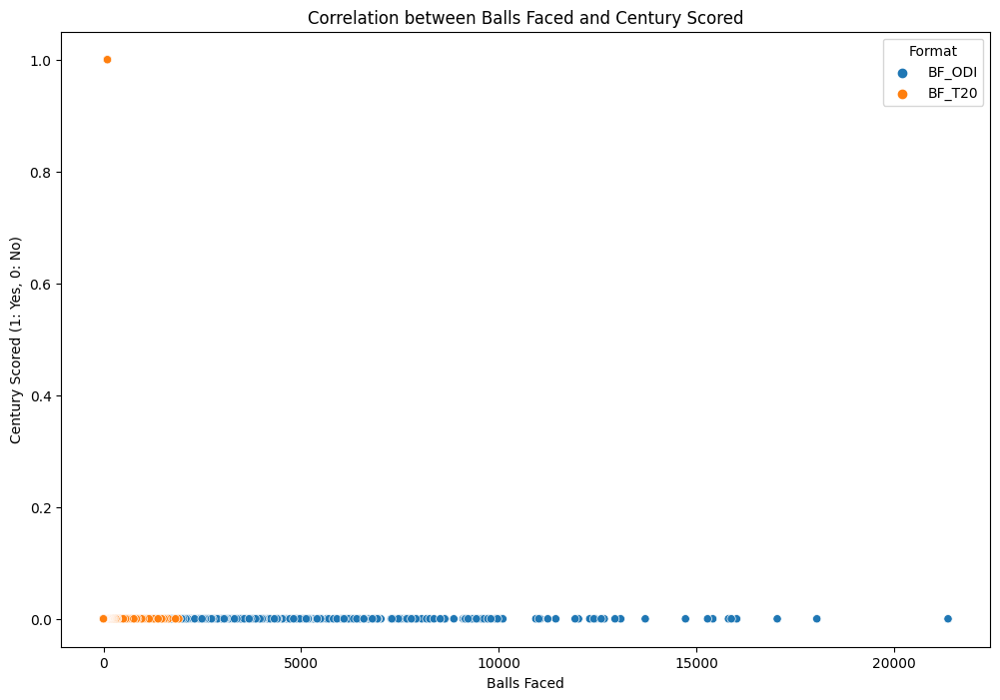


Correlation Matrix:
                Balls Faced  Century Scored
Balls Faced        1.000000       -0.015229
Century Scored    -0.015229        1.000000


In [26]:
# How does the number of balls faced correlate with the likelihood of scoring a century?

# Extract relevant columns
odi_subset = odi_data[['Player', 'Runs', 'BF', '100']]
t20_subset = t20_data[['Player', 'Runs', 'BF', '100']]

# Merge the subsets from all formats
all_subsets = pd.merge(odi_subset, t20_subset, on='Player', how='outer')

# Rename columns for clarity
all_subsets.columns = ['Player', 'Runs_ODI', 'BF_ODI', '100_ODI', 'Runs_T20', 'BF_T20', '100_T20']

# Melt the DataFrame for seaborn scatter plot
melted_data = pd.melt(all_subsets, id_vars=['Player'], value_vars=['BF_ODI', 'BF_T20'], var_name='Format', value_name='Balls Faced')

# Create a new column indicating whether a century was scored
melted_data['Century Scored'] = melted_data['Balls Faced'].apply(lambda x: 1 if x == 100 else 0)

# Scatter plot
plt.figure(figsize=(12, 8))
sns.scatterplot(x='Balls Faced', y='Century Scored', hue='Format', data=melted_data)
plt.title('Correlation between Balls Faced and Century Scored')
plt.xlabel('Balls Faced')
plt.ylabel('Century Scored (1: Yes, 0: No)')
plt.show()

# Correlation matrix
correlation_matrix = melted_data[['Balls Faced', 'Century Scored']].corr()
print("\nCorrelation Matrix:")
print(correlation_matrix)

In [27]:
# What is the probability of a player scoring a century in a match given their batting average?


# Merge the datasets based on common columns (Player and Span)
merged_df = pd.merge(odi_data, t20_data, on=['Player', 'Span'], how='outer', suffixes=('_odi', '_t20'))
merged_df = pd.merge(merged_df, test_data, on=['Player', 'Span'], how='outer', suffixes=('', '_test'))

# Display the merged dataframe
print(merged_df.head())

# Function to calculate probability of a player scoring a century given their batting average
def calculate_individual_player_probability(df, player_name):
    player_data = merged_df[merged_df['Player'] == player_name]

    # Check if the player has data in any format
    if player_data.empty:
        return None

    # Count instances where a player scored a century and average is available
    century_and_average = player_data[(player_data['100'] > 0) & (player_data['Ave'].notna())]

    # Count instances where average is available
    total_with_average = player_data[player_data['Ave'].notna()]

    # Calculate probability
    if len(total_with_average) == 0:
        return None
    else:
        probability = len(century_and_average) / len(total_with_average)
        return probability

# Example: Calculate probability for a specific player (replace 'PlayerName' with the actual player's name)
player_name = 'PlayerName'
player_probability = calculate_individual_player_probability(merged_df, player_name)

if player_probability is not None:
    print(f"Probability of {player_name} scoring a century given their batting average: {player_probability:.4f}")
else:
    print(f"No data available for {player_name} in the merged dataset.")

# Find distinct player names
players = merged_df['Player'].unique()

# Loop over distinct player names and calculate probabilities
for player_name in players:
    player_probability = calculate_individual_player_probability(merged_df, player_name)

    if player_probability is not None:
        print(f"Probability of {player_name} scoring a century given their batting average: {player_probability:.4f}")
    else:
        print(f"No data available for {player_name} in the merged dataset.")

Streaming output truncated to the last 5000 lines.
Probability of A Symonds (AUS) scoring a century given their batting average: 1.0000
No data available for Abdul Razzaq (Asia/PAK) in the merged dataset.
Probability of DA Warner (AUS) scoring a century given their batting average: 1.0000
No data available for CL Cairns (ICC/NZ) in the merged dataset.
Probability of Q de Kock (SA) scoring a century given their batting average: 1.0000
Probability of Aamer Sohail (PAK) scoring a century given their batting average: 1.0000
Probability of CD McMillan (NZ) scoring a century given their batting average: 1.0000
Probability of MD Crowe (NZ) scoring a century given their batting average: 1.0000
No data available for MV Boucher (Afr/SA) in the merged dataset.
Probability of AJ Stewart (ENG) scoring a century given their batting average: 1.0000
Probability of AJ Finch (AUS) scoring a century given their batting average: 0.0000
Probability of SB Styris (NZ) scoring a century given their batting av

In [28]:
# Given a specific batting average threshold, what is the probability of a player having an average below that threshold?

# Merge the datasets based on common columns (Player and Span)
merged_df = pd.merge(odi_data, t20_data, on=['Player', 'Span'], how='outer', suffixes=('_odi', '_t20'))
merged_df = pd.merge(merged_df, test_data, on=['Player', 'Span'], how='outer', suffixes=('', '_test'))

# Find distinct player names
distinct_players = merged_df['Player'].unique()

# Function to calculate probability of a player having an average below a specific threshold
def calculate_individual_player_probability_below_threshold(df, player_name, threshold):
    player_data = df[df['Player'] == player_name]

    # Check if the player has data in any format
    if player_data.empty:
        return None

    # Count instances where average is below the threshold
    below_threshold = player_data[player_data['Ave'].lt(threshold)]

    # Count total instances
    total_instances = len(player_data)

    # Calculate probability
    if total_instances == 0:
        return None
    else:
        probability = len(below_threshold) / total_instances
        return probability

# Set a specific batting average threshold (replace with your desired threshold)
average_threshold = 10

# Loop over distinct player names and calculate probabilities below the threshold
for player_name in distinct_players:
    player_probability_below_threshold = calculate_individual_player_probability_below_threshold(merged_df, player_name, average_threshold)

    if player_probability_below_threshold is not None:
        print(f"Probability of {player_name} having an average below {average_threshold}: {player_probability_below_threshold:.4f}")
    else:
        print(f"No data available for {player_name} in the merged dataset.")

Streaming output truncated to the last 5000 lines.
Probability of A Symonds (AUS) having an average below 10: 0.0000
Probability of Abdul Razzaq (Asia/PAK) having an average below 10: 0.0000
Probability of DA Warner (AUS) having an average below 10: 0.0000
Probability of CL Cairns (ICC/NZ) having an average below 10: 0.0000
Probability of Q de Kock (SA) having an average below 10: 0.0000
Probability of Aamer Sohail (PAK) having an average below 10: 0.0000
Probability of CD McMillan (NZ) having an average below 10: 0.0000
Probability of MD Crowe (NZ) having an average below 10: 0.0000
Probability of MV Boucher (Afr/SA) having an average below 10: 0.0000
Probability of AJ Stewart (ENG) having an average below 10: 0.0000
Probability of AJ Finch (AUS) having an average below 10: 0.0000
Probability of SB Styris (NZ) having an average below 10: 0.0000
Probability of KP Pietersen (ENG/ICC) having an average below 10: 0.0000
Probability of NS Sidhu (INDIA) having an average below 10: 0.0000
Pr

**Perform EDA on Fielding Data Set**

In [39]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Display the first few rows of each dataframe to understand the structure
print("Fielding ODI Data:")
print(fielding_odi_data.head())

print("\nFielding T20 Data:")
print(fielding_t20_data.head())

print("\nFielding Test Data:")
print(fielding_test_data.head())

# Summary statistics for each format
print("\nSummary Statistics for Fielding ODI:")
print(fielding_odi_data.describe())

print("\nSummary Statistics for Fielding T20:")
print(fielding_t20_data.describe())

print("\nSummary Statistics for Fielding Test:")
print(fielding_test_data.describe())



Fielding ODI Data:
   Unnamed: 0                       Player       Span  Mat  Inns  Dis   Ct  \
0           0  KC Sangakkara (Asia/ICC/SL)  2000-2015  404   397  501  402   
1           1       AC Gilchrist (AUS/ICC)  1996-2008  287   286  472  417   
2           2        MS Dhoni (Asia/INDIA)  2004-2019  350   345  444  321   
3           3          MV Boucher (Afr/SA)  1998-2011  295   291  425  403   
4           4              Moin Khan (PAK)  1990-2004  219   217  287  214   

    St  Ct Wk  Ct Fi           MD    D/I  Unnamed: 11  
0   99    383     19  5 (4ct 1st)  1.261          NaN  
1   55    417      0  6 (6ct 0st)  1.650          NaN  
2  123    321      0  6 (5ct 1st)  1.286          NaN  
3   22    402      1  6 (6ct 0st)  1.460          NaN  
4   73    214      0  5 (5ct 0st)  1.322          NaN  

Fielding T20 Data:
   Unnamed: 0                   Player       Span  Mat Inns Dis  Ct  St Ct Wk  \
0           0         MS Dhoni (INDIA)  2006-2019   98   97  91  57  34    

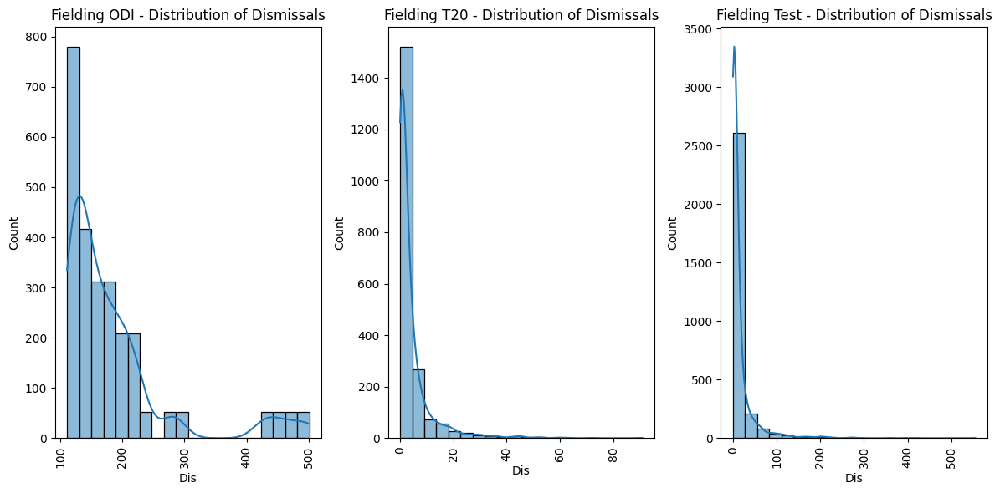

In [62]:
# Visualize the distribution of dismissals (Ct + St) for each format
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
sns.histplot(fielding_odi_data['Dis'], bins=20, kde=True)
plt.title('Fielding ODI - Distribution of Dismissals')
plt.xticks(rotation=90)

plt.subplot(1, 3, 2)
sns.histplot(fielding_t20_data['Dis'], bins=20, kde=True)
plt.title('Fielding T20 - Distribution of Dismissals')
plt.xticks(rotation=90)

plt.subplot(1, 3, 3)
sns.histplot(fielding_test_data['Dis'], bins=20, kde=True)
plt.title('Fielding Test - Distribution of Dismissals')
plt.xticks(rotation=90)

plt.tight_layout()
plt.show()



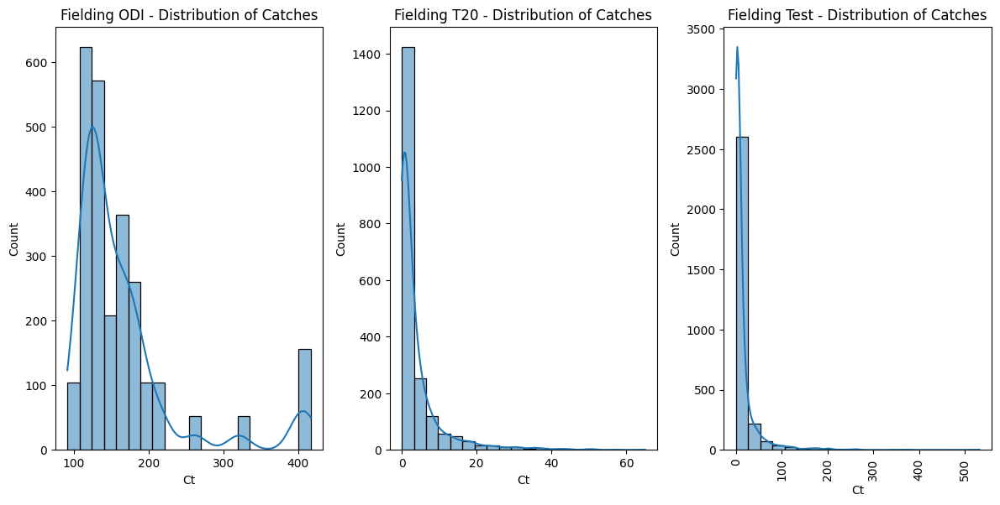

In [61]:
# Visualize the distribution of catches for each format
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
sns.histplot(fielding_odi_data['Ct'], bins=20, kde=True)
plt.title('Fielding ODI - Distribution of Catches')

plt.subplot(1, 3, 2)
sns.histplot(fielding_t20_data['Ct'], bins=20, kde=True)
plt.title('Fielding T20 - Distribution of Catches')

plt.subplot(1, 3, 3)
sns.histplot(fielding_test_data['Ct'], bins=20, kde=True)
plt.title('Fielding Test - Distribution of Catches')

plt.tight_layout()
plt.xticks(rotation=90)
plt.show()



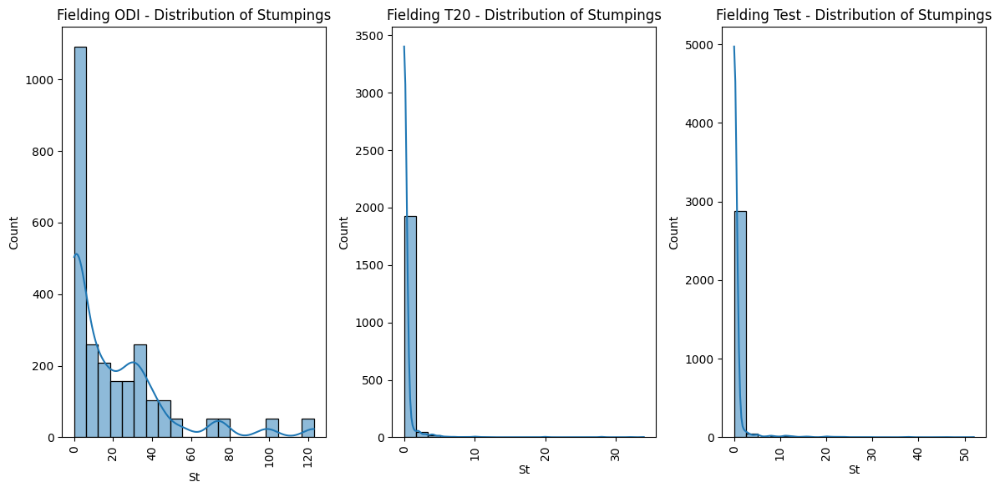

In [63]:
# Visualize the distribution of stumpings for each format
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
sns.histplot(fielding_odi_data['St'], bins=20, kde=True)
plt.title('Fielding ODI - Distribution of Stumpings')
plt.xticks(rotation=90)

plt.subplot(1, 3, 2)
sns.histplot(fielding_t20_data['St'], bins=20, kde=True)
plt.title('Fielding T20 - Distribution of Stumpings')
plt.xticks(rotation=90)

plt.subplot(1, 3, 3)
sns.histplot(fielding_test_data['St'], bins=20, kde=True)
plt.title('Fielding Test - Distribution of Stumpings')
plt.xticks(rotation=90)

plt.tight_layout()
plt.show()

In [43]:
# Visualize missing values
features_with_na_odi=[features for features in fielding_odi_data.columns if fielding_odi_data[features].isnull().sum()>1]

for feature in features_with_na_odi:
    print(feature, np.round(fielding_odi_data[feature].isnull().mean(), 2),  ' % missing values')

features_with_na_t20=[features for features in fielding_t20_data.columns if fielding_t20_data[features].isnull().sum()>1]

for feature in features_with_na_odi:
    print(feature, np.round(fielding_t20_data[feature].isnull().mean(), 2),  ' % missing values')

features_with_na_test=[features for features in fielding_test_data.columns if fielding_test_data[features].isnull().sum()>1]

for feature in features_with_na_odi:
    print(feature, np.round(fielding_test_data[feature].isnull().mean(), 2),  ' % missing values')



Unnamed: 11 1.0  % missing values
Unnamed: 11 1.0  % missing values
Unnamed: 11 1.0  % missing values


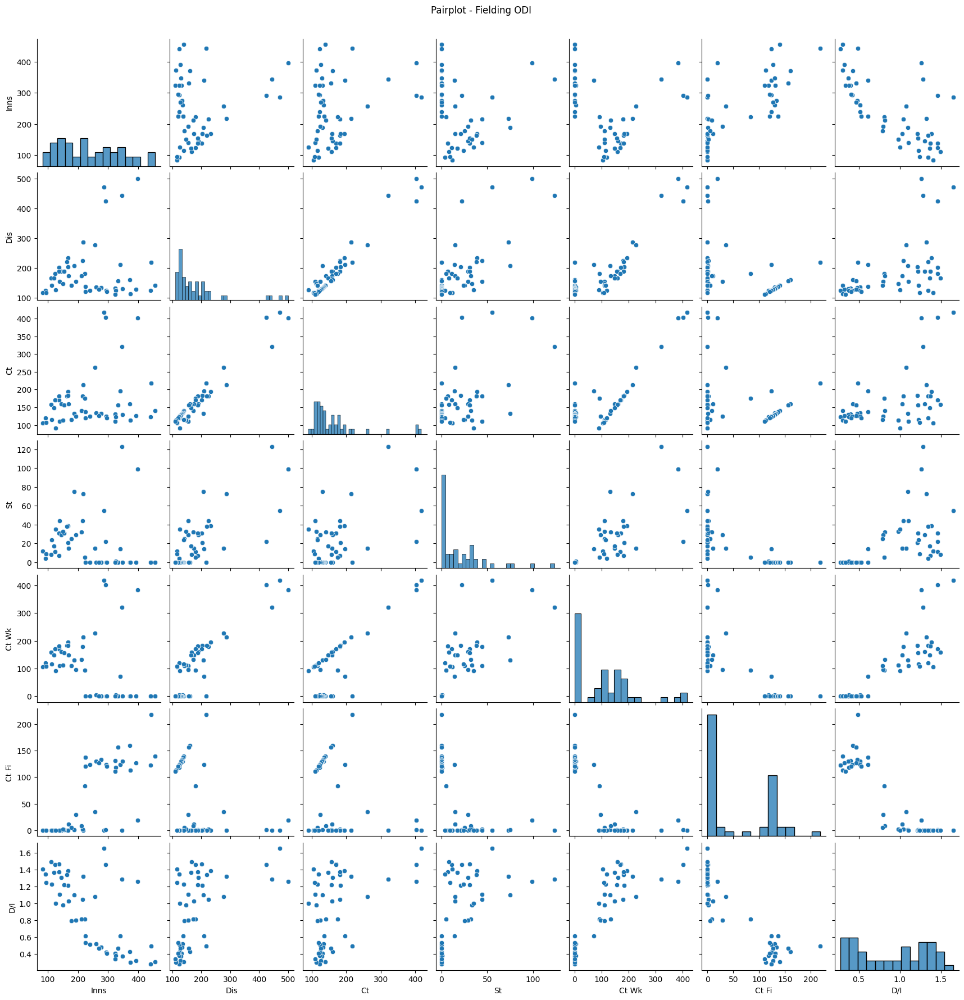

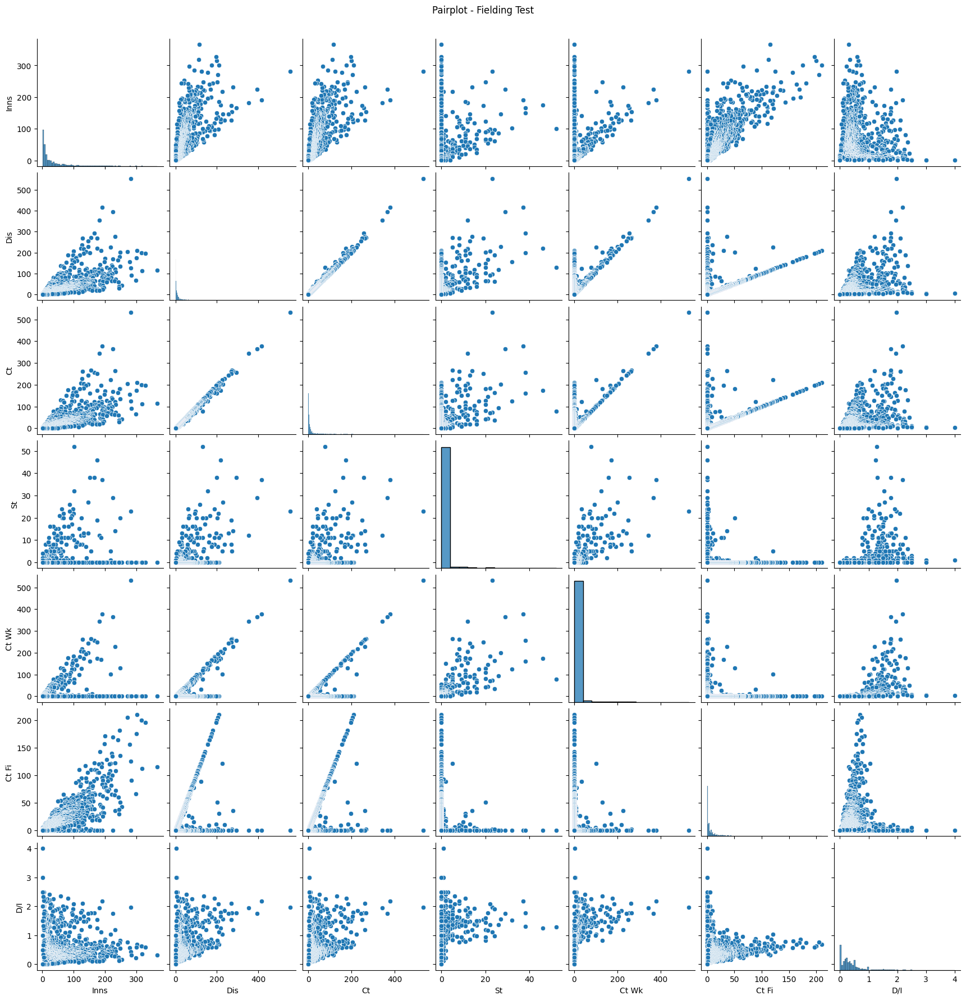

In [47]:
# Explore relationships among numerical variables using seaborn pairplot
numerical_cols_odi = ['Inns', 'Dis', 'Ct', 'St', 'Ct Wk', 'Ct Fi', 'MD', 'D/I']
numerical_cols_test = ['Inns', 'Dis', 'Ct', 'St', 'Ct Wk', 'Ct Fi', 'MD', 'D/I']

# Fielding ODI
sns.pairplot(fielding_odi_data[numerical_cols_odi])
plt.suptitle('Pairplot - Fielding ODI', y=1.02)


# Fielding Test
sns.pairplot(fielding_test_data[numerical_cols_test])
plt.suptitle('Pairplot - Fielding Test', y=1.02)
plt.show()

In [48]:
# Drop unwanted column as it has no data
fielding_odi_data = fielding_odi_data.drop('Unnamed: 11', axis=1)
fielding_t20_data = fielding_t20_data.drop('Unnamed: 11', axis=1)
fielding_test_data = fielding_test_data.drop('Unnamed: 11', axis=1)

In [49]:
# Data Cleaning

# Clean numeric data
# ODI Data
fielding_odi_data = pd.read_csv('Fielding_ODI.csv')
fielding_t20_data = pd.read_csv('Fielding_t20.csv')
fielding_test_data = pd.read_csv('Fielding_test.csv')

numeric_columns = ['Mat', 'Inns', 'Dis', 'Ct', 'St', 'Ct Wk', 'Ct Fi', 'D/I']

fielding_odi_data[numeric_columns] = fielding_odi_data[numeric_columns].replace('-', 0) # replace - with 0 in data
fielding_odi_data[numeric_columns] = fielding_odi_data[numeric_columns].replace('*', '') # remove * from data
fielding_odi_data[numeric_columns] = fielding_odi_data[numeric_columns].apply(pd.to_numeric, errors='coerce') # convert it to numeric form

# Test Data

fielding_test_data[numeric_columns] = fielding_test_data[numeric_columns].replace('-', 0) # replace - with 0 in data
fielding_test_data[numeric_columns] = fielding_test_data[numeric_columns].replace('*', '') # remove * from data
fielding_test_data[numeric_columns] = fielding_test_data[numeric_columns].apply(pd.to_numeric, errors='coerce') # convert it to numeric form

# T20 Data

fielding_t20_data[numeric_columns] = fielding_t20_data[numeric_columns].replace('-', 0) # replace - with 0 in data
fielding_t20_data[numeric_columns] = fielding_t20_data[numeric_columns].replace('', '') # remove * from data
fielding_t20_data[numeric_columns] = fielding_t20_data[numeric_columns].apply(pd.to_numeric, errors='coerce') # convert it to numeric form

Solve Questions Related to Fielding Data

<ipython-input-66-61601dd0cda9>:5: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Dis', y='Player', data=fielding_odi_data, ci=None)
<ipython-input-66-61601dd0cda9>:11: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Dis', y='Player', data=fielding_t20_data, ci=None)
<ipython-input-66-61601dd0cda9>:17: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Dis', y='Player', data=fielding_test_data, ci=None)


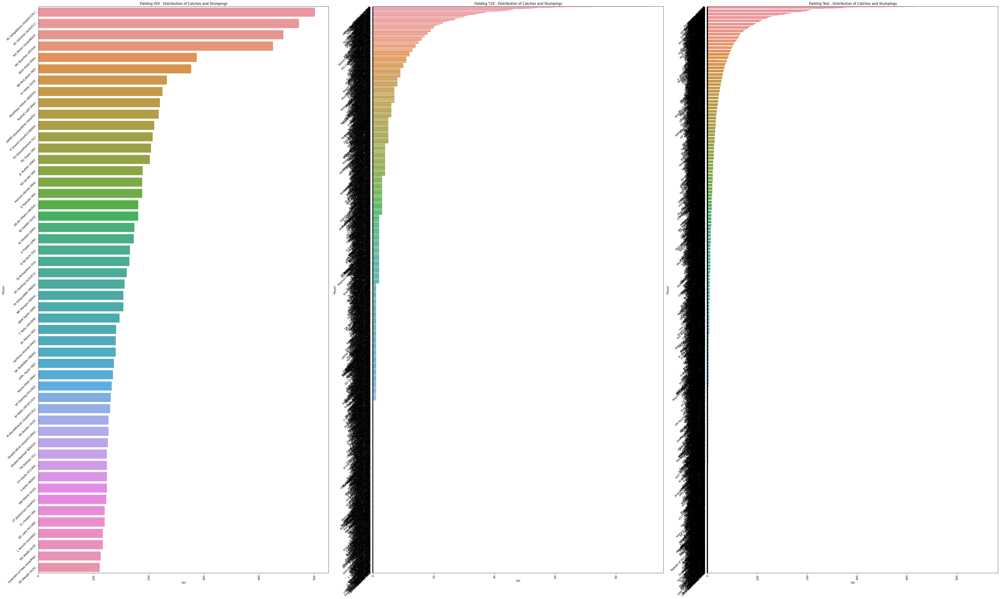

In [66]:
# What is the distribution of catches and stumpings for different players?
plt.figure(figsize=(100, 30))

plt.subplot(1, 6, 1)
sns.barplot(x='Dis', y='Player', data=fielding_odi_data, ci=None)
plt.title('Fielding ODI - Distribution of Catches and Stumpings')
plt.xticks(rotation=90)
plt.yticks(rotation=45)

plt.subplot(1, 6, 2)
sns.barplot(x='Dis', y='Player', data=fielding_t20_data, ci=None)
plt.title('Fielding T20 - Distribution of Catches and Stumpings')
plt.xticks(rotation=90)
plt.yticks(rotation=45)

plt.subplot(1, 6, 3)
sns.barplot(x='Dis', y='Player', data=fielding_test_data, ci=None)
plt.title('Fielding Test - Distribution of Catches and Stumpings')
plt.xticks(rotation=90)
plt.yticks(rotation=45)

plt.tight_layout()
plt.show()


In [59]:
# Is there a player with a particularly high number of catches or stumpings?

top_catchers_odi = fielding_odi_data.nlargest(1, 'Ct')
top_stumpers_odi = fielding_odi_data.nlargest(1, 'St')

top_catchers_t20 = fielding_t20_data.nlargest(1, 'Ct')
top_stumpers_t20 = fielding_t20_data.nlargest(1, 'St')

top_catchers_test = fielding_test_data.nlargest(1, 'Ct')
top_stumpers_test = fielding_test_data.nlargest(1, 'St')

print("\nTop Catcher in ODI:")
print(top_catchers_odi[['Player', 'Ct']])

print("\nTop Stumper in ODI:")
print(top_stumpers_odi[['Player', 'St']])

print("\nTop Catcher in T20:")
print(top_catchers_t20[['Player', 'Ct']])

print("\nTop Stumper in T20:")
print(top_stumpers_t20[['Player', 'St']])

print("\nTop Catcher in Test:")
print(top_catchers_test[['Player', 'Ct']])

print("\nTop Stumper in Test:")
print(top_stumpers_test[['Player', 'St']])


Top Catcher in ODI:
                   Player   Ct
1  AC Gilchrist (AUS/ICC)  417

Top Stumper in ODI:
                  Player   St
2  MS Dhoni (Asia/INDIA)  123

Top Catcher in T20:
                Player  Ct
1  AB de Villiers (SA)  65

Top Stumper in T20:
             Player  St
0  MS Dhoni (INDIA)  34

Top Catcher in Test:
                Player   Ct
0  MV Boucher (ICC/SA)  532

Top Stumper in Test:
                Player  St
52  WAS Oldfield (AUS)  52


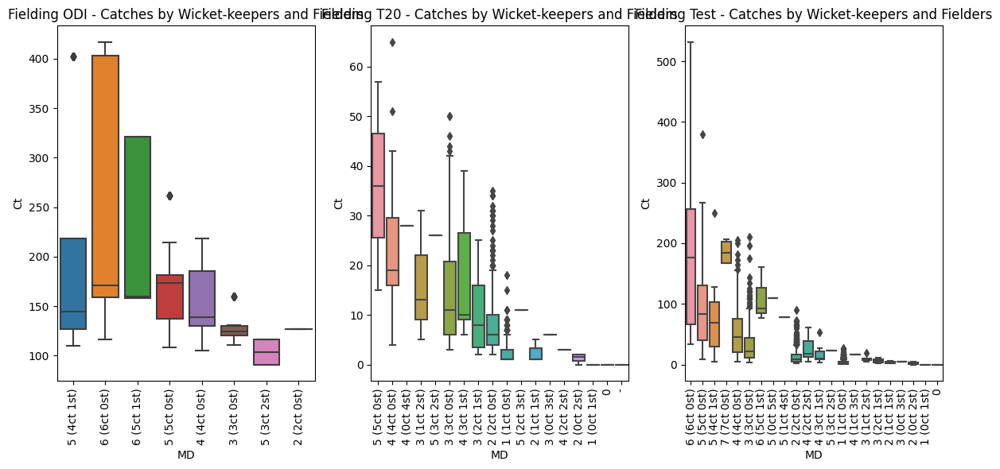

In [67]:
# How many catches do wicket-keepers and fielders typically take?
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
sns.boxplot(x='MD', y='Ct', data=fielding_odi_data)
plt.title('Fielding ODI - Catches by Wicket-keepers and Fielders')
plt.xticks(rotation=90)

plt.subplot(1, 3, 2)
sns.boxplot(x='MD', y='Ct', data=fielding_t20_data)
plt.title('Fielding T20 - Catches by Wicket-keepers and Fielders')
plt.xticks(rotation=90)

plt.subplot(1, 3, 3)
sns.boxplot(x='MD', y='Ct', data=fielding_test_data)
plt.title('Fielding Test - Catches by Wicket-keepers and Fielders')
plt.xticks(rotation=90)

plt.tight_layout()
plt.show()


<ipython-input-68-9c7a42abfb5a>:5: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='MD', y='Ct', data=fielding_odi_data, ci=None)
<ipython-input-68-9c7a42abfb5a>:11: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='MD', y='Ct', data=fielding_t20_data, ci=None)
<ipython-input-68-9c7a42abfb5a>:16: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='MD', y='Ct', data=fielding_test_data, ci=None)


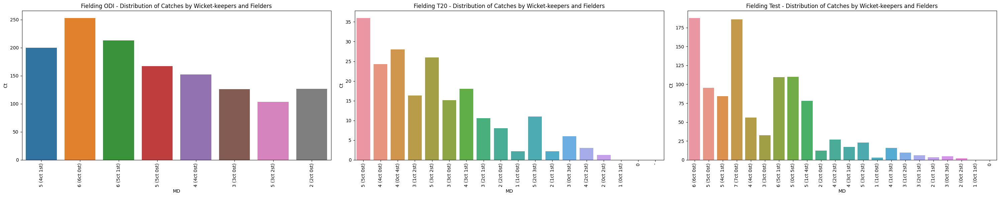

In [68]:

# What is the distribution of catches taken by wicket-keepers and fielders?
plt.figure(figsize=(30, 6))

plt.subplot(1, 3, 1)
sns.barplot(x='MD', y='Ct', data=fielding_odi_data, ci=None)
plt.title('Fielding ODI - Distribution of Catches by Wicket-keepers and Fielders')
plt.xticks(rotation=90)


plt.subplot(1, 3, 2)
sns.barplot(x='MD', y='Ct', data=fielding_t20_data, ci=None)
plt.title('Fielding T20 - Distribution of Catches by Wicket-keepers and Fielders')
plt.xticks(rotation=90)

plt.subplot(1, 3, 3)
sns.barplot(x='MD', y='Ct', data=fielding_test_data, ci=None)
plt.title('Fielding Test - Distribution of Catches by Wicket-keepers and Fielders')
plt.xticks(rotation=90)

plt.tight_layout()
plt.show()

In [21]:
# What is the average number of dismissals (Ct + St) per inning for players?
merged_df = pd.merge(fielding_odi_data, fielding_t20_data, on=['Player', 'Span'], how='outer', suffixes=('_odi', '_t20'))
merged_df = pd.merge(merged_df, fielding_test_data, on=['Player', 'Span'], how='outer', suffixes=('', '_test'))

# Calculate average dismissals per inning for each player
merged_df['Avg_Dismissals'] = (merged_df['Ct'] + merged_df['St']) / merged_df['Inns']

# Display the average dismissals
print("Average Dismissals per Inning for Players:")
print(merged_df[['Player', 'Avg_Dismissals']].sort_values(by='Avg_Dismissals', ascending=False))

Average Dismissals per Inning for Players:
                    Player  Avg_Dismissals
6051        H Klaasen (SA)             4.0
6232        GA Manou (AUS)             3.0
5777        PA Emery (AUS)             3.0
5926       NV Ojha (INDIA)             2.5
5894   Ikram Alikhil (AFG)             2.5
...                    ...             ...
4599    Ziaur Rehman (Fin)             NaN
4600  Zohaib Sarwar (PORT)             NaN
4601        M Zondeki (SA)             NaN
4602          GMC Mol (NL)             NaN
4603    JD Schoonheim (NL)             NaN

[7552 rows x 2 columns]


In [22]:
# How does a player's dismissal rate change over time?
# Calculate dismissal rate for each player over time
merged_df['Dismissal_Rate'] = (merged_df['Ct'] + merged_df['St']) / merged_df['Inns']

# Display the dismissal rate over time
print("Dismissal Rate Over Time for Players:")
print(merged_df[['Player', 'Span', 'Dismissal_Rate']].sort_values(by='Dismissal_Rate', ascending=False))

Dismissal Rate Over Time for Players:
                    Player       Span  Dismissal_Rate
6051        H Klaasen (SA)  2019-2019             4.0
6232        GA Manou (AUS)  2009-2009             3.0
5777        PA Emery (AUS)  1994-1994             3.0
5926       NV Ojha (INDIA)  2015-2015             2.5
5894   Ikram Alikhil (AFG)  2019-2019             2.5
...                    ...        ...             ...
4599    Ziaur Rehman (Fin)  2019-2019             NaN
4600  Zohaib Sarwar (PORT)  2019-2019             NaN
4601        M Zondeki (SA)  2006-2006             NaN
4602          GMC Mol (NL)  2008-2008             NaN
4603    JD Schoonheim (NL)  2008-2008             NaN

[7552 rows x 3 columns]


In [24]:
# What is the probability of a wicket-keeper taking a specific number of catches in a match?
def calculate_probability_specific_catches(df, specific_catches):
    specific_catches_data = df[df['Ct'] == specific_catches]
    total_instances = len(df)
    probability = len(specific_catches_data) / total_instances
    return probability

# Set a specific number of catches (replace with your desired number)
specific_catches = 3

# Calculate the probability for each format
odi_probability_specific_catches = calculate_probability_specific_catches(fielding_odi_data, specific_catches)
t20_probability_specific_catches = calculate_probability_specific_catches(fielding_t20_data, specific_catches)
test_probability_specific_catches = calculate_probability_specific_catches(fielding_test_data, specific_catches)

print(f"Probability of a wicket-keeper taking {specific_catches} catches in an ODI match: {odi_probability_specific_catches:.4f}")
print(f"Probability of a wicket-keeper taking {specific_catches} catches in a T20 match: {t20_probability_specific_catches:.4f}")
print(f"Probability of a wicket-keeper taking {specific_catches} catches in a Test match: {test_probability_specific_catches:.4f}")

Probability of a wicket-keeper taking 3 catches in an ODI match: 0.0000
Probability of a wicket-keeper taking 3 catches in a T20 match: 0.0683
Probability of a wicket-keeper taking 3 catches in a Test match: 0.0593


In [25]:
# What is the probability of a player achieving a dismissal rate above or below a certain threshold?
# Define a function to calculate the probability of a player achieving a dismissal rate above or below a certain threshold
def calculate_probability_dismissal_rate(df, threshold, condition):
    filtered_data = df.query(condition)
    total_instances = len(df)
    probability = len(filtered_data) / total_instances
    return probability

# Set a specific dismissal rate threshold (replace with your desired threshold)
dismissal_rate_threshold = 0.05

# Calculate the probability above and below the threshold for each format
odi_probability_above_threshold = calculate_probability_dismissal_rate(merged_df, dismissal_rate_threshold, 'Dismissal_Rate > @dismissal_rate_threshold')
odi_probability_below_threshold = calculate_probability_dismissal_rate(merged_df, dismissal_rate_threshold, 'Dismissal_Rate <= @dismissal_rate_threshold')

print(f"Probability of a player achieving a dismissal rate above {dismissal_rate_threshold} in any format: {odi_probability_above_threshold:.4f}")
print(f"Probability of a player achieving a dismissal rate below or equal to {dismissal_rate_threshold} in any format: {odi_probability_below_threshold:.4f}")

Probability of a player achieving a dismissal rate above 0.05 in any format: 0.3453
Probability of a player achieving a dismissal rate below or equal to 0.05 in any format: 0.0791
